# CycleGAN

* Unpaired examples -> unsupervised learning.

## Acknowledgments

- **Paper**: https://arxiv.org/pdf/1703.10593.pdf
- **CycleGAN TensorFlow code**: https://github.com/xhujoy/CycleGAN-tensorflow/blob/master/module.py
- **Data**: https://people.eecs.berkeley.edu/~taesung_park/CycleGAN/datasets/horse2zebra.zip
- **Helper**: Udacity
- **Some pictures and inspiration**: https://hardikbansal.github.io/CycleGANBlog/

## Architecture

<img src='../media/CycleGAN_1.png'>

## Data

In [1]:
import tensorflow as tf
import numpy as np
from __future__ import division

Horse2Zebra

In [2]:
import sys
data_dir = './../data'
sys.path.insert(0, data_dir)

In [3]:
import helper
import os
from glob import glob

show_n_images = 9
img_w, img_h, img_channels = 256, 256, 3

horse_images = helper.get_batch(glob(os.path.join(data_dir, 'horse2zebra/trainA/*.jpg'))[:show_n_images],
                                img_w, img_h, 'RGB')

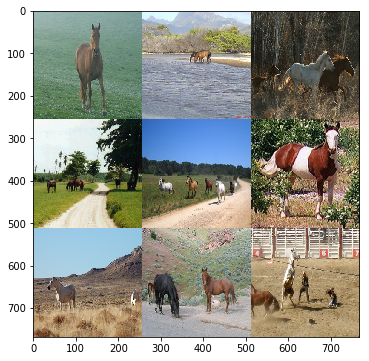

In [4]:
%matplotlib inline
import matplotlib.pyplot as plt

plt.figure(figsize=(6, 6))
plt.imshow(helper.images_square_grid(horse_images, 'RGB'));

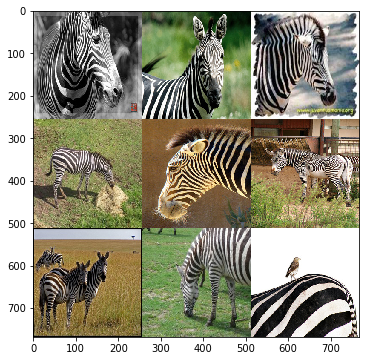

In [5]:
zebra_images = helper.get_batch(glob(os.path.join(data_dir, 'horse2zebra/trainB/*.jpg'))[:show_n_images],
                                img_w, img_h, 'RGB')

plt.figure(figsize=(6, 6))
plt.imshow(helper.images_square_grid(zebra_images, 'RGB'));

## Inputs

$$x \sim p_{xdata}$$
$$y \sim p_{ydata}$$

In [6]:
def model_inputs(img_w, img_h, img_channels):

    real_x = tf.placeholder(tf.float32, (None, img_w, img_h, img_channels), name='real_x')
    real_y = tf.placeholder(tf.float32, (None, img_w, img_h, img_channels), name='real_y')

    return real_x, real_y

## Generator

<img src='../media/CycleGAN_4.jpg'>

<img src='../media/CycleGAN_2.png'>

### Residual Block

<img src='../media/CycleGAN_0.png'>

Last ReLU is skipped

<img src='../media/CycleGAN_3.png'>

In [7]:
def residual_block(x, n_filters, kernel_size=3, strides=1, name='0'):
    
    with tf.variable_scope('Residual_'+name):
    
        # Reflect padding can only be added manually
        pads = int((kernel_size - 1) / 2)

        with tf.variable_scope('Conv_1'):
            x_padded = tf.pad(x, [[0, 0], [pads, pads], [pads, pads], [0, 0]], "REFLECT", name='RefPadding')
            conv1 = tf.layers.conv2d(x_padded, n_filters, kernel_size, strides, padding='valid', name="Conv2D")
            conv1 = tf.contrib.layers.instance_norm(conv1, scope='out')

        conv1 = tf.nn.relu(conv1, name='ReLU')

        with tf.variable_scope('Conv_2'):
            conv1_padded = tf.pad(conv1, [[0, 0], [pads, pads], [pads, pads], [0, 0]], "REFLECT", name='RefPadding')
            conv2 = tf.layers.conv2d(conv1_padded, n_filters, kernel_size, strides, padding='valid', name="Conv2D")
            conv2 = tf.contrib.layers.instance_norm(conv2, scope='out')

        out = tf.add(conv2, x, name='out')
        
        # Not another ReLU

        return out

### Reflect padding

```
# Reflect padding can only be added manually
tf.pad(image, [
            [0, 0],
            [3, 3], # 3-3 padding in height
            [3, 3], # 3-3 padding in width 
            [0, 0]
        ], "REFLECT")
# Now add a conv layer with valid padding
```

### Instance normalization

In [8]:
#  Similar to Johnson et al, we use instance normalization 

Batch normalization normalizes through the entire batch.

Instance normalization normalizes every single image without considering the rest of the batch.

In this case both results would be the same, since we are selecting a `batch_size` of 1.

### Model

In [9]:
def generator(image, dim, reuse=False, name='G'):

    with tf.variable_scope("Generator_"+name, reuse=reuse):
        # image is 256 x 256 x input_c_dim

        # ?x256x256x3 -> ?x256x256x3
        with tf.variable_scope('Conv_0'):
            image_padded = tf.pad(image, [[0, 0], [3, 3], [3, 3], [0, 0]], "REFLECT", name='RefPadding')
            conv0 = tf.layers.conv2d(image_padded, dim, 7, 1, padding='valid', name="Conv2D")
            conv0 = tf.contrib.layers.instance_norm(conv0, scope='InstanceNorm')
            conv0 = tf.nn.relu(conv0, name='out')

        # This network contains two stride-2 convolutions:
        # ?x256x256x3 -> ?x128x128x6
        with tf.variable_scope('Conv_1'):
            conv1 = tf.layers.conv2d(conv0, 2*dim, 3, 2, padding='same', name="Conv2D")
            conv1 = tf.contrib.layers.instance_norm(conv1, scope='InstanceNorm')
            conv1 = tf.nn.relu(conv1, name='out')
        
        # ?x128x128x6 -> ?x64x64x12
        with tf.variable_scope('Conv_2'):
            conv2 = tf.layers.conv2d(conv1, 4*dim, 3, 2, padding='same', name="Conv2D")
            conv2 = tf.contrib.layers.instance_norm(conv2, scope='InstanceNorm')
            conv2 = tf.nn.relu(conv2, name='out')

        # We use 9 residual blocks for 256x256 training images.
        # ?x64x64x12 -> ?x64x64x12
        with tf.variable_scope('ResidualBlocks'):
            res1 = residual_block(conv2, 4*dim, name='1')
            res2 = residual_block(res1, 4*dim, name='2')
            res3 = residual_block(res2, 4*dim, name='3')
            res4 = residual_block(res3, 4*dim, name='4')
            res5 = residual_block(res4, 4*dim, name='5')
            res6 = residual_block(res5, 4*dim, name='6')
            res7 = residual_block(res6, 4*dim, name='7')
            res8 = residual_block(res7, 4*dim, name='8')
            res9 = residual_block(res8, 4*dim, name='9')

        # This network contains 2 fractionally-strided convolutions with stride 1/2.
        # ?x64x64x12 -> ?x128x128x6
        with tf.variable_scope('Deconv_1'):
            deconv1 = tf.layers.conv2d_transpose(res9, 2*dim, 3, strides=2, padding='same', name="Conv2D")
            deconv1 = tf.contrib.layers.instance_norm(deconv1, scope='InstanceNorm')
            deconv1 = tf.nn.relu(deconv1, name='out')

        # ?x128x128x12 -> ?x256x256x3
        with tf.variable_scope('Deconv_2'):
            deconv2 = tf.layers.conv2d_transpose(deconv1, dim, 3, strides=2, padding='same', name="Conv2D")
            deconv2 = tf.contrib.layers.instance_norm(deconv2, scope='InstanceNorm')
            deconv2 = tf.nn.relu(deconv2, name='out')

        # ?x256x256x3 -> ?x256x256x3
        with tf.variable_scope('Conv_3'):
            deconv2_padded = tf.pad(deconv2, [[0, 0], [3, 3], [3, 3], [0, 0]], "REFLECT", name='RefPadding')
            conv3 = tf.layers.conv2d(deconv2_padded, dim, 7, 1, padding='valid', name="out")

        out = tf.nn.tanh(conv3, name='out')

        return out

## Discriminator

<img src='../media/CycleGAN_5.jpg'>

### PatchGAN

The discriminator, instead of returning a single value between 0 and 1, it returns a NxN matrix

### Model

In [10]:
def discriminator(image, dim, alpha=0.2, reuse=False, name='X'):

    with tf.variable_scope("Discriminator_"+name, reuse=reuse):
        # image is 256 x 256 x input_c_dim

        # ?x128x128xdim
        with tf.variable_scope('Conv_1'):
            conv1 = tf.layers.conv2d(image, dim, 4, 2, padding='same', name="Conv2D")
            conv1 = tf.nn.leaky_relu(conv1, alpha, name='out')
        
        # ?x64x64xdim
        with tf.variable_scope('Conv_2'):
            conv2 = tf.layers.conv2d(conv1, 2*dim, 4, 2, padding='same', name="Conv2D")
            conv2 = tf.contrib.layers.instance_norm(conv2, scope='InstanceNorm')
            conv2 = tf.nn.leaky_relu(conv2, alpha, name='out')
        
        # ?x32x32xdim
        with tf.variable_scope('Conv_3'):
            conv3 = tf.layers.conv2d(conv2, 4*dim, 4, 2, padding='same', name="Conv2D")
            conv3 = tf.contrib.layers.instance_norm(conv3, scope='InstanceNorm')
            conv3 = tf.nn.leaky_relu(conv3, alpha, name='out')
        
        # ?x32x32xdim
        with tf.variable_scope('Conv_4'):
            conv4 = tf.layers.conv2d(conv3, 8*dim, 4, 1, padding='same', name="Conv2D")
            conv4 = tf.contrib.layers.instance_norm(conv4, scope='InstanceNorm')
            conv4 = tf.nn.leaky_relu(conv4, alpha, name='out')
        
        # ?x32x32x1
        conv5 = tf.layers.conv2d(conv4, 1, 4, 1, padding='same', name="Conv_5")
        
        return conv5

## Loss

In [11]:
def model_loss(real_x, real_y, out_channels, L1_lambda=10.0, smooth=0.05):

    # 4 generators -> they really are 2 sharing variables
    fake_y = generator(real_x, out_channels, False, name="G")
    recreated_x = generator(fake_y, out_channels, False, name="F")

    fake_x = generator(real_y, out_channels, True, name="F") # Reusing
    recreated_y = generator(fake_x, out_channels, True, name="G") # Reusing

    # 4 discriminators > they really are 2 sharing variables
    d_y_fake = discriminator(fake_y, out_channels, reuse=False, name="Y")
    d_x_fake = discriminator(fake_x, out_channels, reuse=False, name="X")
    d_x_real = discriminator(real_x, out_channels, reuse=True, name="X")
    d_y_real = discriminator(real_y, out_channels, reuse=True, name="Y")

    with tf.name_scope("Losses"):
        with tf.name_scope("Generator"):
            with tf.name_scope("Recreating"):
                # Recreate Loss: MAE
                recreate_x_loss = tf.reduce_mean(tf.abs(real_x - recreated_x))
                recreate_y_loss = tf.reduce_mean(tf.abs(real_y - recreated_y))
                recreate_loss = L1_lambda * (recreate_x_loss + recreate_y_loss)

            with tf.name_scope("Generating"):
                # Generate Loss: MSE + Recreate Loss
                g_loss_x2y = tf.reduce_mean((d_y_fake - tf.ones_like(d_y_fake))**2) + recreate_loss
                g_loss_y2x = tf.reduce_mean((d_x_fake - tf.ones_like(d_x_fake))**2) + recreate_loss

            g_loss = g_loss_x2y + g_loss_y2x - recreate_loss

        with tf.name_scope("Discriminator"):
            with tf.name_scope("X"):
                d_x_loss_real = tf.reduce_mean((d_x_real - tf.ones_like(d_x_real))**2)
                d_x_loss_fake = tf.reduce_mean((d_x_fake - tf.zeros_like(d_x_fake))**2)
                d_x_loss = (d_x_loss_real + d_x_loss_fake) / 2

            with tf.name_scope("Y"):
                d_y_loss_real = tf.reduce_mean((d_y_real - tf.ones_like(d_y_real))**2)
                d_y_loss_fake = tf.reduce_mean((d_y_fake - tf.zeros_like(d_y_fake))**2)
                d_y_loss = (d_y_loss_real + d_y_loss_fake) / 2

            d_loss = d_x_loss + d_y_loss

    # Summaries
    tf.summary.scalar("g_loss_x2y", g_loss_x2y)
    tf.summary.scalar("g_loss_y2x", g_loss_y2x)
    tf.summary.scalar("g_loss", g_loss)
    tf.summary.scalar("d_x_loss", d_x_loss)
    tf.summary.scalar("d_y_loss", d_y_loss)
    tf.summary.scalar("d_loss", d_loss)
    
    tf.summary.image('fake_x_images', fake_x, 1)
    tf.summary.image('fake_y_images', fake_y, 1)
    
    return g_loss, d_loss

## Optimizer

In [12]:
def model_opt(g_loss, d_loss, learning_rate, beta1):
    
    t_vars = tf.trainable_variables()
    g_vars = [var for var in t_vars if 'Generator' in var.name]
    d_vars = [var for var in t_vars if 'Discriminator' in var.name]

    for var in t_vars:
        tf.summary.histogram(var.name[:-2], var) # [:-2] to remove ':0' from tensor name
            
    with tf.name_scope("Optimizers"):
        with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
            g_opt = tf.train.AdamOptimizer(learning_rate,
                                             beta1=beta1, name='G_Adam').minimize(g_loss, var_list=g_vars)
            d_opt = tf.train.AdamOptimizer(learning_rate,
                                             beta1=beta1, name='D_Adam').minimize(d_loss, var_list=d_vars)
            
    return g_opt, d_opt

In [13]:
def show_generator_output(sess, batch, real_x, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    samples = sess.run(
        generator(real_x, out_channel_dim, True, name='G'),
        feed_dict={real_x: batch})

    images_grid = helper.images_square_grid(samples, image_mode)
    plt.imshow(images_grid, cmap=cmap)
    plt.show()

In [14]:
def train(epoch_count, batch_size, learning_rate, beta1, get_batches_X, get_batches_Y, data_shape, data_image_mode):
    
    real_x, real_y = model_inputs(data_shape[1], data_shape[2], data_shape[3]) # placeholders
    g_loss, d_loss = model_loss(real_x, real_y, data_shape[3]) # loss
    g_opt, d_opt = model_opt(g_loss, d_loss, learning_rate, beta1) # optimizers
    
    save_dir = '/tmp/cyclegan/cyclegan_horses.ckpt'
    saver = tf.train.Saver()
    
    log_dir = '/tmp/cyclegan/tb/cyclegan_horses'
    merged_summary = tf.summary.merge_all()
    writer = tf.summary.FileWriter(log_dir)
    
    steps = 0
    
    with tf.Session() as sess:
        
        writer.add_graph(sess.graph)
        
        sess.run(tf.global_variables_initializer())
        
        for epoch_i in range(epoch_count):
            for batch_images_x, batch_images_y in zip(get_batches_X(batch_size), get_batches_Y(batch_size)):
                
                steps += 1
                
                # Run optimizers
                _ = sess.run(g_opt, feed_dict={
                        real_x: batch_images_x,
                        real_y: batch_images_y
                    })
                _ = sess.run(d_opt, feed_dict={
                        real_x: batch_images_x,
                        real_y: batch_images_y
                    })
                
                if steps % 20 == 0:
                    summary = sess.run(merged_summary, feed_dict={
                        real_x: batch_images_x,
                        real_y: batch_images_y
                    })
                    writer.add_summary(summary, steps)
                    
                    train_loss_g = sess.run(g_loss, feed_dict={
                        real_x: batch_images_x,
                        real_y: batch_images_y
                        })
                    train_loss_d = sess.run(d_loss, feed_dict={
                        real_x: batch_images_x,
                        real_y: batch_images_y
                    })
                    
                    print("Epoch {}/{}...".format(epoch_i+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    print "Epoch: {}, Steps: {}".format(epoch_i+1, steps)
                
                if steps % 100 == 0:
                    show_generator_output(sess, batch_images_x, real_x, data_shape[3], data_image_mode)
                

        saver.save(sess, save_dir)

('Epoch 1/20...', 'Discriminator Loss: 1.3212...', 'Generator Loss: 11.3872')
Epoch: 1, Steps: 20
('Epoch 1/20...', 'Discriminator Loss: 1.0360...', 'Generator Loss: 11.3222')
Epoch: 1, Steps: 40
('Epoch 1/20...', 'Discriminator Loss: 0.8233...', 'Generator Loss: 10.5051')
Epoch: 1, Steps: 60
('Epoch 1/20...', 'Discriminator Loss: 0.6707...', 'Generator Loss: 11.5542')
Epoch: 1, Steps: 80
('Epoch 1/20...', 'Discriminator Loss: 0.6079...', 'Generator Loss: 8.1390')
Epoch: 1, Steps: 100


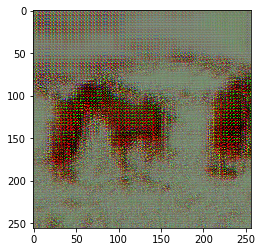

('Epoch 1/20...', 'Discriminator Loss: 0.6004...', 'Generator Loss: 7.3680')
Epoch: 1, Steps: 120
('Epoch 1/20...', 'Discriminator Loss: 0.6054...', 'Generator Loss: 10.9575')
Epoch: 1, Steps: 140
('Epoch 1/20...', 'Discriminator Loss: 0.5389...', 'Generator Loss: 7.0001')
Epoch: 1, Steps: 160
('Epoch 1/20...', 'Discriminator Loss: 0.5145...', 'Generator Loss: 7.7310')
Epoch: 1, Steps: 180
('Epoch 1/20...', 'Discriminator Loss: 0.5481...', 'Generator Loss: 8.0331')
Epoch: 1, Steps: 200


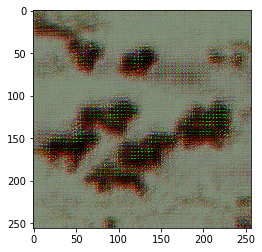

('Epoch 1/20...', 'Discriminator Loss: 0.6018...', 'Generator Loss: 5.3821')
Epoch: 1, Steps: 220
('Epoch 1/20...', 'Discriminator Loss: 0.4786...', 'Generator Loss: 7.4793')
Epoch: 1, Steps: 240
('Epoch 1/20...', 'Discriminator Loss: 0.5044...', 'Generator Loss: 12.0662')
Epoch: 1, Steps: 260
('Epoch 1/20...', 'Discriminator Loss: 0.5292...', 'Generator Loss: 6.9631')
Epoch: 1, Steps: 280
('Epoch 1/20...', 'Discriminator Loss: 0.5475...', 'Generator Loss: 5.4410')
Epoch: 1, Steps: 300


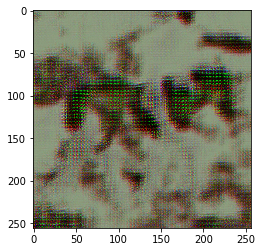

('Epoch 1/20...', 'Discriminator Loss: 0.4876...', 'Generator Loss: 7.3778')
Epoch: 1, Steps: 320
('Epoch 1/20...', 'Discriminator Loss: 0.4615...', 'Generator Loss: 7.8559')
Epoch: 1, Steps: 340
('Epoch 1/20...', 'Discriminator Loss: 0.5295...', 'Generator Loss: 7.5816')
Epoch: 1, Steps: 360
('Epoch 1/20...', 'Discriminator Loss: 0.5660...', 'Generator Loss: 6.3564')
Epoch: 1, Steps: 380
('Epoch 1/20...', 'Discriminator Loss: 0.4895...', 'Generator Loss: 7.1321')
Epoch: 1, Steps: 400


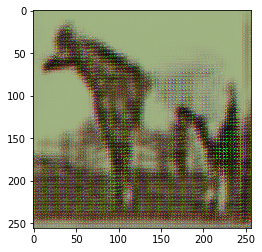

('Epoch 1/20...', 'Discriminator Loss: 0.4794...', 'Generator Loss: 7.2362')
Epoch: 1, Steps: 420
('Epoch 1/20...', 'Discriminator Loss: 0.4804...', 'Generator Loss: 6.8482')
Epoch: 1, Steps: 440
('Epoch 1/20...', 'Discriminator Loss: 0.4758...', 'Generator Loss: 7.0136')
Epoch: 1, Steps: 460
('Epoch 1/20...', 'Discriminator Loss: 0.4846...', 'Generator Loss: 8.1723')
Epoch: 1, Steps: 480
('Epoch 1/20...', 'Discriminator Loss: 0.5255...', 'Generator Loss: 6.8721')
Epoch: 1, Steps: 500


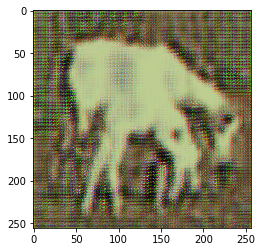

('Epoch 1/20...', 'Discriminator Loss: 0.4494...', 'Generator Loss: 5.5530')
Epoch: 1, Steps: 520
('Epoch 1/20...', 'Discriminator Loss: 0.4781...', 'Generator Loss: 8.0277')
Epoch: 1, Steps: 540
('Epoch 1/20...', 'Discriminator Loss: 0.4373...', 'Generator Loss: 6.0760')
Epoch: 1, Steps: 560
('Epoch 1/20...', 'Discriminator Loss: 0.5359...', 'Generator Loss: 5.9331')
Epoch: 1, Steps: 580
('Epoch 1/20...', 'Discriminator Loss: 0.5168...', 'Generator Loss: 9.4558')
Epoch: 1, Steps: 600


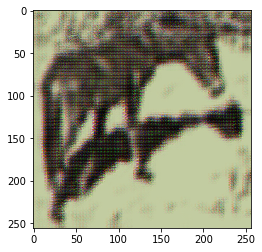

('Epoch 1/20...', 'Discriminator Loss: 0.4456...', 'Generator Loss: 7.7950')
Epoch: 1, Steps: 620
('Epoch 1/20...', 'Discriminator Loss: 0.5048...', 'Generator Loss: 5.3161')
Epoch: 1, Steps: 640
('Epoch 1/20...', 'Discriminator Loss: 0.4626...', 'Generator Loss: 5.5258')
Epoch: 1, Steps: 660
('Epoch 1/20...', 'Discriminator Loss: 0.4688...', 'Generator Loss: 6.3195')
Epoch: 1, Steps: 680
('Epoch 1/20...', 'Discriminator Loss: 0.4971...', 'Generator Loss: 5.8947')
Epoch: 1, Steps: 700


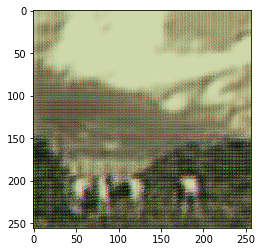

('Epoch 1/20...', 'Discriminator Loss: 0.5637...', 'Generator Loss: 6.7740')
Epoch: 1, Steps: 720
('Epoch 1/20...', 'Discriminator Loss: 0.4516...', 'Generator Loss: 5.8022')
Epoch: 1, Steps: 740
('Epoch 1/20...', 'Discriminator Loss: 0.5179...', 'Generator Loss: 4.8905')
Epoch: 1, Steps: 760
('Epoch 1/20...', 'Discriminator Loss: 0.4965...', 'Generator Loss: 7.0464')
Epoch: 1, Steps: 780
('Epoch 1/20...', 'Discriminator Loss: 0.4886...', 'Generator Loss: 6.6903')
Epoch: 1, Steps: 800


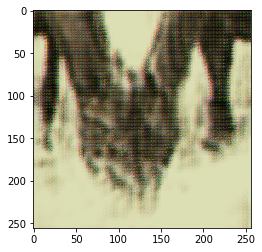

('Epoch 1/20...', 'Discriminator Loss: 0.5194...', 'Generator Loss: 5.3775')
Epoch: 1, Steps: 820
('Epoch 1/20...', 'Discriminator Loss: 0.5382...', 'Generator Loss: 5.3595')
Epoch: 1, Steps: 840
('Epoch 1/20...', 'Discriminator Loss: 0.5398...', 'Generator Loss: 7.3420')
Epoch: 1, Steps: 860
('Epoch 1/20...', 'Discriminator Loss: 0.4783...', 'Generator Loss: 6.0592')
Epoch: 1, Steps: 880
('Epoch 1/20...', 'Discriminator Loss: 0.4698...', 'Generator Loss: 7.1395')
Epoch: 1, Steps: 900


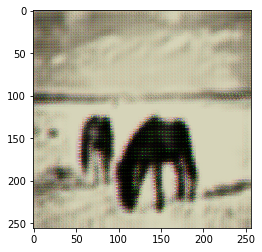

('Epoch 1/20...', 'Discriminator Loss: 0.4775...', 'Generator Loss: 6.6928')
Epoch: 1, Steps: 920
('Epoch 1/20...', 'Discriminator Loss: 0.5008...', 'Generator Loss: 4.4219')
Epoch: 1, Steps: 940
('Epoch 1/20...', 'Discriminator Loss: 0.5225...', 'Generator Loss: 5.5343')
Epoch: 1, Steps: 960
('Epoch 1/20...', 'Discriminator Loss: 0.3938...', 'Generator Loss: 5.5867')
Epoch: 1, Steps: 980
('Epoch 1/20...', 'Discriminator Loss: 0.4945...', 'Generator Loss: 5.6081')
Epoch: 1, Steps: 1000


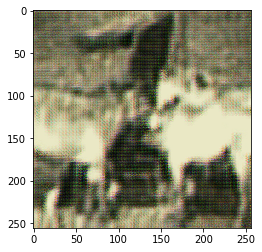

('Epoch 1/20...', 'Discriminator Loss: 0.5186...', 'Generator Loss: 6.5619')
Epoch: 1, Steps: 1020
('Epoch 1/20...', 'Discriminator Loss: 0.4752...', 'Generator Loss: 6.1223')
Epoch: 1, Steps: 1040
('Epoch 1/20...', 'Discriminator Loss: 0.3993...', 'Generator Loss: 5.1436')
Epoch: 1, Steps: 1060
('Epoch 2/20...', 'Discriminator Loss: 0.4318...', 'Generator Loss: 7.1281')
Epoch: 2, Steps: 1080
('Epoch 2/20...', 'Discriminator Loss: 0.3773...', 'Generator Loss: 5.2486')
Epoch: 2, Steps: 1100


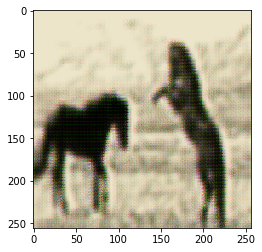

('Epoch 2/20...', 'Discriminator Loss: 0.4917...', 'Generator Loss: 5.0575')
Epoch: 2, Steps: 1120
('Epoch 2/20...', 'Discriminator Loss: 0.3730...', 'Generator Loss: 5.7696')
Epoch: 2, Steps: 1140
('Epoch 2/20...', 'Discriminator Loss: 0.4625...', 'Generator Loss: 5.6255')
Epoch: 2, Steps: 1160
('Epoch 2/20...', 'Discriminator Loss: 0.4562...', 'Generator Loss: 5.5905')
Epoch: 2, Steps: 1180
('Epoch 2/20...', 'Discriminator Loss: 0.5249...', 'Generator Loss: 7.8007')
Epoch: 2, Steps: 1200


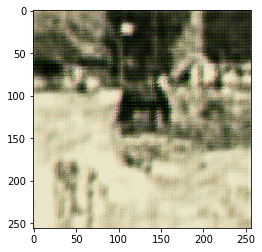

('Epoch 2/20...', 'Discriminator Loss: 0.5512...', 'Generator Loss: 4.9355')
Epoch: 2, Steps: 1220
('Epoch 2/20...', 'Discriminator Loss: 0.4578...', 'Generator Loss: 4.6209')
Epoch: 2, Steps: 1240
('Epoch 2/20...', 'Discriminator Loss: 0.3704...', 'Generator Loss: 6.1016')
Epoch: 2, Steps: 1260
('Epoch 2/20...', 'Discriminator Loss: 0.4782...', 'Generator Loss: 4.4282')
Epoch: 2, Steps: 1280
('Epoch 2/20...', 'Discriminator Loss: 0.3693...', 'Generator Loss: 6.7858')
Epoch: 2, Steps: 1300


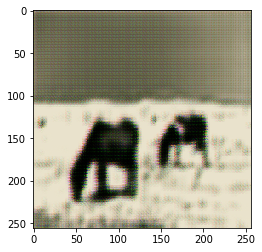

('Epoch 2/20...', 'Discriminator Loss: 0.4808...', 'Generator Loss: 5.6439')
Epoch: 2, Steps: 1320
('Epoch 2/20...', 'Discriminator Loss: 0.4237...', 'Generator Loss: 7.8587')
Epoch: 2, Steps: 1340
('Epoch 2/20...', 'Discriminator Loss: 0.4101...', 'Generator Loss: 6.4662')
Epoch: 2, Steps: 1360
('Epoch 2/20...', 'Discriminator Loss: 0.4350...', 'Generator Loss: 5.0857')
Epoch: 2, Steps: 1380
('Epoch 2/20...', 'Discriminator Loss: 0.4612...', 'Generator Loss: 5.6948')
Epoch: 2, Steps: 1400


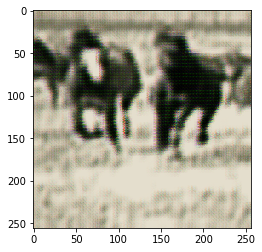

('Epoch 2/20...', 'Discriminator Loss: 0.4675...', 'Generator Loss: 6.0887')
Epoch: 2, Steps: 1420
('Epoch 2/20...', 'Discriminator Loss: 0.4649...', 'Generator Loss: 4.8176')
Epoch: 2, Steps: 1440
('Epoch 2/20...', 'Discriminator Loss: 0.3269...', 'Generator Loss: 5.2128')
Epoch: 2, Steps: 1460
('Epoch 2/20...', 'Discriminator Loss: 0.4647...', 'Generator Loss: 5.4156')
Epoch: 2, Steps: 1480
('Epoch 2/20...', 'Discriminator Loss: 0.5161...', 'Generator Loss: 5.7000')
Epoch: 2, Steps: 1500


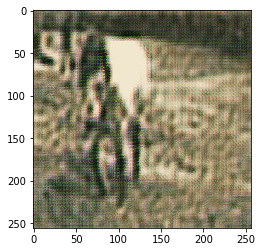

('Epoch 2/20...', 'Discriminator Loss: 0.3720...', 'Generator Loss: 4.3328')
Epoch: 2, Steps: 1520
('Epoch 2/20...', 'Discriminator Loss: 0.5816...', 'Generator Loss: 7.5240')
Epoch: 2, Steps: 1540
('Epoch 2/20...', 'Discriminator Loss: 0.3609...', 'Generator Loss: 6.8688')
Epoch: 2, Steps: 1560
('Epoch 2/20...', 'Discriminator Loss: 0.5340...', 'Generator Loss: 4.7718')
Epoch: 2, Steps: 1580
('Epoch 2/20...', 'Discriminator Loss: 0.4592...', 'Generator Loss: 4.9194')
Epoch: 2, Steps: 1600


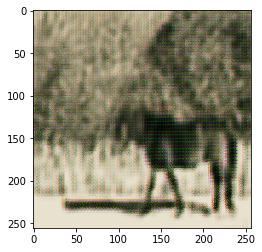

('Epoch 2/20...', 'Discriminator Loss: 0.5204...', 'Generator Loss: 7.2915')
Epoch: 2, Steps: 1620
('Epoch 2/20...', 'Discriminator Loss: 0.5510...', 'Generator Loss: 6.6973')
Epoch: 2, Steps: 1640
('Epoch 2/20...', 'Discriminator Loss: 0.5529...', 'Generator Loss: 5.4551')
Epoch: 2, Steps: 1660
('Epoch 2/20...', 'Discriminator Loss: 0.4882...', 'Generator Loss: 4.1212')
Epoch: 2, Steps: 1680
('Epoch 2/20...', 'Discriminator Loss: 0.4452...', 'Generator Loss: 4.3255')
Epoch: 2, Steps: 1700


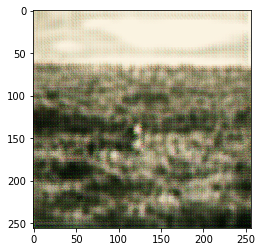

('Epoch 2/20...', 'Discriminator Loss: 0.3606...', 'Generator Loss: 4.6771')
Epoch: 2, Steps: 1720
('Epoch 2/20...', 'Discriminator Loss: 0.4293...', 'Generator Loss: 5.8139')
Epoch: 2, Steps: 1740
('Epoch 2/20...', 'Discriminator Loss: 0.4088...', 'Generator Loss: 7.7620')
Epoch: 2, Steps: 1760
('Epoch 2/20...', 'Discriminator Loss: 0.5059...', 'Generator Loss: 5.6102')
Epoch: 2, Steps: 1780
('Epoch 2/20...', 'Discriminator Loss: 0.3708...', 'Generator Loss: 6.8091')
Epoch: 2, Steps: 1800


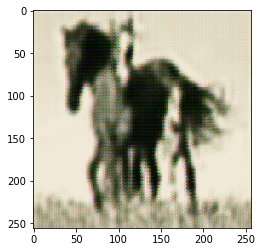

('Epoch 2/20...', 'Discriminator Loss: 0.4790...', 'Generator Loss: 5.1007')
Epoch: 2, Steps: 1820
('Epoch 2/20...', 'Discriminator Loss: 0.5114...', 'Generator Loss: 5.4761')
Epoch: 2, Steps: 1840
('Epoch 2/20...', 'Discriminator Loss: 0.4360...', 'Generator Loss: 4.6256')
Epoch: 2, Steps: 1860
('Epoch 2/20...', 'Discriminator Loss: 0.5263...', 'Generator Loss: 4.9425')
Epoch: 2, Steps: 1880
('Epoch 2/20...', 'Discriminator Loss: 0.2559...', 'Generator Loss: 5.7413')
Epoch: 2, Steps: 1900


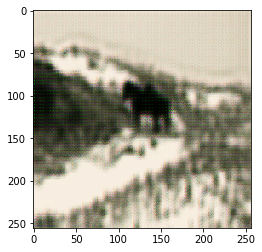

('Epoch 2/20...', 'Discriminator Loss: 0.4372...', 'Generator Loss: 4.5983')
Epoch: 2, Steps: 1920
('Epoch 2/20...', 'Discriminator Loss: 0.4176...', 'Generator Loss: 7.5408')
Epoch: 2, Steps: 1940
('Epoch 2/20...', 'Discriminator Loss: 0.4765...', 'Generator Loss: 7.1454')
Epoch: 2, Steps: 1960
('Epoch 2/20...', 'Discriminator Loss: 0.5094...', 'Generator Loss: 5.0398')
Epoch: 2, Steps: 1980
('Epoch 2/20...', 'Discriminator Loss: 0.5321...', 'Generator Loss: 5.2075')
Epoch: 2, Steps: 2000


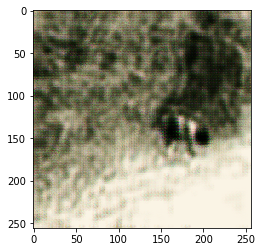

('Epoch 2/20...', 'Discriminator Loss: 0.3049...', 'Generator Loss: 5.6086')
Epoch: 2, Steps: 2020
('Epoch 2/20...', 'Discriminator Loss: 0.4404...', 'Generator Loss: 4.9215')
Epoch: 2, Steps: 2040
('Epoch 2/20...', 'Discriminator Loss: 0.3376...', 'Generator Loss: 4.8955')
Epoch: 2, Steps: 2060
('Epoch 2/20...', 'Discriminator Loss: 0.3471...', 'Generator Loss: 4.8587')
Epoch: 2, Steps: 2080
('Epoch 2/20...', 'Discriminator Loss: 0.2509...', 'Generator Loss: 6.5580')
Epoch: 2, Steps: 2100


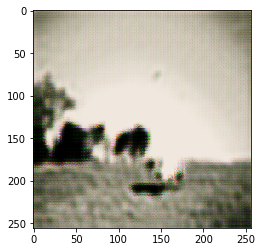

('Epoch 2/20...', 'Discriminator Loss: 0.3353...', 'Generator Loss: 5.0130')
Epoch: 2, Steps: 2120
('Epoch 3/20...', 'Discriminator Loss: 0.4672...', 'Generator Loss: 4.4474')
Epoch: 3, Steps: 2140
('Epoch 3/20...', 'Discriminator Loss: 0.4640...', 'Generator Loss: 5.4324')
Epoch: 3, Steps: 2160
('Epoch 3/20...', 'Discriminator Loss: 0.4804...', 'Generator Loss: 5.5688')
Epoch: 3, Steps: 2180
('Epoch 3/20...', 'Discriminator Loss: 0.2506...', 'Generator Loss: 5.6278')
Epoch: 3, Steps: 2200


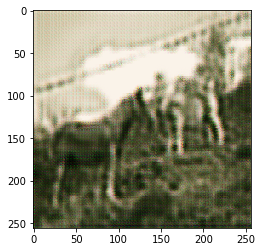

('Epoch 3/20...', 'Discriminator Loss: 0.7535...', 'Generator Loss: 4.8307')
Epoch: 3, Steps: 2220
('Epoch 3/20...', 'Discriminator Loss: 0.4623...', 'Generator Loss: 4.9192')
Epoch: 3, Steps: 2240
('Epoch 3/20...', 'Discriminator Loss: 0.4843...', 'Generator Loss: 5.0898')
Epoch: 3, Steps: 2260
('Epoch 3/20...', 'Discriminator Loss: 0.5141...', 'Generator Loss: 5.1781')
Epoch: 3, Steps: 2280
('Epoch 3/20...', 'Discriminator Loss: 0.4055...', 'Generator Loss: 4.4833')
Epoch: 3, Steps: 2300


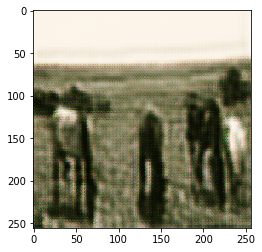

('Epoch 3/20...', 'Discriminator Loss: 0.5037...', 'Generator Loss: 5.8817')
Epoch: 3, Steps: 2320
('Epoch 3/20...', 'Discriminator Loss: 0.3799...', 'Generator Loss: 3.8725')
Epoch: 3, Steps: 2340
('Epoch 3/20...', 'Discriminator Loss: 0.3041...', 'Generator Loss: 5.6646')
Epoch: 3, Steps: 2360
('Epoch 3/20...', 'Discriminator Loss: 0.3927...', 'Generator Loss: 5.3832')
Epoch: 3, Steps: 2380
('Epoch 3/20...', 'Discriminator Loss: 0.3476...', 'Generator Loss: 5.1538')
Epoch: 3, Steps: 2400


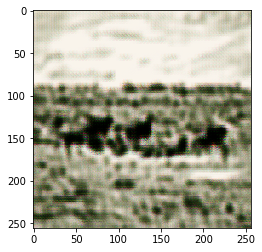

('Epoch 3/20...', 'Discriminator Loss: 0.4820...', 'Generator Loss: 6.0004')
Epoch: 3, Steps: 2420
('Epoch 3/20...', 'Discriminator Loss: 0.2960...', 'Generator Loss: 6.0804')
Epoch: 3, Steps: 2440
('Epoch 3/20...', 'Discriminator Loss: 0.6024...', 'Generator Loss: 8.0836')
Epoch: 3, Steps: 2460
('Epoch 3/20...', 'Discriminator Loss: 0.3351...', 'Generator Loss: 8.0733')
Epoch: 3, Steps: 2480
('Epoch 3/20...', 'Discriminator Loss: 0.3202...', 'Generator Loss: 4.8717')
Epoch: 3, Steps: 2500


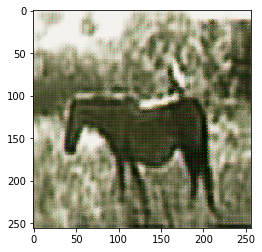

('Epoch 3/20...', 'Discriminator Loss: 0.5016...', 'Generator Loss: 4.4985')
Epoch: 3, Steps: 2520
('Epoch 3/20...', 'Discriminator Loss: 0.5226...', 'Generator Loss: 5.7835')
Epoch: 3, Steps: 2540
('Epoch 3/20...', 'Discriminator Loss: 0.3599...', 'Generator Loss: 5.7646')
Epoch: 3, Steps: 2560
('Epoch 3/20...', 'Discriminator Loss: 0.5076...', 'Generator Loss: 4.9266')
Epoch: 3, Steps: 2580
('Epoch 3/20...', 'Discriminator Loss: 0.3879...', 'Generator Loss: 5.9664')
Epoch: 3, Steps: 2600


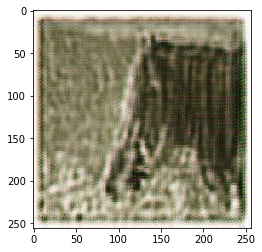

('Epoch 3/20...', 'Discriminator Loss: 0.2489...', 'Generator Loss: 8.5271')
Epoch: 3, Steps: 2620
('Epoch 3/20...', 'Discriminator Loss: 0.1620...', 'Generator Loss: 5.3019')
Epoch: 3, Steps: 2640
('Epoch 3/20...', 'Discriminator Loss: 0.3160...', 'Generator Loss: 5.4816')
Epoch: 3, Steps: 2660
('Epoch 3/20...', 'Discriminator Loss: 0.4361...', 'Generator Loss: 5.3606')
Epoch: 3, Steps: 2680
('Epoch 3/20...', 'Discriminator Loss: 0.4861...', 'Generator Loss: 5.3154')
Epoch: 3, Steps: 2700


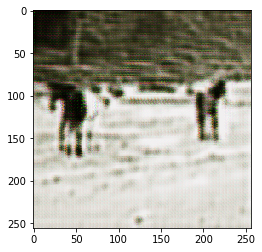

('Epoch 3/20...', 'Discriminator Loss: 0.3039...', 'Generator Loss: 7.0403')
Epoch: 3, Steps: 2720
('Epoch 3/20...', 'Discriminator Loss: 0.2964...', 'Generator Loss: 5.0691')
Epoch: 3, Steps: 2740
('Epoch 3/20...', 'Discriminator Loss: 0.3869...', 'Generator Loss: 4.6622')
Epoch: 3, Steps: 2760
('Epoch 3/20...', 'Discriminator Loss: 0.3778...', 'Generator Loss: 6.0658')
Epoch: 3, Steps: 2780
('Epoch 3/20...', 'Discriminator Loss: 0.3514...', 'Generator Loss: 4.4542')
Epoch: 3, Steps: 2800


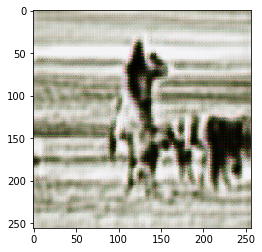

('Epoch 3/20...', 'Discriminator Loss: 0.2704...', 'Generator Loss: 4.9592')
Epoch: 3, Steps: 2820
('Epoch 3/20...', 'Discriminator Loss: 0.3772...', 'Generator Loss: 4.8416')
Epoch: 3, Steps: 2840
('Epoch 3/20...', 'Discriminator Loss: 0.3243...', 'Generator Loss: 5.0251')
Epoch: 3, Steps: 2860
('Epoch 3/20...', 'Discriminator Loss: 0.5059...', 'Generator Loss: 6.6910')
Epoch: 3, Steps: 2880
('Epoch 3/20...', 'Discriminator Loss: 0.3502...', 'Generator Loss: 6.6259')
Epoch: 3, Steps: 2900


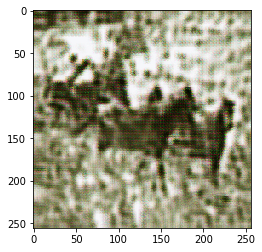

('Epoch 3/20...', 'Discriminator Loss: 0.4342...', 'Generator Loss: 5.5698')
Epoch: 3, Steps: 2920
('Epoch 3/20...', 'Discriminator Loss: 0.4412...', 'Generator Loss: 4.4711')
Epoch: 3, Steps: 2940
('Epoch 3/20...', 'Discriminator Loss: 0.3180...', 'Generator Loss: 5.2422')
Epoch: 3, Steps: 2960
('Epoch 3/20...', 'Discriminator Loss: 0.4237...', 'Generator Loss: 6.3312')
Epoch: 3, Steps: 2980
('Epoch 3/20...', 'Discriminator Loss: 0.4799...', 'Generator Loss: 4.6937')
Epoch: 3, Steps: 3000


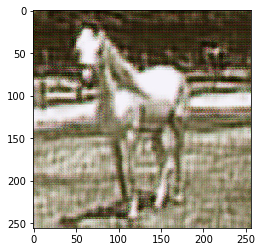

('Epoch 3/20...', 'Discriminator Loss: 0.2800...', 'Generator Loss: 8.7142')
Epoch: 3, Steps: 3020
('Epoch 3/20...', 'Discriminator Loss: 0.1965...', 'Generator Loss: 5.8289')
Epoch: 3, Steps: 3040
('Epoch 3/20...', 'Discriminator Loss: 0.4044...', 'Generator Loss: 4.5777')
Epoch: 3, Steps: 3060
('Epoch 3/20...', 'Discriminator Loss: 0.4494...', 'Generator Loss: 6.4415')
Epoch: 3, Steps: 3080
('Epoch 3/20...', 'Discriminator Loss: 0.2333...', 'Generator Loss: 5.4330')
Epoch: 3, Steps: 3100


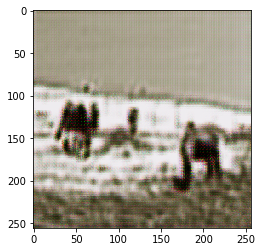

('Epoch 3/20...', 'Discriminator Loss: 0.4306...', 'Generator Loss: 5.3060')
Epoch: 3, Steps: 3120
('Epoch 3/20...', 'Discriminator Loss: 0.2912...', 'Generator Loss: 5.3213')
Epoch: 3, Steps: 3140
('Epoch 3/20...', 'Discriminator Loss: 0.2170...', 'Generator Loss: 6.7089')
Epoch: 3, Steps: 3160
('Epoch 3/20...', 'Discriminator Loss: 0.4135...', 'Generator Loss: 5.0028')
Epoch: 3, Steps: 3180
('Epoch 3/20...', 'Discriminator Loss: 0.4880...', 'Generator Loss: 6.0899')
Epoch: 3, Steps: 3200


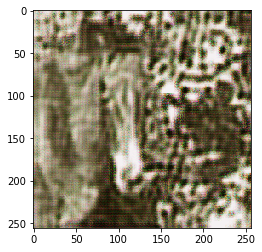

('Epoch 4/20...', 'Discriminator Loss: 0.4042...', 'Generator Loss: 5.0021')
Epoch: 4, Steps: 3220
('Epoch 4/20...', 'Discriminator Loss: 0.3881...', 'Generator Loss: 5.9859')
Epoch: 4, Steps: 3240
('Epoch 4/20...', 'Discriminator Loss: 0.4281...', 'Generator Loss: 5.3019')
Epoch: 4, Steps: 3260
('Epoch 4/20...', 'Discriminator Loss: 0.2367...', 'Generator Loss: 4.2568')
Epoch: 4, Steps: 3280
('Epoch 4/20...', 'Discriminator Loss: 0.2070...', 'Generator Loss: 6.8984')
Epoch: 4, Steps: 3300


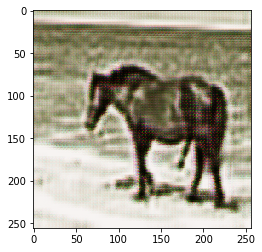

('Epoch 4/20...', 'Discriminator Loss: 0.4095...', 'Generator Loss: 5.8228')
Epoch: 4, Steps: 3320
('Epoch 4/20...', 'Discriminator Loss: 0.5154...', 'Generator Loss: 5.0099')
Epoch: 4, Steps: 3340
('Epoch 4/20...', 'Discriminator Loss: 0.3794...', 'Generator Loss: 5.3934')
Epoch: 4, Steps: 3360
('Epoch 4/20...', 'Discriminator Loss: 0.4330...', 'Generator Loss: 4.1727')
Epoch: 4, Steps: 3380
('Epoch 4/20...', 'Discriminator Loss: 0.2087...', 'Generator Loss: 4.5631')
Epoch: 4, Steps: 3400


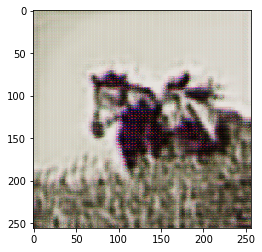

('Epoch 4/20...', 'Discriminator Loss: 0.2991...', 'Generator Loss: 6.7965')
Epoch: 4, Steps: 3420
('Epoch 4/20...', 'Discriminator Loss: 0.3643...', 'Generator Loss: 5.5121')
Epoch: 4, Steps: 3440
('Epoch 4/20...', 'Discriminator Loss: 0.4047...', 'Generator Loss: 5.0059')
Epoch: 4, Steps: 3460
('Epoch 4/20...', 'Discriminator Loss: 0.5417...', 'Generator Loss: 4.7735')
Epoch: 4, Steps: 3480
('Epoch 4/20...', 'Discriminator Loss: 0.5111...', 'Generator Loss: 4.8287')
Epoch: 4, Steps: 3500


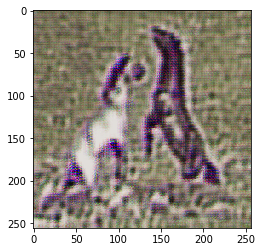

('Epoch 4/20...', 'Discriminator Loss: 0.4740...', 'Generator Loss: 6.7528')
Epoch: 4, Steps: 3520
('Epoch 4/20...', 'Discriminator Loss: 0.3423...', 'Generator Loss: 6.5418')
Epoch: 4, Steps: 3540
('Epoch 4/20...', 'Discriminator Loss: 0.4086...', 'Generator Loss: 4.5812')
Epoch: 4, Steps: 3560
('Epoch 4/20...', 'Discriminator Loss: 0.3792...', 'Generator Loss: 6.0182')
Epoch: 4, Steps: 3580
('Epoch 4/20...', 'Discriminator Loss: 0.3826...', 'Generator Loss: 5.7672')
Epoch: 4, Steps: 3600


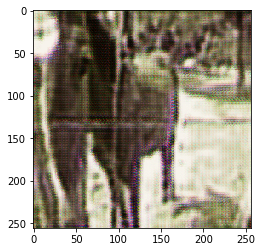

('Epoch 4/20...', 'Discriminator Loss: 0.4349...', 'Generator Loss: 5.7394')
Epoch: 4, Steps: 3620
('Epoch 4/20...', 'Discriminator Loss: 0.5818...', 'Generator Loss: 5.7569')
Epoch: 4, Steps: 3640
('Epoch 4/20...', 'Discriminator Loss: 0.5303...', 'Generator Loss: 4.6445')
Epoch: 4, Steps: 3660
('Epoch 4/20...', 'Discriminator Loss: 0.2186...', 'Generator Loss: 4.6132')
Epoch: 4, Steps: 3680
('Epoch 4/20...', 'Discriminator Loss: 0.4110...', 'Generator Loss: 6.5160')
Epoch: 4, Steps: 3700


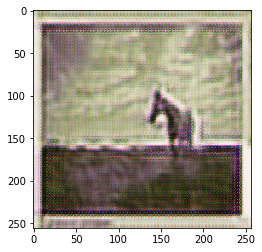

('Epoch 4/20...', 'Discriminator Loss: 0.3633...', 'Generator Loss: 6.0420')
Epoch: 4, Steps: 3720
('Epoch 4/20...', 'Discriminator Loss: 0.5751...', 'Generator Loss: 4.3145')
Epoch: 4, Steps: 3740
('Epoch 4/20...', 'Discriminator Loss: 0.4463...', 'Generator Loss: 5.6856')
Epoch: 4, Steps: 3760
('Epoch 4/20...', 'Discriminator Loss: 0.3782...', 'Generator Loss: 4.6386')
Epoch: 4, Steps: 3780
('Epoch 4/20...', 'Discriminator Loss: 0.3584...', 'Generator Loss: 3.7321')
Epoch: 4, Steps: 3800


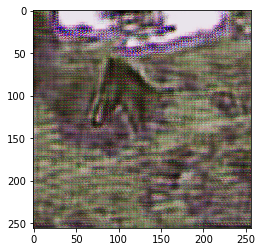

('Epoch 4/20...', 'Discriminator Loss: 0.3951...', 'Generator Loss: 6.2976')
Epoch: 4, Steps: 3820
('Epoch 4/20...', 'Discriminator Loss: 0.5532...', 'Generator Loss: 4.3548')
Epoch: 4, Steps: 3840
('Epoch 4/20...', 'Discriminator Loss: 0.2617...', 'Generator Loss: 5.4743')
Epoch: 4, Steps: 3860
('Epoch 4/20...', 'Discriminator Loss: 0.3657...', 'Generator Loss: 4.6172')
Epoch: 4, Steps: 3880
('Epoch 4/20...', 'Discriminator Loss: 0.4476...', 'Generator Loss: 4.7089')
Epoch: 4, Steps: 3900


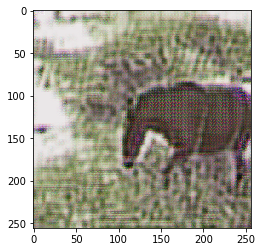

('Epoch 4/20...', 'Discriminator Loss: 0.3377...', 'Generator Loss: 5.7852')
Epoch: 4, Steps: 3920
('Epoch 4/20...', 'Discriminator Loss: 0.4821...', 'Generator Loss: 5.8089')
Epoch: 4, Steps: 3940
('Epoch 4/20...', 'Discriminator Loss: 0.3946...', 'Generator Loss: 5.8947')
Epoch: 4, Steps: 3960
('Epoch 4/20...', 'Discriminator Loss: 0.5001...', 'Generator Loss: 4.9427')
Epoch: 4, Steps: 3980
('Epoch 4/20...', 'Discriminator Loss: 0.4681...', 'Generator Loss: 5.3553')
Epoch: 4, Steps: 4000


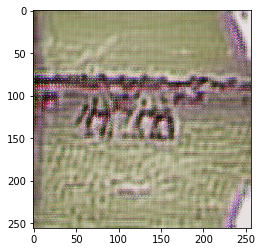

('Epoch 4/20...', 'Discriminator Loss: 0.4725...', 'Generator Loss: 4.2564')
Epoch: 4, Steps: 4020
('Epoch 4/20...', 'Discriminator Loss: 0.3559...', 'Generator Loss: 6.4511')
Epoch: 4, Steps: 4040
('Epoch 4/20...', 'Discriminator Loss: 0.5907...', 'Generator Loss: 4.9054')
Epoch: 4, Steps: 4060
('Epoch 4/20...', 'Discriminator Loss: 0.3213...', 'Generator Loss: 4.8306')
Epoch: 4, Steps: 4080
('Epoch 4/20...', 'Discriminator Loss: 0.2569...', 'Generator Loss: 4.2822')
Epoch: 4, Steps: 4100


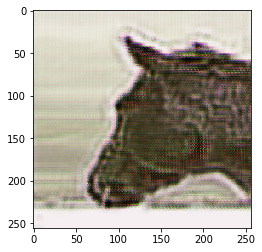

('Epoch 4/20...', 'Discriminator Loss: 0.4712...', 'Generator Loss: 5.7153')
Epoch: 4, Steps: 4120
('Epoch 4/20...', 'Discriminator Loss: 0.4784...', 'Generator Loss: 5.3934')
Epoch: 4, Steps: 4140
('Epoch 4/20...', 'Discriminator Loss: 0.2958...', 'Generator Loss: 4.4386')
Epoch: 4, Steps: 4160
('Epoch 4/20...', 'Discriminator Loss: 0.2475...', 'Generator Loss: 5.4610')
Epoch: 4, Steps: 4180
('Epoch 4/20...', 'Discriminator Loss: 0.2974...', 'Generator Loss: 5.4959')
Epoch: 4, Steps: 4200


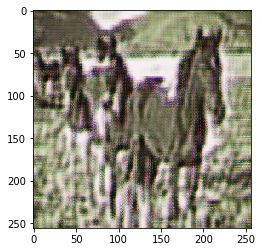

('Epoch 4/20...', 'Discriminator Loss: 0.4442...', 'Generator Loss: 5.6047')
Epoch: 4, Steps: 4220
('Epoch 4/20...', 'Discriminator Loss: 0.2912...', 'Generator Loss: 5.0806')
Epoch: 4, Steps: 4240
('Epoch 4/20...', 'Discriminator Loss: 0.4063...', 'Generator Loss: 4.3349')
Epoch: 4, Steps: 4260
('Epoch 5/20...', 'Discriminator Loss: 0.5244...', 'Generator Loss: 5.0495')
Epoch: 5, Steps: 4280
('Epoch 5/20...', 'Discriminator Loss: 0.3407...', 'Generator Loss: 5.7903')
Epoch: 5, Steps: 4300


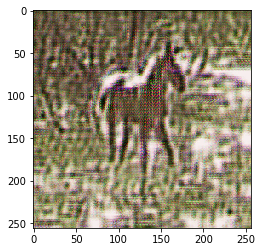

('Epoch 5/20...', 'Discriminator Loss: 0.5261...', 'Generator Loss: 5.7364')
Epoch: 5, Steps: 4320
('Epoch 5/20...', 'Discriminator Loss: 0.4399...', 'Generator Loss: 5.0843')
Epoch: 5, Steps: 4340
('Epoch 5/20...', 'Discriminator Loss: 0.3482...', 'Generator Loss: 5.0496')
Epoch: 5, Steps: 4360
('Epoch 5/20...', 'Discriminator Loss: 0.5996...', 'Generator Loss: 6.0067')
Epoch: 5, Steps: 4380
('Epoch 5/20...', 'Discriminator Loss: 0.2997...', 'Generator Loss: 4.7530')
Epoch: 5, Steps: 4400


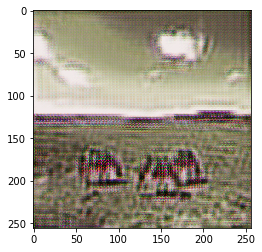

('Epoch 5/20...', 'Discriminator Loss: 0.3277...', 'Generator Loss: 4.8765')
Epoch: 5, Steps: 4420
('Epoch 5/20...', 'Discriminator Loss: 0.3974...', 'Generator Loss: 5.6005')
Epoch: 5, Steps: 4440
('Epoch 5/20...', 'Discriminator Loss: 0.3708...', 'Generator Loss: 6.3017')
Epoch: 5, Steps: 4460
('Epoch 5/20...', 'Discriminator Loss: 0.2077...', 'Generator Loss: 5.9508')
Epoch: 5, Steps: 4480
('Epoch 5/20...', 'Discriminator Loss: 0.4232...', 'Generator Loss: 4.8494')
Epoch: 5, Steps: 4500


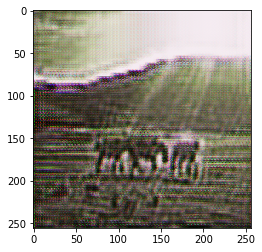

('Epoch 5/20...', 'Discriminator Loss: 0.3844...', 'Generator Loss: 5.6946')
Epoch: 5, Steps: 4520
('Epoch 5/20...', 'Discriminator Loss: 0.4084...', 'Generator Loss: 4.6205')
Epoch: 5, Steps: 4540
('Epoch 5/20...', 'Discriminator Loss: 0.5646...', 'Generator Loss: 7.0638')
Epoch: 5, Steps: 4560
('Epoch 5/20...', 'Discriminator Loss: 0.4970...', 'Generator Loss: 5.7170')
Epoch: 5, Steps: 4580
('Epoch 5/20...', 'Discriminator Loss: 0.3052...', 'Generator Loss: 4.4549')
Epoch: 5, Steps: 4600


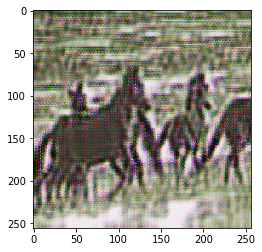

('Epoch 5/20...', 'Discriminator Loss: 0.4370...', 'Generator Loss: 5.2590')
Epoch: 5, Steps: 4620
('Epoch 5/20...', 'Discriminator Loss: 0.2570...', 'Generator Loss: 5.4262')
Epoch: 5, Steps: 4640
('Epoch 5/20...', 'Discriminator Loss: 0.3954...', 'Generator Loss: 4.2496')
Epoch: 5, Steps: 4660
('Epoch 5/20...', 'Discriminator Loss: 0.3681...', 'Generator Loss: 6.4209')
Epoch: 5, Steps: 4680
('Epoch 5/20...', 'Discriminator Loss: 0.3787...', 'Generator Loss: 4.8822')
Epoch: 5, Steps: 4700


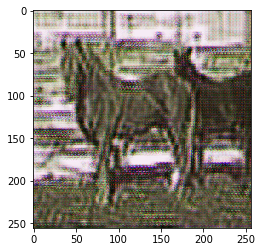

('Epoch 5/20...', 'Discriminator Loss: 0.2293...', 'Generator Loss: 4.2279')
Epoch: 5, Steps: 4720
('Epoch 5/20...', 'Discriminator Loss: 0.4287...', 'Generator Loss: 4.2095')
Epoch: 5, Steps: 4740
('Epoch 5/20...', 'Discriminator Loss: 0.4806...', 'Generator Loss: 5.8570')
Epoch: 5, Steps: 4760
('Epoch 5/20...', 'Discriminator Loss: 0.2354...', 'Generator Loss: 4.5306')
Epoch: 5, Steps: 4780
('Epoch 5/20...', 'Discriminator Loss: 0.5236...', 'Generator Loss: 5.6431')
Epoch: 5, Steps: 4800


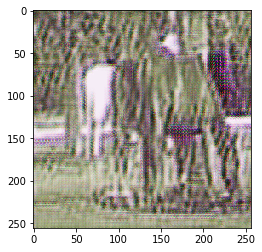

('Epoch 5/20...', 'Discriminator Loss: 0.4864...', 'Generator Loss: 4.6143')
Epoch: 5, Steps: 4820
('Epoch 5/20...', 'Discriminator Loss: 0.2845...', 'Generator Loss: 5.1513')
Epoch: 5, Steps: 4840
('Epoch 5/20...', 'Discriminator Loss: 0.3962...', 'Generator Loss: 4.5472')
Epoch: 5, Steps: 4860
('Epoch 5/20...', 'Discriminator Loss: 0.4323...', 'Generator Loss: 4.6103')
Epoch: 5, Steps: 4880
('Epoch 5/20...', 'Discriminator Loss: 0.3523...', 'Generator Loss: 6.1999')
Epoch: 5, Steps: 4900


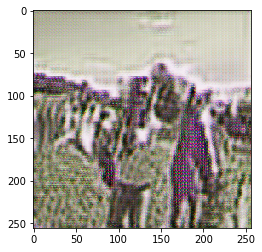

('Epoch 5/20...', 'Discriminator Loss: 0.4151...', 'Generator Loss: 7.3494')
Epoch: 5, Steps: 4920
('Epoch 5/20...', 'Discriminator Loss: 0.4330...', 'Generator Loss: 5.8274')
Epoch: 5, Steps: 4940
('Epoch 5/20...', 'Discriminator Loss: 0.4630...', 'Generator Loss: 4.8806')
Epoch: 5, Steps: 4960
('Epoch 5/20...', 'Discriminator Loss: 0.4009...', 'Generator Loss: 4.9127')
Epoch: 5, Steps: 4980
('Epoch 5/20...', 'Discriminator Loss: 0.3106...', 'Generator Loss: 5.4584')
Epoch: 5, Steps: 5000


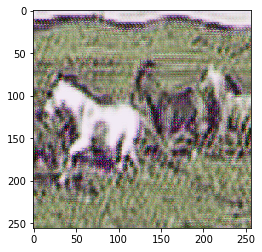

('Epoch 5/20...', 'Discriminator Loss: 0.4216...', 'Generator Loss: 4.3344')
Epoch: 5, Steps: 5020
('Epoch 5/20...', 'Discriminator Loss: 0.4032...', 'Generator Loss: 5.4819')
Epoch: 5, Steps: 5040
('Epoch 5/20...', 'Discriminator Loss: 0.1704...', 'Generator Loss: 5.3535')
Epoch: 5, Steps: 5060
('Epoch 5/20...', 'Discriminator Loss: 0.5603...', 'Generator Loss: 4.8855')
Epoch: 5, Steps: 5080
('Epoch 5/20...', 'Discriminator Loss: 0.4720...', 'Generator Loss: 5.9947')
Epoch: 5, Steps: 5100


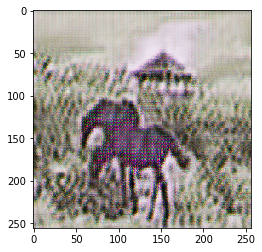

('Epoch 5/20...', 'Discriminator Loss: 0.6778...', 'Generator Loss: 4.5857')
Epoch: 5, Steps: 5120
('Epoch 5/20...', 'Discriminator Loss: 0.4515...', 'Generator Loss: 5.1156')
Epoch: 5, Steps: 5140
('Epoch 5/20...', 'Discriminator Loss: 0.3766...', 'Generator Loss: 4.2862')
Epoch: 5, Steps: 5160
('Epoch 5/20...', 'Discriminator Loss: 0.3134...', 'Generator Loss: 5.0586')
Epoch: 5, Steps: 5180
('Epoch 5/20...', 'Discriminator Loss: 0.4252...', 'Generator Loss: 6.4288')
Epoch: 5, Steps: 5200


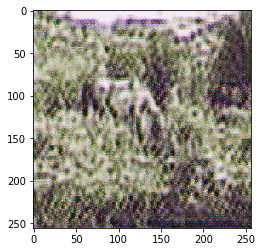

('Epoch 5/20...', 'Discriminator Loss: 0.4629...', 'Generator Loss: 4.3113')
Epoch: 5, Steps: 5220
('Epoch 5/20...', 'Discriminator Loss: 0.3351...', 'Generator Loss: 4.9291')
Epoch: 5, Steps: 5240
('Epoch 5/20...', 'Discriminator Loss: 0.3950...', 'Generator Loss: 5.5393')
Epoch: 5, Steps: 5260
('Epoch 5/20...', 'Discriminator Loss: 0.5139...', 'Generator Loss: 6.3641')
Epoch: 5, Steps: 5280
('Epoch 5/20...', 'Discriminator Loss: 0.3370...', 'Generator Loss: 5.9727')
Epoch: 5, Steps: 5300


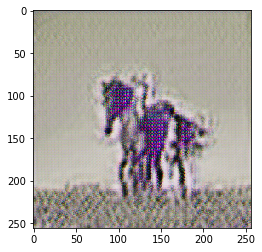

('Epoch 5/20...', 'Discriminator Loss: 0.4929...', 'Generator Loss: 4.5954')
Epoch: 5, Steps: 5320
('Epoch 6/20...', 'Discriminator Loss: 0.3329...', 'Generator Loss: 5.7817')
Epoch: 6, Steps: 5340
('Epoch 6/20...', 'Discriminator Loss: 0.5487...', 'Generator Loss: 5.0027')
Epoch: 6, Steps: 5360
('Epoch 6/20...', 'Discriminator Loss: 0.2884...', 'Generator Loss: 5.0928')
Epoch: 6, Steps: 5380
('Epoch 6/20...', 'Discriminator Loss: 0.3621...', 'Generator Loss: 4.2901')
Epoch: 6, Steps: 5400


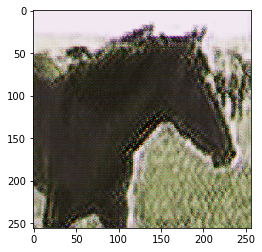

('Epoch 6/20...', 'Discriminator Loss: 0.5536...', 'Generator Loss: 4.8664')
Epoch: 6, Steps: 5420
('Epoch 6/20...', 'Discriminator Loss: 0.4163...', 'Generator Loss: 5.4236')
Epoch: 6, Steps: 5440
('Epoch 6/20...', 'Discriminator Loss: 0.4920...', 'Generator Loss: 4.4700')
Epoch: 6, Steps: 5460
('Epoch 6/20...', 'Discriminator Loss: 0.4181...', 'Generator Loss: 5.1566')
Epoch: 6, Steps: 5480
('Epoch 6/20...', 'Discriminator Loss: 0.3049...', 'Generator Loss: 5.0096')
Epoch: 6, Steps: 5500


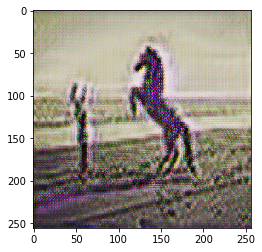

('Epoch 6/20...', 'Discriminator Loss: 0.3214...', 'Generator Loss: 6.1777')
Epoch: 6, Steps: 5520
('Epoch 6/20...', 'Discriminator Loss: 0.5194...', 'Generator Loss: 4.1142')
Epoch: 6, Steps: 5540
('Epoch 6/20...', 'Discriminator Loss: 0.5769...', 'Generator Loss: 3.9560')
Epoch: 6, Steps: 5560
('Epoch 6/20...', 'Discriminator Loss: 0.2983...', 'Generator Loss: 4.7126')
Epoch: 6, Steps: 5580
('Epoch 6/20...', 'Discriminator Loss: 0.3247...', 'Generator Loss: 4.6910')
Epoch: 6, Steps: 5600


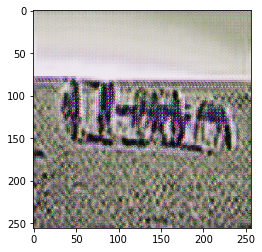

('Epoch 6/20...', 'Discriminator Loss: 0.5291...', 'Generator Loss: 5.1721')
Epoch: 6, Steps: 5620
('Epoch 6/20...', 'Discriminator Loss: 0.3319...', 'Generator Loss: 5.8393')
Epoch: 6, Steps: 5640
('Epoch 6/20...', 'Discriminator Loss: 0.3672...', 'Generator Loss: 6.1550')
Epoch: 6, Steps: 5660
('Epoch 6/20...', 'Discriminator Loss: 0.5394...', 'Generator Loss: 5.0095')
Epoch: 6, Steps: 5680
('Epoch 6/20...', 'Discriminator Loss: 0.4338...', 'Generator Loss: 5.4589')
Epoch: 6, Steps: 5700


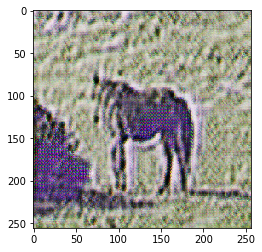

('Epoch 6/20...', 'Discriminator Loss: 0.4249...', 'Generator Loss: 5.2068')
Epoch: 6, Steps: 5720
('Epoch 6/20...', 'Discriminator Loss: 0.2962...', 'Generator Loss: 5.8731')
Epoch: 6, Steps: 5740
('Epoch 6/20...', 'Discriminator Loss: 0.3841...', 'Generator Loss: 4.6146')
Epoch: 6, Steps: 5760
('Epoch 6/20...', 'Discriminator Loss: 0.4783...', 'Generator Loss: 4.0732')
Epoch: 6, Steps: 5780
('Epoch 6/20...', 'Discriminator Loss: 0.4421...', 'Generator Loss: 5.3369')
Epoch: 6, Steps: 5800


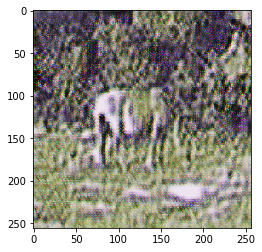

('Epoch 6/20...', 'Discriminator Loss: 0.3345...', 'Generator Loss: 3.6972')
Epoch: 6, Steps: 5820
('Epoch 6/20...', 'Discriminator Loss: 0.3261...', 'Generator Loss: 5.0524')
Epoch: 6, Steps: 5840
('Epoch 6/20...', 'Discriminator Loss: 0.3239...', 'Generator Loss: 6.5512')
Epoch: 6, Steps: 5860
('Epoch 6/20...', 'Discriminator Loss: 0.3450...', 'Generator Loss: 5.9734')
Epoch: 6, Steps: 5880
('Epoch 6/20...', 'Discriminator Loss: 0.3408...', 'Generator Loss: 5.5238')
Epoch: 6, Steps: 5900


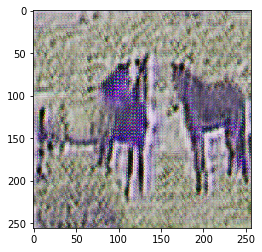

('Epoch 6/20...', 'Discriminator Loss: 0.3632...', 'Generator Loss: 4.3471')
Epoch: 6, Steps: 5920
('Epoch 6/20...', 'Discriminator Loss: 0.3126...', 'Generator Loss: 5.0006')
Epoch: 6, Steps: 5940
('Epoch 6/20...', 'Discriminator Loss: 0.5726...', 'Generator Loss: 5.5946')
Epoch: 6, Steps: 5960
('Epoch 6/20...', 'Discriminator Loss: 0.4512...', 'Generator Loss: 8.0421')
Epoch: 6, Steps: 5980
('Epoch 6/20...', 'Discriminator Loss: 0.4414...', 'Generator Loss: 4.7234')
Epoch: 6, Steps: 6000


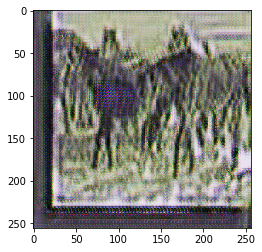

('Epoch 6/20...', 'Discriminator Loss: 0.5864...', 'Generator Loss: 5.6183')
Epoch: 6, Steps: 6020
('Epoch 6/20...', 'Discriminator Loss: 0.3611...', 'Generator Loss: 4.2570')
Epoch: 6, Steps: 6040
('Epoch 6/20...', 'Discriminator Loss: 0.4452...', 'Generator Loss: 4.4388')
Epoch: 6, Steps: 6060
('Epoch 6/20...', 'Discriminator Loss: 0.4932...', 'Generator Loss: 4.6752')
Epoch: 6, Steps: 6080
('Epoch 6/20...', 'Discriminator Loss: 0.4193...', 'Generator Loss: 5.2412')
Epoch: 6, Steps: 6100


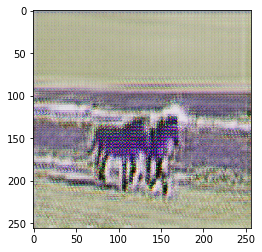

('Epoch 6/20...', 'Discriminator Loss: 0.3410...', 'Generator Loss: 5.2180')
Epoch: 6, Steps: 6120
('Epoch 6/20...', 'Discriminator Loss: 0.4204...', 'Generator Loss: 4.7704')
Epoch: 6, Steps: 6140
('Epoch 6/20...', 'Discriminator Loss: 0.4076...', 'Generator Loss: 5.0339')
Epoch: 6, Steps: 6160
('Epoch 6/20...', 'Discriminator Loss: 0.4371...', 'Generator Loss: 8.4270')
Epoch: 6, Steps: 6180
('Epoch 6/20...', 'Discriminator Loss: 0.2816...', 'Generator Loss: 4.8789')
Epoch: 6, Steps: 6200


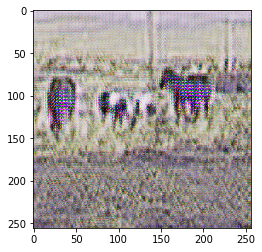

('Epoch 6/20...', 'Discriminator Loss: 0.3645...', 'Generator Loss: 5.5111')
Epoch: 6, Steps: 6220
('Epoch 6/20...', 'Discriminator Loss: 0.3332...', 'Generator Loss: 4.4273')
Epoch: 6, Steps: 6240
('Epoch 6/20...', 'Discriminator Loss: 0.2797...', 'Generator Loss: 10.9842')
Epoch: 6, Steps: 6260
('Epoch 6/20...', 'Discriminator Loss: 0.3722...', 'Generator Loss: 5.8112')
Epoch: 6, Steps: 6280
('Epoch 6/20...', 'Discriminator Loss: 0.6627...', 'Generator Loss: 5.0390')
Epoch: 6, Steps: 6300


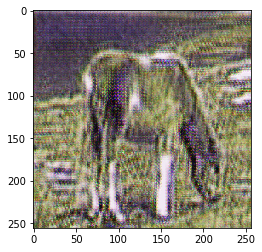

('Epoch 6/20...', 'Discriminator Loss: 0.6624...', 'Generator Loss: 4.4291')
Epoch: 6, Steps: 6320
('Epoch 6/20...', 'Discriminator Loss: 0.5182...', 'Generator Loss: 3.8653')
Epoch: 6, Steps: 6340
('Epoch 6/20...', 'Discriminator Loss: 0.4558...', 'Generator Loss: 5.7529')
Epoch: 6, Steps: 6360
('Epoch 6/20...', 'Discriminator Loss: 0.4848...', 'Generator Loss: 5.0391')
Epoch: 6, Steps: 6380
('Epoch 6/20...', 'Discriminator Loss: 0.3529...', 'Generator Loss: 6.8529')
Epoch: 6, Steps: 6400


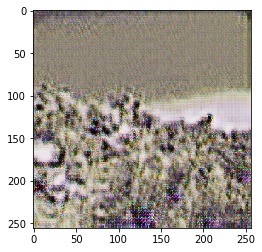

('Epoch 7/20...', 'Discriminator Loss: 0.3095...', 'Generator Loss: 4.5591')
Epoch: 7, Steps: 6420
('Epoch 7/20...', 'Discriminator Loss: 0.2635...', 'Generator Loss: 4.6880')
Epoch: 7, Steps: 6440
('Epoch 7/20...', 'Discriminator Loss: 0.2788...', 'Generator Loss: 4.0766')
Epoch: 7, Steps: 6460
('Epoch 7/20...', 'Discriminator Loss: 0.3776...', 'Generator Loss: 4.9650')
Epoch: 7, Steps: 6480
('Epoch 7/20...', 'Discriminator Loss: 0.6368...', 'Generator Loss: 4.2964')
Epoch: 7, Steps: 6500


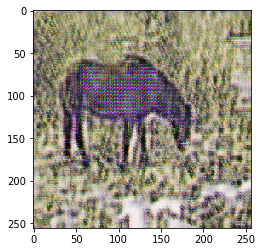

('Epoch 7/20...', 'Discriminator Loss: 0.6218...', 'Generator Loss: 7.1033')
Epoch: 7, Steps: 6520
('Epoch 7/20...', 'Discriminator Loss: 0.4174...', 'Generator Loss: 4.0268')
Epoch: 7, Steps: 6540
('Epoch 7/20...', 'Discriminator Loss: 0.5264...', 'Generator Loss: 4.6271')
Epoch: 7, Steps: 6560
('Epoch 7/20...', 'Discriminator Loss: 0.4958...', 'Generator Loss: 4.9021')
Epoch: 7, Steps: 6580
('Epoch 7/20...', 'Discriminator Loss: 0.4676...', 'Generator Loss: 4.3044')
Epoch: 7, Steps: 6600


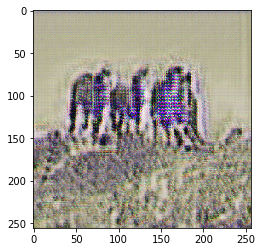

('Epoch 7/20...', 'Discriminator Loss: 0.3640...', 'Generator Loss: 5.5737')
Epoch: 7, Steps: 6620
('Epoch 7/20...', 'Discriminator Loss: 0.3633...', 'Generator Loss: 5.8061')
Epoch: 7, Steps: 6640
('Epoch 7/20...', 'Discriminator Loss: 0.5828...', 'Generator Loss: 4.1649')
Epoch: 7, Steps: 6660
('Epoch 7/20...', 'Discriminator Loss: 0.4253...', 'Generator Loss: 3.5985')
Epoch: 7, Steps: 6680
('Epoch 7/20...', 'Discriminator Loss: 0.3986...', 'Generator Loss: 5.8399')
Epoch: 7, Steps: 6700


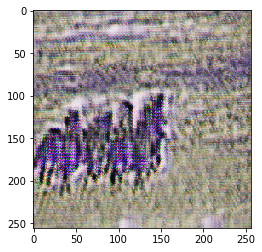

('Epoch 7/20...', 'Discriminator Loss: 0.3741...', 'Generator Loss: 5.9884')
Epoch: 7, Steps: 6720
('Epoch 7/20...', 'Discriminator Loss: 0.3792...', 'Generator Loss: 4.2590')
Epoch: 7, Steps: 6740
('Epoch 7/20...', 'Discriminator Loss: 0.4281...', 'Generator Loss: 4.6343')
Epoch: 7, Steps: 6760
('Epoch 7/20...', 'Discriminator Loss: 0.3172...', 'Generator Loss: 4.6379')
Epoch: 7, Steps: 6780
('Epoch 7/20...', 'Discriminator Loss: 0.3658...', 'Generator Loss: 4.2727')
Epoch: 7, Steps: 6800


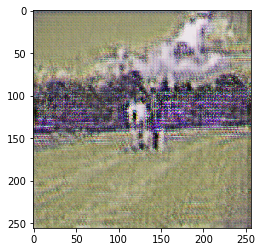

('Epoch 7/20...', 'Discriminator Loss: 0.2746...', 'Generator Loss: 5.1430')
Epoch: 7, Steps: 6820
('Epoch 7/20...', 'Discriminator Loss: 0.5101...', 'Generator Loss: 4.1610')
Epoch: 7, Steps: 6840
('Epoch 7/20...', 'Discriminator Loss: 0.5013...', 'Generator Loss: 4.4306')
Epoch: 7, Steps: 6860
('Epoch 7/20...', 'Discriminator Loss: 0.1685...', 'Generator Loss: 4.7628')
Epoch: 7, Steps: 6880
('Epoch 7/20...', 'Discriminator Loss: 0.3517...', 'Generator Loss: 4.0494')
Epoch: 7, Steps: 6900


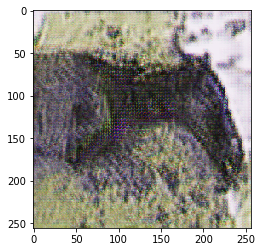

('Epoch 7/20...', 'Discriminator Loss: 0.5604...', 'Generator Loss: 6.0294')
Epoch: 7, Steps: 6920
('Epoch 7/20...', 'Discriminator Loss: 0.5504...', 'Generator Loss: 5.3915')
Epoch: 7, Steps: 6940
('Epoch 7/20...', 'Discriminator Loss: 0.1530...', 'Generator Loss: 5.8534')
Epoch: 7, Steps: 6960
('Epoch 7/20...', 'Discriminator Loss: 0.5856...', 'Generator Loss: 4.9891')
Epoch: 7, Steps: 6980
('Epoch 7/20...', 'Discriminator Loss: 0.4541...', 'Generator Loss: 5.2271')
Epoch: 7, Steps: 7000


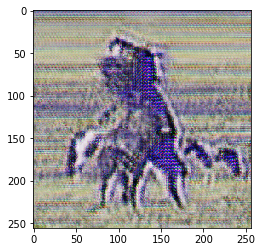

('Epoch 7/20...', 'Discriminator Loss: 0.4884...', 'Generator Loss: 7.0020')
Epoch: 7, Steps: 7020
('Epoch 7/20...', 'Discriminator Loss: 0.6565...', 'Generator Loss: 4.4017')
Epoch: 7, Steps: 7040
('Epoch 7/20...', 'Discriminator Loss: 0.5026...', 'Generator Loss: 4.4644')
Epoch: 7, Steps: 7060
('Epoch 7/20...', 'Discriminator Loss: 0.3814...', 'Generator Loss: 4.7751')
Epoch: 7, Steps: 7080
('Epoch 7/20...', 'Discriminator Loss: 0.5231...', 'Generator Loss: 5.3666')
Epoch: 7, Steps: 7100


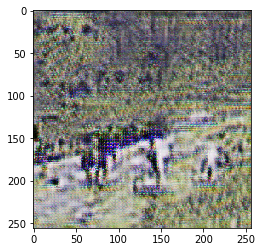

('Epoch 7/20...', 'Discriminator Loss: 0.4294...', 'Generator Loss: 4.7458')
Epoch: 7, Steps: 7120
('Epoch 7/20...', 'Discriminator Loss: 0.4236...', 'Generator Loss: 3.9384')
Epoch: 7, Steps: 7140
('Epoch 7/20...', 'Discriminator Loss: 0.5750...', 'Generator Loss: 5.3535')
Epoch: 7, Steps: 7160
('Epoch 7/20...', 'Discriminator Loss: 0.3828...', 'Generator Loss: 5.2022')
Epoch: 7, Steps: 7180
('Epoch 7/20...', 'Discriminator Loss: 0.3383...', 'Generator Loss: 6.4560')
Epoch: 7, Steps: 7200


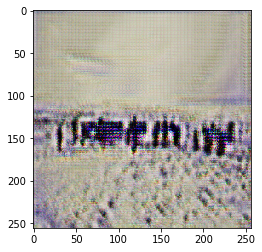

('Epoch 7/20...', 'Discriminator Loss: 0.4445...', 'Generator Loss: 3.7912')
Epoch: 7, Steps: 7220
('Epoch 7/20...', 'Discriminator Loss: 0.4712...', 'Generator Loss: 4.4323')
Epoch: 7, Steps: 7240
('Epoch 7/20...', 'Discriminator Loss: 0.6049...', 'Generator Loss: 4.3244')
Epoch: 7, Steps: 7260
('Epoch 7/20...', 'Discriminator Loss: 0.5356...', 'Generator Loss: 4.8181')
Epoch: 7, Steps: 7280
('Epoch 7/20...', 'Discriminator Loss: 0.5347...', 'Generator Loss: 4.8391')
Epoch: 7, Steps: 7300


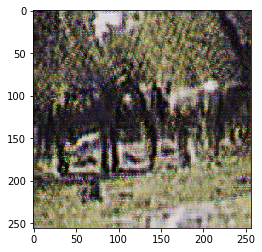

('Epoch 7/20...', 'Discriminator Loss: 0.4601...', 'Generator Loss: 5.0228')
Epoch: 7, Steps: 7320
('Epoch 7/20...', 'Discriminator Loss: 0.2667...', 'Generator Loss: 4.3342')
Epoch: 7, Steps: 7340
('Epoch 7/20...', 'Discriminator Loss: 0.4320...', 'Generator Loss: 5.0522')
Epoch: 7, Steps: 7360
('Epoch 7/20...', 'Discriminator Loss: 0.3024...', 'Generator Loss: 5.0958')
Epoch: 7, Steps: 7380
('Epoch 7/20...', 'Discriminator Loss: 0.3661...', 'Generator Loss: 4.7203')
Epoch: 7, Steps: 7400


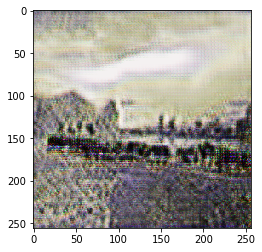

('Epoch 7/20...', 'Discriminator Loss: 0.4650...', 'Generator Loss: 5.6974')
Epoch: 7, Steps: 7420
('Epoch 7/20...', 'Discriminator Loss: 0.4092...', 'Generator Loss: 5.6048')
Epoch: 7, Steps: 7440
('Epoch 7/20...', 'Discriminator Loss: 0.3062...', 'Generator Loss: 4.2632')
Epoch: 7, Steps: 7460
('Epoch 8/20...', 'Discriminator Loss: 0.3605...', 'Generator Loss: 5.6110')
Epoch: 8, Steps: 7480
('Epoch 8/20...', 'Discriminator Loss: 0.8039...', 'Generator Loss: 4.8548')
Epoch: 8, Steps: 7500


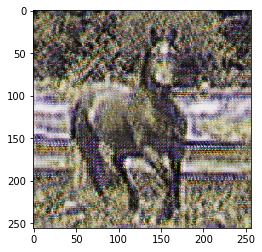

('Epoch 8/20...', 'Discriminator Loss: 0.3695...', 'Generator Loss: 4.0000')
Epoch: 8, Steps: 7520
('Epoch 8/20...', 'Discriminator Loss: 0.3932...', 'Generator Loss: 5.0859')
Epoch: 8, Steps: 7540
('Epoch 8/20...', 'Discriminator Loss: 0.3790...', 'Generator Loss: 4.6951')
Epoch: 8, Steps: 7560
('Epoch 8/20...', 'Discriminator Loss: 0.4083...', 'Generator Loss: 5.1928')
Epoch: 8, Steps: 7580
('Epoch 8/20...', 'Discriminator Loss: 0.5953...', 'Generator Loss: 4.8425')
Epoch: 8, Steps: 7600


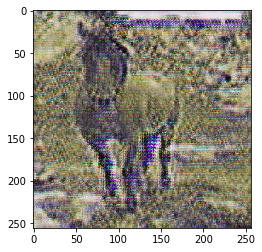

('Epoch 8/20...', 'Discriminator Loss: 0.3990...', 'Generator Loss: 4.6141')
Epoch: 8, Steps: 7620
('Epoch 8/20...', 'Discriminator Loss: 0.5061...', 'Generator Loss: 4.4118')
Epoch: 8, Steps: 7640
('Epoch 8/20...', 'Discriminator Loss: 0.3579...', 'Generator Loss: 5.7419')
Epoch: 8, Steps: 7660
('Epoch 8/20...', 'Discriminator Loss: 0.4872...', 'Generator Loss: 4.1902')
Epoch: 8, Steps: 7680
('Epoch 8/20...', 'Discriminator Loss: 0.2313...', 'Generator Loss: 5.6895')
Epoch: 8, Steps: 7700


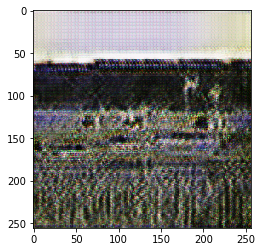

('Epoch 8/20...', 'Discriminator Loss: 0.5381...', 'Generator Loss: 4.3747')
Epoch: 8, Steps: 7720
('Epoch 8/20...', 'Discriminator Loss: 0.5716...', 'Generator Loss: 4.1246')
Epoch: 8, Steps: 7740
('Epoch 8/20...', 'Discriminator Loss: 0.3527...', 'Generator Loss: 3.8678')
Epoch: 8, Steps: 7760
('Epoch 8/20...', 'Discriminator Loss: 0.7471...', 'Generator Loss: 3.8442')
Epoch: 8, Steps: 7780
('Epoch 8/20...', 'Discriminator Loss: 0.3519...', 'Generator Loss: 4.2060')
Epoch: 8, Steps: 7800


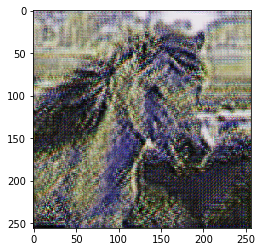

('Epoch 8/20...', 'Discriminator Loss: 0.4587...', 'Generator Loss: 4.5010')
Epoch: 8, Steps: 7820
('Epoch 8/20...', 'Discriminator Loss: 0.3477...', 'Generator Loss: 4.3835')
Epoch: 8, Steps: 7840
('Epoch 8/20...', 'Discriminator Loss: 0.3762...', 'Generator Loss: 5.5457')
Epoch: 8, Steps: 7860
('Epoch 8/20...', 'Discriminator Loss: 0.5022...', 'Generator Loss: 4.7162')
Epoch: 8, Steps: 7880
('Epoch 8/20...', 'Discriminator Loss: 0.2066...', 'Generator Loss: 5.3576')
Epoch: 8, Steps: 7900


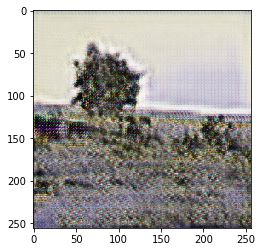

('Epoch 8/20...', 'Discriminator Loss: 0.3638...', 'Generator Loss: 4.2643')
Epoch: 8, Steps: 7920
('Epoch 8/20...', 'Discriminator Loss: 0.4448...', 'Generator Loss: 4.7847')
Epoch: 8, Steps: 7940
('Epoch 8/20...', 'Discriminator Loss: 0.3936...', 'Generator Loss: 3.9891')
Epoch: 8, Steps: 7960
('Epoch 8/20...', 'Discriminator Loss: 0.3162...', 'Generator Loss: 4.6778')
Epoch: 8, Steps: 7980
('Epoch 8/20...', 'Discriminator Loss: 0.3471...', 'Generator Loss: 6.3331')
Epoch: 8, Steps: 8000


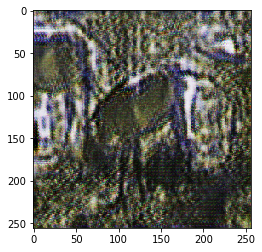

('Epoch 8/20...', 'Discriminator Loss: 0.4471...', 'Generator Loss: 4.1574')
Epoch: 8, Steps: 8020
('Epoch 8/20...', 'Discriminator Loss: 0.5163...', 'Generator Loss: 4.6119')
Epoch: 8, Steps: 8040
('Epoch 8/20...', 'Discriminator Loss: 0.4185...', 'Generator Loss: 5.2529')
Epoch: 8, Steps: 8060
('Epoch 8/20...', 'Discriminator Loss: 0.3421...', 'Generator Loss: 6.2820')
Epoch: 8, Steps: 8080
('Epoch 8/20...', 'Discriminator Loss: 0.3767...', 'Generator Loss: 4.1118')
Epoch: 8, Steps: 8100


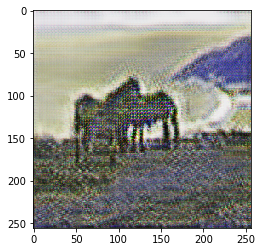

('Epoch 8/20...', 'Discriminator Loss: 0.3563...', 'Generator Loss: 5.5350')
Epoch: 8, Steps: 8120
('Epoch 8/20...', 'Discriminator Loss: 0.4087...', 'Generator Loss: 5.0869')
Epoch: 8, Steps: 8140
('Epoch 8/20...', 'Discriminator Loss: 0.2974...', 'Generator Loss: 5.2875')
Epoch: 8, Steps: 8160
('Epoch 8/20...', 'Discriminator Loss: 0.2535...', 'Generator Loss: 3.8715')
Epoch: 8, Steps: 8180
('Epoch 8/20...', 'Discriminator Loss: 0.5002...', 'Generator Loss: 4.6887')
Epoch: 8, Steps: 8200


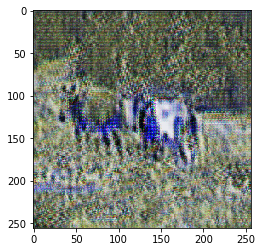

('Epoch 8/20...', 'Discriminator Loss: 0.5338...', 'Generator Loss: 7.9086')
Epoch: 8, Steps: 8220
('Epoch 8/20...', 'Discriminator Loss: 0.3267...', 'Generator Loss: 4.1363')
Epoch: 8, Steps: 8240
('Epoch 8/20...', 'Discriminator Loss: 0.4370...', 'Generator Loss: 5.6486')
Epoch: 8, Steps: 8260
('Epoch 8/20...', 'Discriminator Loss: 0.4436...', 'Generator Loss: 3.7969')
Epoch: 8, Steps: 8280
('Epoch 8/20...', 'Discriminator Loss: 0.4258...', 'Generator Loss: 5.8571')
Epoch: 8, Steps: 8300


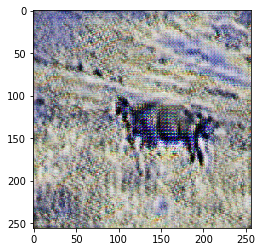

('Epoch 8/20...', 'Discriminator Loss: 0.2979...', 'Generator Loss: 5.3427')
Epoch: 8, Steps: 8320
('Epoch 8/20...', 'Discriminator Loss: 0.3835...', 'Generator Loss: 4.7383')
Epoch: 8, Steps: 8340
('Epoch 8/20...', 'Discriminator Loss: 0.5780...', 'Generator Loss: 3.7865')
Epoch: 8, Steps: 8360
('Epoch 8/20...', 'Discriminator Loss: 0.4164...', 'Generator Loss: 4.6632')
Epoch: 8, Steps: 8380
('Epoch 8/20...', 'Discriminator Loss: 0.5167...', 'Generator Loss: 4.5588')
Epoch: 8, Steps: 8400


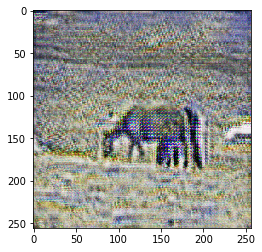

('Epoch 8/20...', 'Discriminator Loss: 0.4788...', 'Generator Loss: 4.4557')
Epoch: 8, Steps: 8420
('Epoch 8/20...', 'Discriminator Loss: 0.3797...', 'Generator Loss: 4.7553')
Epoch: 8, Steps: 8440
('Epoch 8/20...', 'Discriminator Loss: 0.4922...', 'Generator Loss: 4.9101')
Epoch: 8, Steps: 8460
('Epoch 8/20...', 'Discriminator Loss: 0.3640...', 'Generator Loss: 4.3688')
Epoch: 8, Steps: 8480
('Epoch 8/20...', 'Discriminator Loss: 0.5166...', 'Generator Loss: 4.3917')
Epoch: 8, Steps: 8500


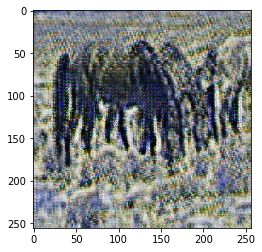

('Epoch 8/20...', 'Discriminator Loss: 0.2295...', 'Generator Loss: 5.1840')
Epoch: 8, Steps: 8520
('Epoch 9/20...', 'Discriminator Loss: 0.2053...', 'Generator Loss: 5.0851')
Epoch: 9, Steps: 8540
('Epoch 9/20...', 'Discriminator Loss: 0.3739...', 'Generator Loss: 4.6033')
Epoch: 9, Steps: 8560
('Epoch 9/20...', 'Discriminator Loss: 0.4977...', 'Generator Loss: 4.8566')
Epoch: 9, Steps: 8580
('Epoch 9/20...', 'Discriminator Loss: 0.2698...', 'Generator Loss: 5.6667')
Epoch: 9, Steps: 8600


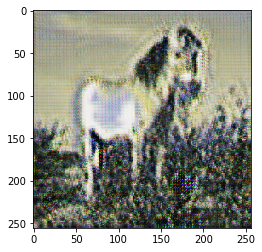

('Epoch 9/20...', 'Discriminator Loss: 0.4343...', 'Generator Loss: 4.3286')
Epoch: 9, Steps: 8620
('Epoch 9/20...', 'Discriminator Loss: 0.5712...', 'Generator Loss: 4.3481')
Epoch: 9, Steps: 8640
('Epoch 9/20...', 'Discriminator Loss: 0.4647...', 'Generator Loss: 3.8502')
Epoch: 9, Steps: 8660
('Epoch 9/20...', 'Discriminator Loss: 0.4496...', 'Generator Loss: 4.5903')
Epoch: 9, Steps: 8680
('Epoch 9/20...', 'Discriminator Loss: 0.3031...', 'Generator Loss: 5.8978')
Epoch: 9, Steps: 8700


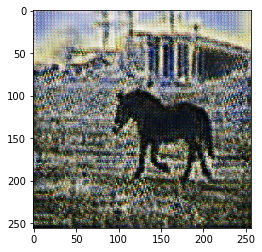

('Epoch 9/20...', 'Discriminator Loss: 0.3049...', 'Generator Loss: 3.8892')
Epoch: 9, Steps: 8720
('Epoch 9/20...', 'Discriminator Loss: 0.3703...', 'Generator Loss: 4.2251')
Epoch: 9, Steps: 8740
('Epoch 9/20...', 'Discriminator Loss: 0.5570...', 'Generator Loss: 5.1854')
Epoch: 9, Steps: 8760
('Epoch 9/20...', 'Discriminator Loss: 0.5360...', 'Generator Loss: 4.4047')
Epoch: 9, Steps: 8780
('Epoch 9/20...', 'Discriminator Loss: 0.4573...', 'Generator Loss: 4.5447')
Epoch: 9, Steps: 8800


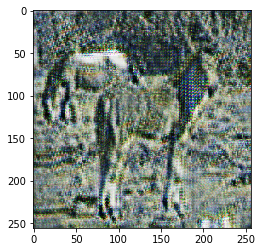

('Epoch 9/20...', 'Discriminator Loss: 0.4528...', 'Generator Loss: 5.3163')
Epoch: 9, Steps: 8820
('Epoch 9/20...', 'Discriminator Loss: 0.5594...', 'Generator Loss: 5.6374')
Epoch: 9, Steps: 8840
('Epoch 9/20...', 'Discriminator Loss: 0.4845...', 'Generator Loss: 4.1002')
Epoch: 9, Steps: 8860
('Epoch 9/20...', 'Discriminator Loss: 0.4686...', 'Generator Loss: 3.8970')
Epoch: 9, Steps: 8880
('Epoch 9/20...', 'Discriminator Loss: 0.4165...', 'Generator Loss: 6.6514')
Epoch: 9, Steps: 8900


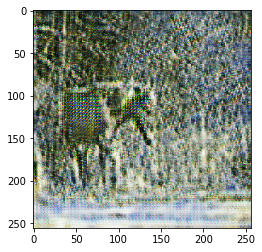

('Epoch 9/20...', 'Discriminator Loss: 0.4107...', 'Generator Loss: 3.9046')
Epoch: 9, Steps: 8920
('Epoch 9/20...', 'Discriminator Loss: 0.6274...', 'Generator Loss: 4.3962')
Epoch: 9, Steps: 8940
('Epoch 9/20...', 'Discriminator Loss: 0.4156...', 'Generator Loss: 4.3174')
Epoch: 9, Steps: 8960
('Epoch 9/20...', 'Discriminator Loss: 0.3420...', 'Generator Loss: 6.8875')
Epoch: 9, Steps: 8980
('Epoch 9/20...', 'Discriminator Loss: 0.3453...', 'Generator Loss: 5.7556')
Epoch: 9, Steps: 9000


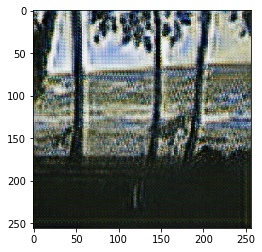

('Epoch 9/20...', 'Discriminator Loss: 0.4681...', 'Generator Loss: 3.5707')
Epoch: 9, Steps: 9020
('Epoch 9/20...', 'Discriminator Loss: 0.3966...', 'Generator Loss: 5.5886')
Epoch: 9, Steps: 9040
('Epoch 9/20...', 'Discriminator Loss: 0.4730...', 'Generator Loss: 4.3048')
Epoch: 9, Steps: 9060
('Epoch 9/20...', 'Discriminator Loss: 0.4608...', 'Generator Loss: 4.7548')
Epoch: 9, Steps: 9080
('Epoch 9/20...', 'Discriminator Loss: 0.4606...', 'Generator Loss: 3.8371')
Epoch: 9, Steps: 9100


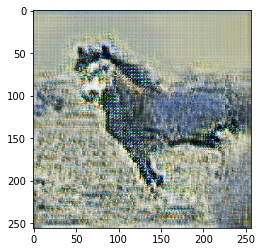

('Epoch 9/20...', 'Discriminator Loss: 0.3594...', 'Generator Loss: 4.5204')
Epoch: 9, Steps: 9120
('Epoch 9/20...', 'Discriminator Loss: 0.2914...', 'Generator Loss: 4.5085')
Epoch: 9, Steps: 9140
('Epoch 9/20...', 'Discriminator Loss: 0.3061...', 'Generator Loss: 5.6226')
Epoch: 9, Steps: 9160
('Epoch 9/20...', 'Discriminator Loss: 0.2585...', 'Generator Loss: 5.2055')
Epoch: 9, Steps: 9180
('Epoch 9/20...', 'Discriminator Loss: 0.3510...', 'Generator Loss: 4.1151')
Epoch: 9, Steps: 9200


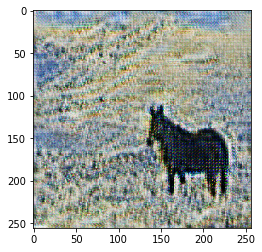

('Epoch 9/20...', 'Discriminator Loss: 0.4883...', 'Generator Loss: 4.0184')
Epoch: 9, Steps: 9220
('Epoch 9/20...', 'Discriminator Loss: 0.4655...', 'Generator Loss: 6.1380')
Epoch: 9, Steps: 9240
('Epoch 9/20...', 'Discriminator Loss: 0.3692...', 'Generator Loss: 4.4913')
Epoch: 9, Steps: 9260
('Epoch 9/20...', 'Discriminator Loss: 0.4785...', 'Generator Loss: 4.2602')
Epoch: 9, Steps: 9280
('Epoch 9/20...', 'Discriminator Loss: 0.4770...', 'Generator Loss: 4.6010')
Epoch: 9, Steps: 9300


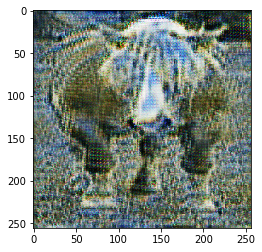

('Epoch 9/20...', 'Discriminator Loss: 0.4828...', 'Generator Loss: 4.4667')
Epoch: 9, Steps: 9320
('Epoch 9/20...', 'Discriminator Loss: 0.5607...', 'Generator Loss: 3.6637')
Epoch: 9, Steps: 9340
('Epoch 9/20...', 'Discriminator Loss: 0.4963...', 'Generator Loss: 4.1932')
Epoch: 9, Steps: 9360
('Epoch 9/20...', 'Discriminator Loss: 0.4828...', 'Generator Loss: 6.0029')
Epoch: 9, Steps: 9380
('Epoch 9/20...', 'Discriminator Loss: 0.4671...', 'Generator Loss: 4.6211')
Epoch: 9, Steps: 9400


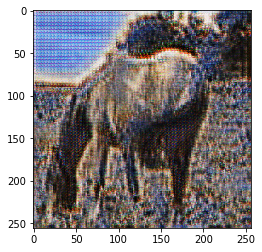

('Epoch 9/20...', 'Discriminator Loss: 0.6047...', 'Generator Loss: 4.6110')
Epoch: 9, Steps: 9420
('Epoch 9/20...', 'Discriminator Loss: 0.3152...', 'Generator Loss: 8.1115')
Epoch: 9, Steps: 9440
('Epoch 9/20...', 'Discriminator Loss: 0.4281...', 'Generator Loss: 4.7827')
Epoch: 9, Steps: 9460
('Epoch 9/20...', 'Discriminator Loss: 0.3188...', 'Generator Loss: 3.9921')
Epoch: 9, Steps: 9480
('Epoch 9/20...', 'Discriminator Loss: 0.5143...', 'Generator Loss: 3.9219')
Epoch: 9, Steps: 9500


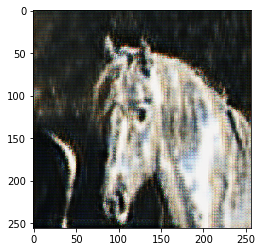

('Epoch 9/20...', 'Discriminator Loss: 0.3107...', 'Generator Loss: 4.8955')
Epoch: 9, Steps: 9520
('Epoch 9/20...', 'Discriminator Loss: 0.2911...', 'Generator Loss: 6.6174')
Epoch: 9, Steps: 9540
('Epoch 9/20...', 'Discriminator Loss: 0.4571...', 'Generator Loss: 4.5292')
Epoch: 9, Steps: 9560
('Epoch 9/20...', 'Discriminator Loss: 0.3062...', 'Generator Loss: 6.3143')
Epoch: 9, Steps: 9580
('Epoch 9/20...', 'Discriminator Loss: 0.3866...', 'Generator Loss: 4.6950')
Epoch: 9, Steps: 9600


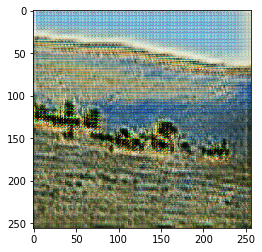

('Epoch 10/20...', 'Discriminator Loss: 0.2896...', 'Generator Loss: 4.6440')
Epoch: 10, Steps: 9620
('Epoch 10/20...', 'Discriminator Loss: 0.5087...', 'Generator Loss: 4.8296')
Epoch: 10, Steps: 9640
('Epoch 10/20...', 'Discriminator Loss: 0.3982...', 'Generator Loss: 5.3765')
Epoch: 10, Steps: 9660
('Epoch 10/20...', 'Discriminator Loss: 0.3420...', 'Generator Loss: 5.9687')
Epoch: 10, Steps: 9680
('Epoch 10/20...', 'Discriminator Loss: 0.2734...', 'Generator Loss: 5.4953')
Epoch: 10, Steps: 9700


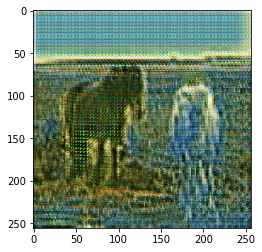

('Epoch 10/20...', 'Discriminator Loss: 0.4526...', 'Generator Loss: 4.8119')
Epoch: 10, Steps: 9720
('Epoch 10/20...', 'Discriminator Loss: 0.4296...', 'Generator Loss: 4.1426')
Epoch: 10, Steps: 9740
('Epoch 10/20...', 'Discriminator Loss: 0.4551...', 'Generator Loss: 4.8898')
Epoch: 10, Steps: 9760
('Epoch 10/20...', 'Discriminator Loss: 0.3677...', 'Generator Loss: 4.9452')
Epoch: 10, Steps: 9780
('Epoch 10/20...', 'Discriminator Loss: 0.3410...', 'Generator Loss: 7.1743')
Epoch: 10, Steps: 9800


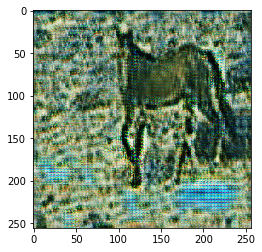

('Epoch 10/20...', 'Discriminator Loss: 0.4159...', 'Generator Loss: 6.3554')
Epoch: 10, Steps: 9820
('Epoch 10/20...', 'Discriminator Loss: 0.5425...', 'Generator Loss: 4.4722')
Epoch: 10, Steps: 9840
('Epoch 10/20...', 'Discriminator Loss: 0.3462...', 'Generator Loss: 4.1484')
Epoch: 10, Steps: 9860
('Epoch 10/20...', 'Discriminator Loss: 0.3922...', 'Generator Loss: 4.6338')
Epoch: 10, Steps: 9880
('Epoch 10/20...', 'Discriminator Loss: 0.5175...', 'Generator Loss: 4.3380')
Epoch: 10, Steps: 9900


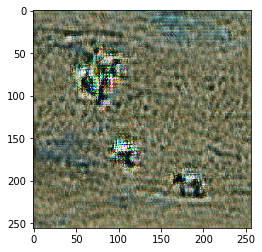

('Epoch 10/20...', 'Discriminator Loss: 0.3869...', 'Generator Loss: 3.8798')
Epoch: 10, Steps: 9920
('Epoch 10/20...', 'Discriminator Loss: 0.4104...', 'Generator Loss: 5.2805')
Epoch: 10, Steps: 9940
('Epoch 10/20...', 'Discriminator Loss: 0.4580...', 'Generator Loss: 4.9578')
Epoch: 10, Steps: 9960
('Epoch 10/20...', 'Discriminator Loss: 0.3600...', 'Generator Loss: 4.9305')
Epoch: 10, Steps: 9980
('Epoch 10/20...', 'Discriminator Loss: 0.4311...', 'Generator Loss: 4.5262')
Epoch: 10, Steps: 10000


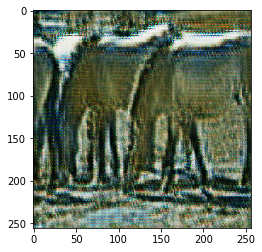

('Epoch 10/20...', 'Discriminator Loss: 0.2241...', 'Generator Loss: 5.4713')
Epoch: 10, Steps: 10020
('Epoch 10/20...', 'Discriminator Loss: 0.3406...', 'Generator Loss: 5.3561')
Epoch: 10, Steps: 10040
('Epoch 10/20...', 'Discriminator Loss: 0.3548...', 'Generator Loss: 5.3318')
Epoch: 10, Steps: 10060
('Epoch 10/20...', 'Discriminator Loss: 0.3952...', 'Generator Loss: 4.1661')
Epoch: 10, Steps: 10080
('Epoch 10/20...', 'Discriminator Loss: 0.5129...', 'Generator Loss: 5.0051')
Epoch: 10, Steps: 10100


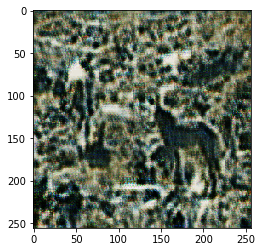

('Epoch 10/20...', 'Discriminator Loss: 0.3458...', 'Generator Loss: 3.8762')
Epoch: 10, Steps: 10120
('Epoch 10/20...', 'Discriminator Loss: 0.3618...', 'Generator Loss: 5.4674')
Epoch: 10, Steps: 10140
('Epoch 10/20...', 'Discriminator Loss: 0.5124...', 'Generator Loss: 5.1766')
Epoch: 10, Steps: 10160
('Epoch 10/20...', 'Discriminator Loss: 0.5270...', 'Generator Loss: 5.5865')
Epoch: 10, Steps: 10180
('Epoch 10/20...', 'Discriminator Loss: 0.5662...', 'Generator Loss: 4.0844')
Epoch: 10, Steps: 10200


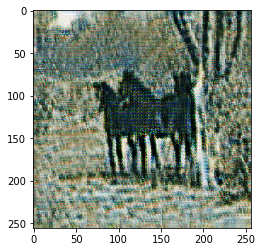

('Epoch 10/20...', 'Discriminator Loss: 0.4335...', 'Generator Loss: 3.6646')
Epoch: 10, Steps: 10220
('Epoch 10/20...', 'Discriminator Loss: 0.3927...', 'Generator Loss: 4.6655')
Epoch: 10, Steps: 10240
('Epoch 10/20...', 'Discriminator Loss: 0.5060...', 'Generator Loss: 4.9785')
Epoch: 10, Steps: 10260
('Epoch 10/20...', 'Discriminator Loss: 0.5504...', 'Generator Loss: 4.7259')
Epoch: 10, Steps: 10280
('Epoch 10/20...', 'Discriminator Loss: 0.2723...', 'Generator Loss: 3.8006')
Epoch: 10, Steps: 10300


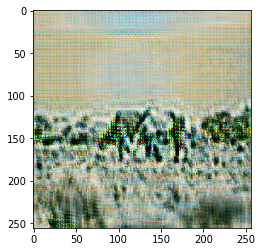

('Epoch 10/20...', 'Discriminator Loss: 0.3996...', 'Generator Loss: 4.7572')
Epoch: 10, Steps: 10320
('Epoch 10/20...', 'Discriminator Loss: 0.6119...', 'Generator Loss: 4.5243')
Epoch: 10, Steps: 10340
('Epoch 10/20...', 'Discriminator Loss: 0.3570...', 'Generator Loss: 4.0946')
Epoch: 10, Steps: 10360
('Epoch 10/20...', 'Discriminator Loss: 0.4123...', 'Generator Loss: 4.8793')
Epoch: 10, Steps: 10380
('Epoch 10/20...', 'Discriminator Loss: 0.3797...', 'Generator Loss: 4.4402')
Epoch: 10, Steps: 10400


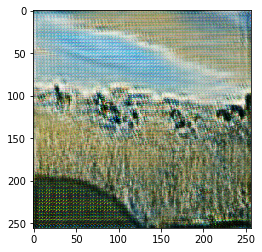

('Epoch 10/20...', 'Discriminator Loss: 0.4213...', 'Generator Loss: 5.0075')
Epoch: 10, Steps: 10420
('Epoch 10/20...', 'Discriminator Loss: 0.3227...', 'Generator Loss: 4.9831')
Epoch: 10, Steps: 10440
('Epoch 10/20...', 'Discriminator Loss: 0.4763...', 'Generator Loss: 4.6418')
Epoch: 10, Steps: 10460
('Epoch 10/20...', 'Discriminator Loss: 0.4503...', 'Generator Loss: 4.2552')
Epoch: 10, Steps: 10480
('Epoch 10/20...', 'Discriminator Loss: 0.5368...', 'Generator Loss: 3.9969')
Epoch: 10, Steps: 10500


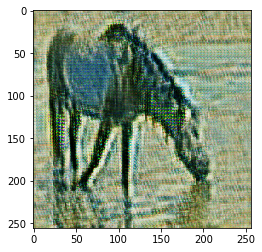

('Epoch 10/20...', 'Discriminator Loss: 0.3832...', 'Generator Loss: 4.7515')
Epoch: 10, Steps: 10520
('Epoch 10/20...', 'Discriminator Loss: 0.4841...', 'Generator Loss: 5.1648')
Epoch: 10, Steps: 10540
('Epoch 10/20...', 'Discriminator Loss: 0.3618...', 'Generator Loss: 4.3688')
Epoch: 10, Steps: 10560
('Epoch 10/20...', 'Discriminator Loss: 0.4520...', 'Generator Loss: 5.4597')
Epoch: 10, Steps: 10580
('Epoch 10/20...', 'Discriminator Loss: 0.2900...', 'Generator Loss: 4.4729')
Epoch: 10, Steps: 10600


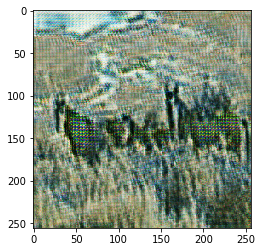

('Epoch 10/20...', 'Discriminator Loss: 0.6144...', 'Generator Loss: 4.1358')
Epoch: 10, Steps: 10620
('Epoch 10/20...', 'Discriminator Loss: 0.4513...', 'Generator Loss: 4.2509')
Epoch: 10, Steps: 10640
('Epoch 10/20...', 'Discriminator Loss: 0.4053...', 'Generator Loss: 6.7351')
Epoch: 10, Steps: 10660
('Epoch 11/20...', 'Discriminator Loss: 0.3629...', 'Generator Loss: 6.7761')
Epoch: 11, Steps: 10680
('Epoch 11/20...', 'Discriminator Loss: 0.2209...', 'Generator Loss: 4.6547')
Epoch: 11, Steps: 10700


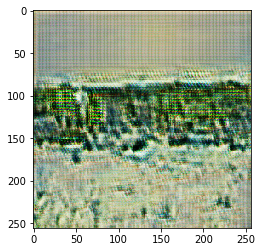

('Epoch 11/20...', 'Discriminator Loss: 0.3459...', 'Generator Loss: 3.7010')
Epoch: 11, Steps: 10720
('Epoch 11/20...', 'Discriminator Loss: 0.3578...', 'Generator Loss: 4.8289')
Epoch: 11, Steps: 10740
('Epoch 11/20...', 'Discriminator Loss: 0.5527...', 'Generator Loss: 5.2088')
Epoch: 11, Steps: 10760
('Epoch 11/20...', 'Discriminator Loss: 0.4841...', 'Generator Loss: 4.6155')
Epoch: 11, Steps: 10780
('Epoch 11/20...', 'Discriminator Loss: 0.5306...', 'Generator Loss: 3.1386')
Epoch: 11, Steps: 10800


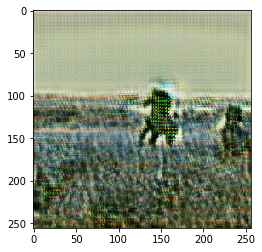

('Epoch 11/20...', 'Discriminator Loss: 0.4560...', 'Generator Loss: 4.3466')
Epoch: 11, Steps: 10820
('Epoch 11/20...', 'Discriminator Loss: 0.3953...', 'Generator Loss: 5.1432')
Epoch: 11, Steps: 10840
('Epoch 11/20...', 'Discriminator Loss: 0.3975...', 'Generator Loss: 4.8316')
Epoch: 11, Steps: 10860
('Epoch 11/20...', 'Discriminator Loss: 0.5360...', 'Generator Loss: 4.4576')
Epoch: 11, Steps: 10880
('Epoch 11/20...', 'Discriminator Loss: 0.5705...', 'Generator Loss: 3.8272')
Epoch: 11, Steps: 10900


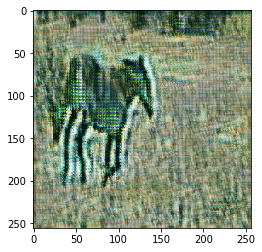

('Epoch 11/20...', 'Discriminator Loss: 0.4352...', 'Generator Loss: 3.9175')
Epoch: 11, Steps: 10920
('Epoch 11/20...', 'Discriminator Loss: 0.4386...', 'Generator Loss: 4.8966')
Epoch: 11, Steps: 10940
('Epoch 11/20...', 'Discriminator Loss: 0.3940...', 'Generator Loss: 5.1964')
Epoch: 11, Steps: 10960
('Epoch 11/20...', 'Discriminator Loss: 0.5120...', 'Generator Loss: 3.9555')
Epoch: 11, Steps: 10980
('Epoch 11/20...', 'Discriminator Loss: 0.4912...', 'Generator Loss: 5.4401')
Epoch: 11, Steps: 11000


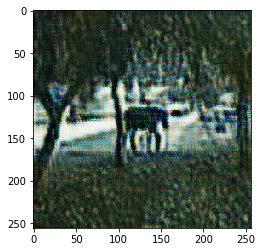

('Epoch 11/20...', 'Discriminator Loss: 0.2878...', 'Generator Loss: 4.6874')
Epoch: 11, Steps: 11020
('Epoch 11/20...', 'Discriminator Loss: 0.5022...', 'Generator Loss: 4.5985')
Epoch: 11, Steps: 11040
('Epoch 11/20...', 'Discriminator Loss: 0.4870...', 'Generator Loss: 4.1740')
Epoch: 11, Steps: 11060
('Epoch 11/20...', 'Discriminator Loss: 0.3531...', 'Generator Loss: 4.0952')
Epoch: 11, Steps: 11080
('Epoch 11/20...', 'Discriminator Loss: 0.3551...', 'Generator Loss: 4.9687')
Epoch: 11, Steps: 11100


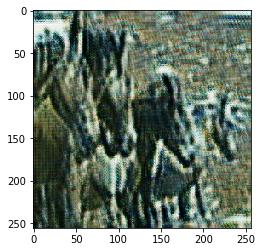

('Epoch 11/20...', 'Discriminator Loss: 0.3910...', 'Generator Loss: 4.1133')
Epoch: 11, Steps: 11120
('Epoch 11/20...', 'Discriminator Loss: 0.3665...', 'Generator Loss: 4.2368')
Epoch: 11, Steps: 11140
('Epoch 11/20...', 'Discriminator Loss: 0.4210...', 'Generator Loss: 6.5198')
Epoch: 11, Steps: 11160
('Epoch 11/20...', 'Discriminator Loss: 0.5807...', 'Generator Loss: 5.2962')
Epoch: 11, Steps: 11180
('Epoch 11/20...', 'Discriminator Loss: 0.4214...', 'Generator Loss: 5.1576')
Epoch: 11, Steps: 11200


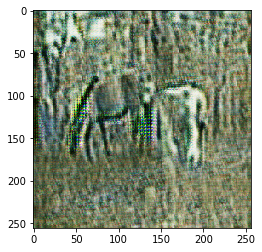

('Epoch 11/20...', 'Discriminator Loss: 0.4251...', 'Generator Loss: 4.9414')
Epoch: 11, Steps: 11220
('Epoch 11/20...', 'Discriminator Loss: 0.2370...', 'Generator Loss: 4.6659')
Epoch: 11, Steps: 11240
('Epoch 11/20...', 'Discriminator Loss: 0.3956...', 'Generator Loss: 4.5935')
Epoch: 11, Steps: 11260
('Epoch 11/20...', 'Discriminator Loss: 0.5177...', 'Generator Loss: 3.9571')
Epoch: 11, Steps: 11280
('Epoch 11/20...', 'Discriminator Loss: 0.5234...', 'Generator Loss: 4.6342')
Epoch: 11, Steps: 11300


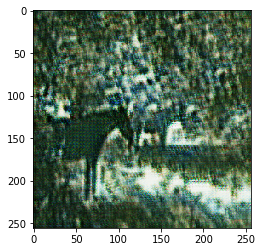

('Epoch 11/20...', 'Discriminator Loss: 0.3792...', 'Generator Loss: 3.9416')
Epoch: 11, Steps: 11320
('Epoch 11/20...', 'Discriminator Loss: 0.3323...', 'Generator Loss: 4.9111')
Epoch: 11, Steps: 11340
('Epoch 11/20...', 'Discriminator Loss: 0.4708...', 'Generator Loss: 4.6550')
Epoch: 11, Steps: 11360
('Epoch 11/20...', 'Discriminator Loss: 0.4809...', 'Generator Loss: 4.5113')
Epoch: 11, Steps: 11380
('Epoch 11/20...', 'Discriminator Loss: 0.4498...', 'Generator Loss: 3.9727')
Epoch: 11, Steps: 11400


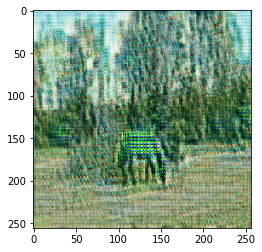

('Epoch 11/20...', 'Discriminator Loss: 0.3991...', 'Generator Loss: 4.5060')
Epoch: 11, Steps: 11420
('Epoch 11/20...', 'Discriminator Loss: 0.4307...', 'Generator Loss: 4.5987')
Epoch: 11, Steps: 11440
('Epoch 11/20...', 'Discriminator Loss: 0.4957...', 'Generator Loss: 4.9780')
Epoch: 11, Steps: 11460
('Epoch 11/20...', 'Discriminator Loss: 0.5236...', 'Generator Loss: 4.0047')
Epoch: 11, Steps: 11480
('Epoch 11/20...', 'Discriminator Loss: 0.2451...', 'Generator Loss: 5.1354')
Epoch: 11, Steps: 11500


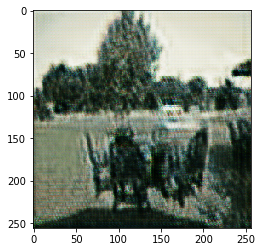

('Epoch 11/20...', 'Discriminator Loss: 0.4030...', 'Generator Loss: 4.8994')
Epoch: 11, Steps: 11520
('Epoch 11/20...', 'Discriminator Loss: 0.5462...', 'Generator Loss: 4.5051')
Epoch: 11, Steps: 11540
('Epoch 11/20...', 'Discriminator Loss: 0.3607...', 'Generator Loss: 3.5227')
Epoch: 11, Steps: 11560
('Epoch 11/20...', 'Discriminator Loss: 0.3705...', 'Generator Loss: 3.7903')
Epoch: 11, Steps: 11580
('Epoch 11/20...', 'Discriminator Loss: 0.3956...', 'Generator Loss: 5.6216')
Epoch: 11, Steps: 11600


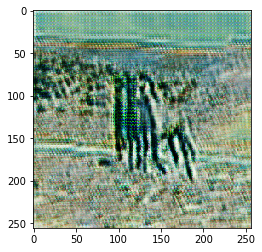

('Epoch 11/20...', 'Discriminator Loss: 0.3126...', 'Generator Loss: 3.5580')
Epoch: 11, Steps: 11620
('Epoch 11/20...', 'Discriminator Loss: 0.5531...', 'Generator Loss: 3.4177')
Epoch: 11, Steps: 11640
('Epoch 11/20...', 'Discriminator Loss: 0.3786...', 'Generator Loss: 5.6829')
Epoch: 11, Steps: 11660
('Epoch 11/20...', 'Discriminator Loss: 0.4888...', 'Generator Loss: 4.6033')
Epoch: 11, Steps: 11680
('Epoch 11/20...', 'Discriminator Loss: 0.3428...', 'Generator Loss: 5.1364')
Epoch: 11, Steps: 11700


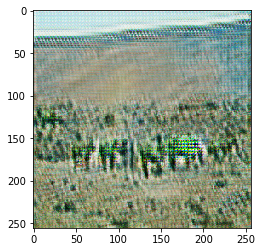

('Epoch 11/20...', 'Discriminator Loss: 0.4276...', 'Generator Loss: 4.7502')
Epoch: 11, Steps: 11720
('Epoch 12/20...', 'Discriminator Loss: 0.3711...', 'Generator Loss: 4.6003')
Epoch: 12, Steps: 11740
('Epoch 12/20...', 'Discriminator Loss: 0.3243...', 'Generator Loss: 4.4992')
Epoch: 12, Steps: 11760
('Epoch 12/20...', 'Discriminator Loss: 0.4770...', 'Generator Loss: 4.3536')
Epoch: 12, Steps: 11780
('Epoch 12/20...', 'Discriminator Loss: 0.3848...', 'Generator Loss: 4.7850')
Epoch: 12, Steps: 11800


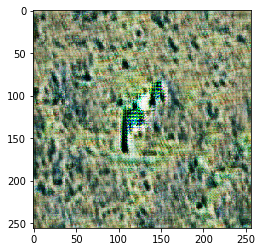

('Epoch 12/20...', 'Discriminator Loss: 0.7201...', 'Generator Loss: 4.8911')
Epoch: 12, Steps: 11820
('Epoch 12/20...', 'Discriminator Loss: 0.4327...', 'Generator Loss: 4.5344')
Epoch: 12, Steps: 11840
('Epoch 12/20...', 'Discriminator Loss: 0.3960...', 'Generator Loss: 4.1543')
Epoch: 12, Steps: 11860
('Epoch 12/20...', 'Discriminator Loss: 0.4240...', 'Generator Loss: 5.2518')
Epoch: 12, Steps: 11880
('Epoch 12/20...', 'Discriminator Loss: 0.4572...', 'Generator Loss: 4.2172')
Epoch: 12, Steps: 11900


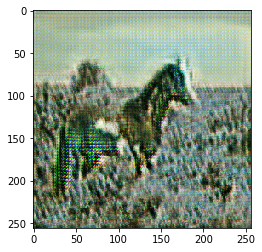

('Epoch 12/20...', 'Discriminator Loss: 0.3006...', 'Generator Loss: 4.6110')
Epoch: 12, Steps: 11920
('Epoch 12/20...', 'Discriminator Loss: 0.5056...', 'Generator Loss: 4.3177')
Epoch: 12, Steps: 11940
('Epoch 12/20...', 'Discriminator Loss: 0.4909...', 'Generator Loss: 4.7897')
Epoch: 12, Steps: 11960
('Epoch 12/20...', 'Discriminator Loss: 0.5183...', 'Generator Loss: 4.1089')
Epoch: 12, Steps: 11980
('Epoch 12/20...', 'Discriminator Loss: 0.4500...', 'Generator Loss: 4.5638')
Epoch: 12, Steps: 12000


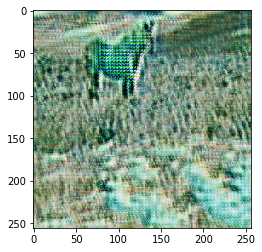

('Epoch 12/20...', 'Discriminator Loss: 0.4764...', 'Generator Loss: 4.6422')
Epoch: 12, Steps: 12020
('Epoch 12/20...', 'Discriminator Loss: 0.2862...', 'Generator Loss: 3.7567')
Epoch: 12, Steps: 12040
('Epoch 12/20...', 'Discriminator Loss: 0.3104...', 'Generator Loss: 3.7222')
Epoch: 12, Steps: 12060
('Epoch 12/20...', 'Discriminator Loss: 0.3113...', 'Generator Loss: 5.0474')
Epoch: 12, Steps: 12080
('Epoch 12/20...', 'Discriminator Loss: 0.4614...', 'Generator Loss: 4.7487')
Epoch: 12, Steps: 12100


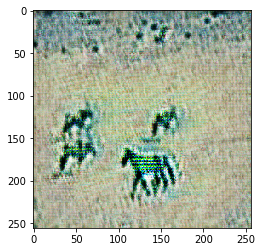

('Epoch 12/20...', 'Discriminator Loss: 0.3773...', 'Generator Loss: 5.3693')
Epoch: 12, Steps: 12120
('Epoch 12/20...', 'Discriminator Loss: 0.3998...', 'Generator Loss: 4.2173')
Epoch: 12, Steps: 12140
('Epoch 12/20...', 'Discriminator Loss: 0.4058...', 'Generator Loss: 4.7033')
Epoch: 12, Steps: 12160
('Epoch 12/20...', 'Discriminator Loss: 0.4090...', 'Generator Loss: 4.2306')
Epoch: 12, Steps: 12180
('Epoch 12/20...', 'Discriminator Loss: 0.3272...', 'Generator Loss: 3.3631')
Epoch: 12, Steps: 12200


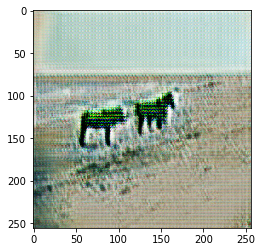

('Epoch 12/20...', 'Discriminator Loss: 0.4228...', 'Generator Loss: 5.4987')
Epoch: 12, Steps: 12220
('Epoch 12/20...', 'Discriminator Loss: 0.3335...', 'Generator Loss: 5.4487')
Epoch: 12, Steps: 12240
('Epoch 12/20...', 'Discriminator Loss: 0.5086...', 'Generator Loss: 4.9543')
Epoch: 12, Steps: 12260
('Epoch 12/20...', 'Discriminator Loss: 0.3622...', 'Generator Loss: 5.7895')
Epoch: 12, Steps: 12280
('Epoch 12/20...', 'Discriminator Loss: 0.1723...', 'Generator Loss: 5.9048')
Epoch: 12, Steps: 12300


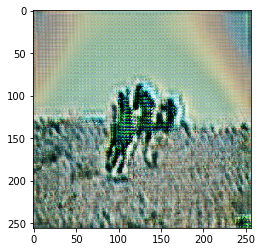

('Epoch 12/20...', 'Discriminator Loss: 0.4921...', 'Generator Loss: 4.5163')
Epoch: 12, Steps: 12320
('Epoch 12/20...', 'Discriminator Loss: 0.4238...', 'Generator Loss: 4.8156')
Epoch: 12, Steps: 12340
('Epoch 12/20...', 'Discriminator Loss: 0.2837...', 'Generator Loss: 5.5520')
Epoch: 12, Steps: 12360
('Epoch 12/20...', 'Discriminator Loss: 0.4775...', 'Generator Loss: 4.6911')
Epoch: 12, Steps: 12380
('Epoch 12/20...', 'Discriminator Loss: 0.5684...', 'Generator Loss: 4.8387')
Epoch: 12, Steps: 12400


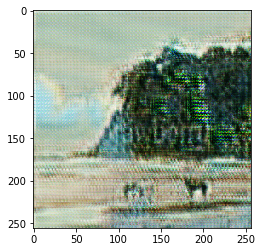

('Epoch 12/20...', 'Discriminator Loss: 0.3675...', 'Generator Loss: 4.0148')
Epoch: 12, Steps: 12420
('Epoch 12/20...', 'Discriminator Loss: 0.3632...', 'Generator Loss: 4.7141')
Epoch: 12, Steps: 12440
('Epoch 12/20...', 'Discriminator Loss: 0.3330...', 'Generator Loss: 4.5483')
Epoch: 12, Steps: 12460
('Epoch 12/20...', 'Discriminator Loss: 0.3170...', 'Generator Loss: 4.6837')
Epoch: 12, Steps: 12480
('Epoch 12/20...', 'Discriminator Loss: 0.3969...', 'Generator Loss: 4.5606')
Epoch: 12, Steps: 12500


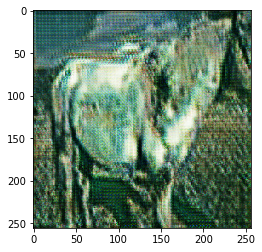

('Epoch 12/20...', 'Discriminator Loss: 0.4283...', 'Generator Loss: 3.7730')
Epoch: 12, Steps: 12520
('Epoch 12/20...', 'Discriminator Loss: 0.3384...', 'Generator Loss: 3.9345')
Epoch: 12, Steps: 12540
('Epoch 12/20...', 'Discriminator Loss: 0.3978...', 'Generator Loss: 5.1559')
Epoch: 12, Steps: 12560
('Epoch 12/20...', 'Discriminator Loss: 0.3491...', 'Generator Loss: 5.2501')
Epoch: 12, Steps: 12580
('Epoch 12/20...', 'Discriminator Loss: 0.4457...', 'Generator Loss: 6.2549')
Epoch: 12, Steps: 12600


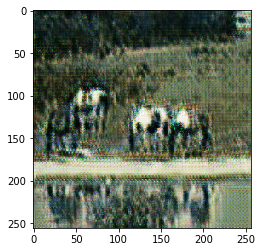

('Epoch 12/20...', 'Discriminator Loss: 0.4581...', 'Generator Loss: 4.6043')
Epoch: 12, Steps: 12620
('Epoch 12/20...', 'Discriminator Loss: 0.4436...', 'Generator Loss: 4.6888')
Epoch: 12, Steps: 12640
('Epoch 12/20...', 'Discriminator Loss: 0.3301...', 'Generator Loss: 4.3707')
Epoch: 12, Steps: 12660
('Epoch 12/20...', 'Discriminator Loss: 0.4367...', 'Generator Loss: 4.8794')
Epoch: 12, Steps: 12680
('Epoch 12/20...', 'Discriminator Loss: 0.3781...', 'Generator Loss: 4.4508')
Epoch: 12, Steps: 12700


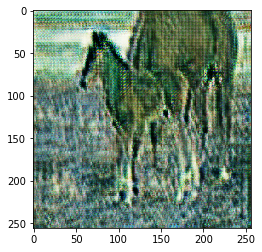

('Epoch 12/20...', 'Discriminator Loss: 0.4286...', 'Generator Loss: 4.1169')
Epoch: 12, Steps: 12720
('Epoch 12/20...', 'Discriminator Loss: 0.4086...', 'Generator Loss: 6.7105')
Epoch: 12, Steps: 12740
('Epoch 12/20...', 'Discriminator Loss: 0.3036...', 'Generator Loss: 4.8936')
Epoch: 12, Steps: 12760
('Epoch 12/20...', 'Discriminator Loss: 0.3802...', 'Generator Loss: 6.0749')
Epoch: 12, Steps: 12780
('Epoch 12/20...', 'Discriminator Loss: 0.4594...', 'Generator Loss: 5.0969')
Epoch: 12, Steps: 12800


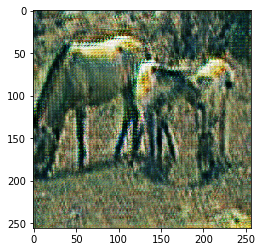

('Epoch 13/20...', 'Discriminator Loss: 0.3057...', 'Generator Loss: 3.8708')
Epoch: 13, Steps: 12820
('Epoch 13/20...', 'Discriminator Loss: 0.5519...', 'Generator Loss: 4.6462')
Epoch: 13, Steps: 12840
('Epoch 13/20...', 'Discriminator Loss: 0.3305...', 'Generator Loss: 5.3607')
Epoch: 13, Steps: 12860
('Epoch 13/20...', 'Discriminator Loss: 0.2883...', 'Generator Loss: 4.5844')
Epoch: 13, Steps: 12880
('Epoch 13/20...', 'Discriminator Loss: 0.4282...', 'Generator Loss: 4.3871')
Epoch: 13, Steps: 12900


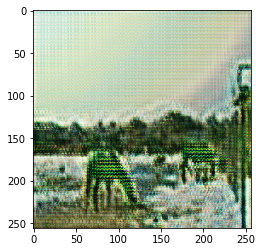

('Epoch 13/20...', 'Discriminator Loss: 0.4902...', 'Generator Loss: 4.6064')
Epoch: 13, Steps: 12920
('Epoch 13/20...', 'Discriminator Loss: 0.5299...', 'Generator Loss: 4.0226')
Epoch: 13, Steps: 12940
('Epoch 13/20...', 'Discriminator Loss: 0.5383...', 'Generator Loss: 3.0378')
Epoch: 13, Steps: 12960
('Epoch 13/20...', 'Discriminator Loss: 0.4594...', 'Generator Loss: 5.4733')
Epoch: 13, Steps: 12980
('Epoch 13/20...', 'Discriminator Loss: 0.4317...', 'Generator Loss: 4.6063')
Epoch: 13, Steps: 13000


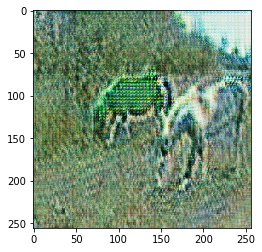

('Epoch 13/20...', 'Discriminator Loss: 0.3183...', 'Generator Loss: 4.0180')
Epoch: 13, Steps: 13020
('Epoch 13/20...', 'Discriminator Loss: 0.4023...', 'Generator Loss: 4.4655')
Epoch: 13, Steps: 13040
('Epoch 13/20...', 'Discriminator Loss: 0.4533...', 'Generator Loss: 3.6613')
Epoch: 13, Steps: 13060
('Epoch 13/20...', 'Discriminator Loss: 0.3044...', 'Generator Loss: 5.2836')
Epoch: 13, Steps: 13080
('Epoch 13/20...', 'Discriminator Loss: 0.5270...', 'Generator Loss: 3.8864')
Epoch: 13, Steps: 13100


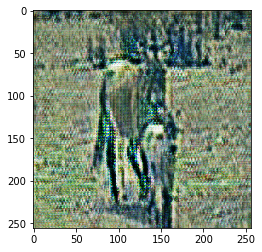

('Epoch 13/20...', 'Discriminator Loss: 0.3707...', 'Generator Loss: 4.4932')
Epoch: 13, Steps: 13120
('Epoch 13/20...', 'Discriminator Loss: 0.4406...', 'Generator Loss: 4.2050')
Epoch: 13, Steps: 13140
('Epoch 13/20...', 'Discriminator Loss: 0.3864...', 'Generator Loss: 4.5156')
Epoch: 13, Steps: 13160
('Epoch 13/20...', 'Discriminator Loss: 0.3833...', 'Generator Loss: 3.8830')
Epoch: 13, Steps: 13180
('Epoch 13/20...', 'Discriminator Loss: 0.6017...', 'Generator Loss: 3.3725')
Epoch: 13, Steps: 13200


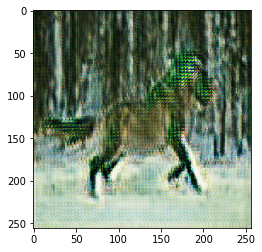

('Epoch 13/20...', 'Discriminator Loss: 0.5376...', 'Generator Loss: 4.2584')
Epoch: 13, Steps: 13220
('Epoch 13/20...', 'Discriminator Loss: 0.4704...', 'Generator Loss: 4.1806')
Epoch: 13, Steps: 13240
('Epoch 13/20...', 'Discriminator Loss: 0.5109...', 'Generator Loss: 3.5293')
Epoch: 13, Steps: 13260
('Epoch 13/20...', 'Discriminator Loss: 0.5029...', 'Generator Loss: 4.7089')
Epoch: 13, Steps: 13280
('Epoch 13/20...', 'Discriminator Loss: 0.4403...', 'Generator Loss: 4.7486')
Epoch: 13, Steps: 13300


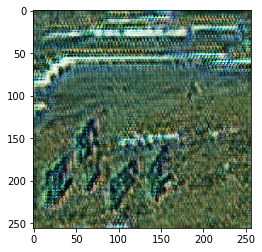

('Epoch 13/20...', 'Discriminator Loss: 0.4142...', 'Generator Loss: 5.9457')
Epoch: 13, Steps: 13320
('Epoch 13/20...', 'Discriminator Loss: 0.4485...', 'Generator Loss: 4.6905')
Epoch: 13, Steps: 13340
('Epoch 13/20...', 'Discriminator Loss: 0.3415...', 'Generator Loss: 5.1059')
Epoch: 13, Steps: 13360
('Epoch 13/20...', 'Discriminator Loss: 0.4935...', 'Generator Loss: 3.6873')
Epoch: 13, Steps: 13380
('Epoch 13/20...', 'Discriminator Loss: 0.4325...', 'Generator Loss: 4.3191')
Epoch: 13, Steps: 13400


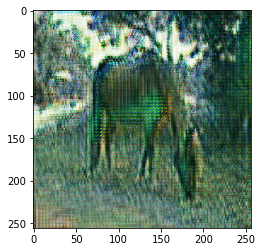

('Epoch 13/20...', 'Discriminator Loss: 0.3118...', 'Generator Loss: 4.1669')
Epoch: 13, Steps: 13420
('Epoch 13/20...', 'Discriminator Loss: 0.4790...', 'Generator Loss: 6.1351')
Epoch: 13, Steps: 13440
('Epoch 13/20...', 'Discriminator Loss: 0.3222...', 'Generator Loss: 5.8651')
Epoch: 13, Steps: 13460
('Epoch 13/20...', 'Discriminator Loss: 0.2695...', 'Generator Loss: 3.8842')
Epoch: 13, Steps: 13480
('Epoch 13/20...', 'Discriminator Loss: 0.3894...', 'Generator Loss: 4.1268')
Epoch: 13, Steps: 13500


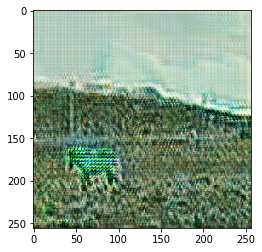

('Epoch 13/20...', 'Discriminator Loss: 0.3352...', 'Generator Loss: 4.9082')
Epoch: 13, Steps: 13520
('Epoch 13/20...', 'Discriminator Loss: 0.4296...', 'Generator Loss: 4.7236')
Epoch: 13, Steps: 13540
('Epoch 13/20...', 'Discriminator Loss: 0.4062...', 'Generator Loss: 4.2252')
Epoch: 13, Steps: 13560
('Epoch 13/20...', 'Discriminator Loss: 0.4100...', 'Generator Loss: 3.9801')
Epoch: 13, Steps: 13580
('Epoch 13/20...', 'Discriminator Loss: 0.3722...', 'Generator Loss: 4.5769')
Epoch: 13, Steps: 13600


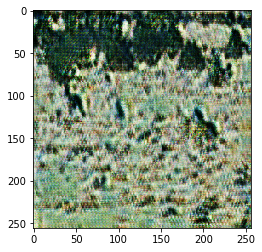

('Epoch 13/20...', 'Discriminator Loss: 0.4364...', 'Generator Loss: 3.9885')
Epoch: 13, Steps: 13620
('Epoch 13/20...', 'Discriminator Loss: 0.3351...', 'Generator Loss: 4.7506')
Epoch: 13, Steps: 13640
('Epoch 13/20...', 'Discriminator Loss: 0.4194...', 'Generator Loss: 4.9983')
Epoch: 13, Steps: 13660
('Epoch 13/20...', 'Discriminator Loss: 0.4022...', 'Generator Loss: 4.3314')
Epoch: 13, Steps: 13680
('Epoch 13/20...', 'Discriminator Loss: 0.3440...', 'Generator Loss: 4.4249')
Epoch: 13, Steps: 13700


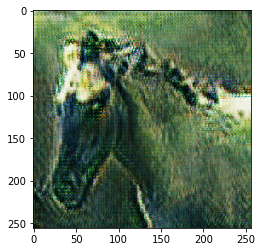

('Epoch 13/20...', 'Discriminator Loss: 0.4189...', 'Generator Loss: 4.6005')
Epoch: 13, Steps: 13720
('Epoch 13/20...', 'Discriminator Loss: 0.4643...', 'Generator Loss: 5.7588')
Epoch: 13, Steps: 13740
('Epoch 13/20...', 'Discriminator Loss: 0.2368...', 'Generator Loss: 4.5136')
Epoch: 13, Steps: 13760
('Epoch 13/20...', 'Discriminator Loss: 0.5389...', 'Generator Loss: 4.1061')
Epoch: 13, Steps: 13780
('Epoch 13/20...', 'Discriminator Loss: 0.4300...', 'Generator Loss: 4.1832')
Epoch: 13, Steps: 13800


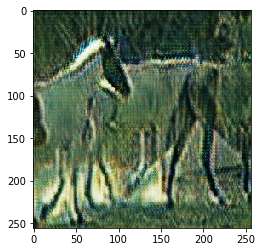

('Epoch 13/20...', 'Discriminator Loss: 0.3191...', 'Generator Loss: 4.5491')
Epoch: 13, Steps: 13820
('Epoch 13/20...', 'Discriminator Loss: 0.4716...', 'Generator Loss: 4.8445')
Epoch: 13, Steps: 13840
('Epoch 13/20...', 'Discriminator Loss: 0.3036...', 'Generator Loss: 6.5118')
Epoch: 13, Steps: 13860
('Epoch 14/20...', 'Discriminator Loss: 0.5084...', 'Generator Loss: 5.5395')
Epoch: 14, Steps: 13880
('Epoch 14/20...', 'Discriminator Loss: 0.4360...', 'Generator Loss: 5.2533')
Epoch: 14, Steps: 13900


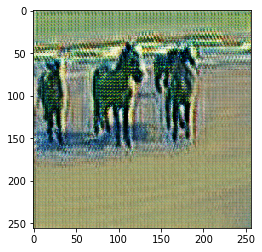

('Epoch 14/20...', 'Discriminator Loss: 0.4561...', 'Generator Loss: 3.6258')
Epoch: 14, Steps: 13920
('Epoch 14/20...', 'Discriminator Loss: 0.3136...', 'Generator Loss: 5.8275')
Epoch: 14, Steps: 13940
('Epoch 14/20...', 'Discriminator Loss: 0.4592...', 'Generator Loss: 5.7714')
Epoch: 14, Steps: 13960
('Epoch 14/20...', 'Discriminator Loss: 0.2989...', 'Generator Loss: 5.1384')
Epoch: 14, Steps: 13980
('Epoch 14/20...', 'Discriminator Loss: 0.4806...', 'Generator Loss: 4.9179')
Epoch: 14, Steps: 14000


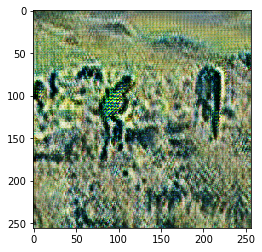

('Epoch 14/20...', 'Discriminator Loss: 0.4216...', 'Generator Loss: 4.6447')
Epoch: 14, Steps: 14020
('Epoch 14/20...', 'Discriminator Loss: 0.3957...', 'Generator Loss: 4.7470')
Epoch: 14, Steps: 14040
('Epoch 14/20...', 'Discriminator Loss: 0.2172...', 'Generator Loss: 5.7436')
Epoch: 14, Steps: 14060
('Epoch 14/20...', 'Discriminator Loss: 0.3696...', 'Generator Loss: 5.6715')
Epoch: 14, Steps: 14080
('Epoch 14/20...', 'Discriminator Loss: 0.3692...', 'Generator Loss: 4.1118')
Epoch: 14, Steps: 14100


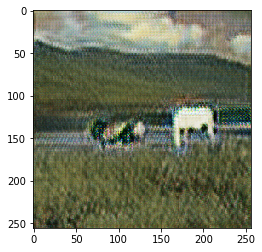

('Epoch 14/20...', 'Discriminator Loss: 0.3642...', 'Generator Loss: 4.9730')
Epoch: 14, Steps: 14120
('Epoch 14/20...', 'Discriminator Loss: 0.4139...', 'Generator Loss: 4.9740')
Epoch: 14, Steps: 14140
('Epoch 14/20...', 'Discriminator Loss: 0.4351...', 'Generator Loss: 4.0192')
Epoch: 14, Steps: 14160
('Epoch 14/20...', 'Discriminator Loss: 0.3975...', 'Generator Loss: 4.5538')
Epoch: 14, Steps: 14180
('Epoch 14/20...', 'Discriminator Loss: 0.4044...', 'Generator Loss: 4.2474')
Epoch: 14, Steps: 14200


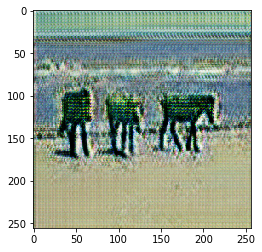

('Epoch 14/20...', 'Discriminator Loss: 0.2653...', 'Generator Loss: 4.1365')
Epoch: 14, Steps: 14220
('Epoch 14/20...', 'Discriminator Loss: 0.3559...', 'Generator Loss: 3.7593')
Epoch: 14, Steps: 14240
('Epoch 14/20...', 'Discriminator Loss: 0.4075...', 'Generator Loss: 4.5907')
Epoch: 14, Steps: 14260
('Epoch 14/20...', 'Discriminator Loss: 0.5846...', 'Generator Loss: 4.1731')
Epoch: 14, Steps: 14280
('Epoch 14/20...', 'Discriminator Loss: 0.4504...', 'Generator Loss: 5.0722')
Epoch: 14, Steps: 14300


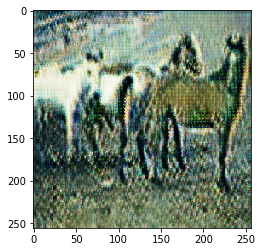

('Epoch 14/20...', 'Discriminator Loss: 0.4769...', 'Generator Loss: 3.9969')
Epoch: 14, Steps: 14320
('Epoch 14/20...', 'Discriminator Loss: 0.5389...', 'Generator Loss: 4.0337')
Epoch: 14, Steps: 14340
('Epoch 14/20...', 'Discriminator Loss: 0.4909...', 'Generator Loss: 5.3938')
Epoch: 14, Steps: 14360
('Epoch 14/20...', 'Discriminator Loss: 0.4100...', 'Generator Loss: 5.4109')
Epoch: 14, Steps: 14380
('Epoch 14/20...', 'Discriminator Loss: 0.4505...', 'Generator Loss: 4.6610')
Epoch: 14, Steps: 14400


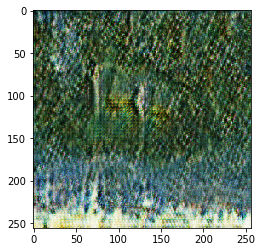

('Epoch 14/20...', 'Discriminator Loss: 0.3815...', 'Generator Loss: 4.8402')
Epoch: 14, Steps: 14420
('Epoch 14/20...', 'Discriminator Loss: 0.5735...', 'Generator Loss: 4.3592')
Epoch: 14, Steps: 14440
('Epoch 14/20...', 'Discriminator Loss: 0.3805...', 'Generator Loss: 4.6733')
Epoch: 14, Steps: 14460
('Epoch 14/20...', 'Discriminator Loss: 0.4610...', 'Generator Loss: 3.3783')
Epoch: 14, Steps: 14480
('Epoch 14/20...', 'Discriminator Loss: 0.4411...', 'Generator Loss: 4.9818')
Epoch: 14, Steps: 14500


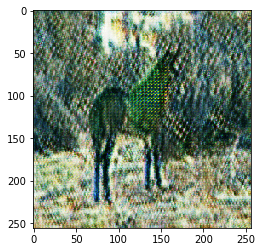

('Epoch 14/20...', 'Discriminator Loss: 0.3778...', 'Generator Loss: 4.4283')
Epoch: 14, Steps: 14520
('Epoch 14/20...', 'Discriminator Loss: 0.5116...', 'Generator Loss: 4.1084')
Epoch: 14, Steps: 14540
('Epoch 14/20...', 'Discriminator Loss: 0.5201...', 'Generator Loss: 3.9081')
Epoch: 14, Steps: 14560
('Epoch 14/20...', 'Discriminator Loss: 0.2738...', 'Generator Loss: 4.8639')
Epoch: 14, Steps: 14580
('Epoch 14/20...', 'Discriminator Loss: 0.4092...', 'Generator Loss: 5.3350')
Epoch: 14, Steps: 14600


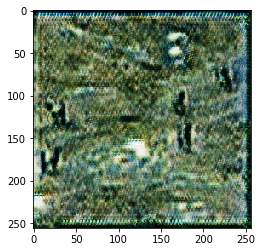

('Epoch 14/20...', 'Discriminator Loss: 0.5536...', 'Generator Loss: 3.9717')
Epoch: 14, Steps: 14620
('Epoch 14/20...', 'Discriminator Loss: 0.4363...', 'Generator Loss: 4.9619')
Epoch: 14, Steps: 14640
('Epoch 14/20...', 'Discriminator Loss: 0.4439...', 'Generator Loss: 3.8046')
Epoch: 14, Steps: 14660
('Epoch 14/20...', 'Discriminator Loss: 0.4914...', 'Generator Loss: 4.4929')
Epoch: 14, Steps: 14680
('Epoch 14/20...', 'Discriminator Loss: 0.4076...', 'Generator Loss: 3.9057')
Epoch: 14, Steps: 14700


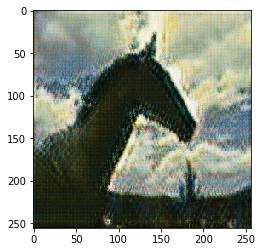

('Epoch 14/20...', 'Discriminator Loss: 0.5610...', 'Generator Loss: 4.4047')
Epoch: 14, Steps: 14720
('Epoch 14/20...', 'Discriminator Loss: 0.4555...', 'Generator Loss: 4.2113')
Epoch: 14, Steps: 14740
('Epoch 14/20...', 'Discriminator Loss: 0.4215...', 'Generator Loss: 4.4413')
Epoch: 14, Steps: 14760
('Epoch 14/20...', 'Discriminator Loss: 0.4217...', 'Generator Loss: 5.1837')
Epoch: 14, Steps: 14780
('Epoch 14/20...', 'Discriminator Loss: 0.2473...', 'Generator Loss: 4.5267')
Epoch: 14, Steps: 14800


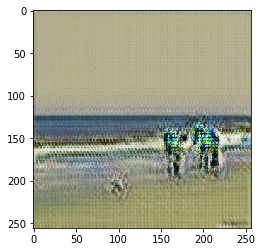

('Epoch 14/20...', 'Discriminator Loss: 0.4669...', 'Generator Loss: 4.6520')
Epoch: 14, Steps: 14820
('Epoch 14/20...', 'Discriminator Loss: 0.4140...', 'Generator Loss: 4.6629')
Epoch: 14, Steps: 14840
('Epoch 14/20...', 'Discriminator Loss: 0.3675...', 'Generator Loss: 5.4360')
Epoch: 14, Steps: 14860
('Epoch 14/20...', 'Discriminator Loss: 0.5701...', 'Generator Loss: 4.0092')
Epoch: 14, Steps: 14880
('Epoch 14/20...', 'Discriminator Loss: 0.4227...', 'Generator Loss: 4.2213')
Epoch: 14, Steps: 14900


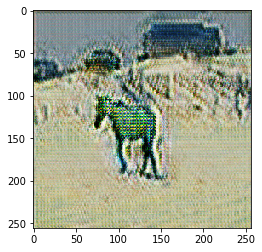

('Epoch 14/20...', 'Discriminator Loss: 0.4612...', 'Generator Loss: 3.8861')
Epoch: 14, Steps: 14920
('Epoch 15/20...', 'Discriminator Loss: 0.2941...', 'Generator Loss: 4.4376')
Epoch: 15, Steps: 14940
('Epoch 15/20...', 'Discriminator Loss: 0.5205...', 'Generator Loss: 3.3281')
Epoch: 15, Steps: 14960
('Epoch 15/20...', 'Discriminator Loss: 0.6645...', 'Generator Loss: 3.8898')
Epoch: 15, Steps: 14980
('Epoch 15/20...', 'Discriminator Loss: 0.5935...', 'Generator Loss: 3.9789')
Epoch: 15, Steps: 15000


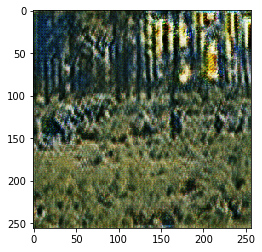

('Epoch 15/20...', 'Discriminator Loss: 0.3949...', 'Generator Loss: 4.9238')
Epoch: 15, Steps: 15020
('Epoch 15/20...', 'Discriminator Loss: 0.3164...', 'Generator Loss: 4.0485')
Epoch: 15, Steps: 15040
('Epoch 15/20...', 'Discriminator Loss: 0.4695...', 'Generator Loss: 4.8143')
Epoch: 15, Steps: 15060
('Epoch 15/20...', 'Discriminator Loss: 0.4705...', 'Generator Loss: 3.4971')
Epoch: 15, Steps: 15080
('Epoch 15/20...', 'Discriminator Loss: 0.3894...', 'Generator Loss: 6.0086')
Epoch: 15, Steps: 15100


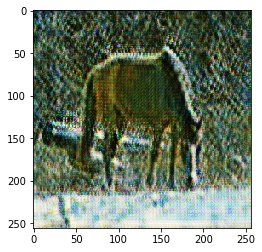

('Epoch 15/20...', 'Discriminator Loss: 0.2635...', 'Generator Loss: 5.2063')
Epoch: 15, Steps: 15120
('Epoch 15/20...', 'Discriminator Loss: 0.4627...', 'Generator Loss: 4.4091')
Epoch: 15, Steps: 15140
('Epoch 15/20...', 'Discriminator Loss: 0.4190...', 'Generator Loss: 3.7417')
Epoch: 15, Steps: 15160
('Epoch 15/20...', 'Discriminator Loss: 0.4950...', 'Generator Loss: 3.7095')
Epoch: 15, Steps: 15180
('Epoch 15/20...', 'Discriminator Loss: 0.3456...', 'Generator Loss: 6.5650')
Epoch: 15, Steps: 15200


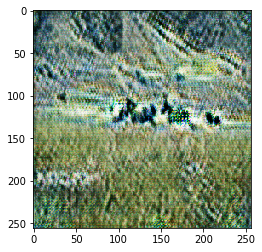

('Epoch 15/20...', 'Discriminator Loss: 0.3553...', 'Generator Loss: 5.2102')
Epoch: 15, Steps: 15220
('Epoch 15/20...', 'Discriminator Loss: 0.4213...', 'Generator Loss: 3.5880')
Epoch: 15, Steps: 15240
('Epoch 15/20...', 'Discriminator Loss: 0.4182...', 'Generator Loss: 5.3086')
Epoch: 15, Steps: 15260
('Epoch 15/20...', 'Discriminator Loss: 0.5031...', 'Generator Loss: 3.6494')
Epoch: 15, Steps: 15280
('Epoch 15/20...', 'Discriminator Loss: 0.5823...', 'Generator Loss: 3.3392')
Epoch: 15, Steps: 15300


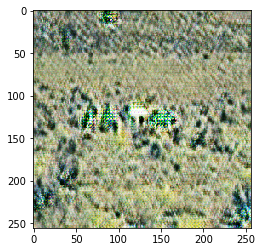

('Epoch 15/20...', 'Discriminator Loss: 0.5492...', 'Generator Loss: 3.4952')
Epoch: 15, Steps: 15320
('Epoch 15/20...', 'Discriminator Loss: 0.3522...', 'Generator Loss: 3.9396')
Epoch: 15, Steps: 15340
('Epoch 15/20...', 'Discriminator Loss: 0.3768...', 'Generator Loss: 4.9734')
Epoch: 15, Steps: 15360
('Epoch 15/20...', 'Discriminator Loss: 0.5193...', 'Generator Loss: 4.6507')
Epoch: 15, Steps: 15380
('Epoch 15/20...', 'Discriminator Loss: 0.3160...', 'Generator Loss: 5.1923')
Epoch: 15, Steps: 15400


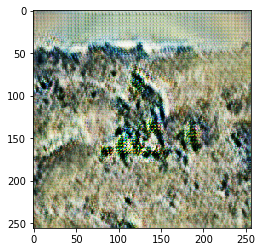

('Epoch 15/20...', 'Discriminator Loss: 0.5079...', 'Generator Loss: 4.3274')
Epoch: 15, Steps: 15420
('Epoch 15/20...', 'Discriminator Loss: 0.2963...', 'Generator Loss: 4.8953')
Epoch: 15, Steps: 15440
('Epoch 15/20...', 'Discriminator Loss: 0.4806...', 'Generator Loss: 4.4455')
Epoch: 15, Steps: 15460
('Epoch 15/20...', 'Discriminator Loss: 0.3619...', 'Generator Loss: 7.0366')
Epoch: 15, Steps: 15480
('Epoch 15/20...', 'Discriminator Loss: 0.3941...', 'Generator Loss: 4.8060')
Epoch: 15, Steps: 15500


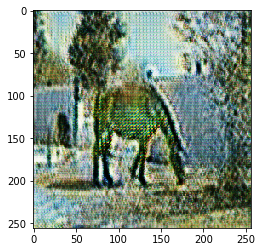

('Epoch 15/20...', 'Discriminator Loss: 0.2982...', 'Generator Loss: 5.8730')
Epoch: 15, Steps: 15520
('Epoch 15/20...', 'Discriminator Loss: 0.4038...', 'Generator Loss: 4.3767')
Epoch: 15, Steps: 15540
('Epoch 15/20...', 'Discriminator Loss: 0.4138...', 'Generator Loss: 4.1439')
Epoch: 15, Steps: 15560
('Epoch 15/20...', 'Discriminator Loss: 0.4676...', 'Generator Loss: 4.1337')
Epoch: 15, Steps: 15580
('Epoch 15/20...', 'Discriminator Loss: 0.5025...', 'Generator Loss: 4.3331')
Epoch: 15, Steps: 15600


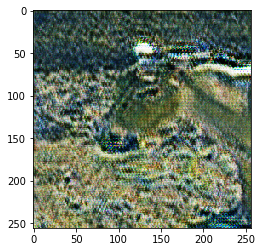

('Epoch 15/20...', 'Discriminator Loss: 0.4293...', 'Generator Loss: 4.4982')
Epoch: 15, Steps: 15620
('Epoch 15/20...', 'Discriminator Loss: 0.3920...', 'Generator Loss: 4.3327')
Epoch: 15, Steps: 15640
('Epoch 15/20...', 'Discriminator Loss: 0.2759...', 'Generator Loss: 5.6632')
Epoch: 15, Steps: 15660
('Epoch 15/20...', 'Discriminator Loss: 0.5772...', 'Generator Loss: 5.3547')
Epoch: 15, Steps: 15680
('Epoch 15/20...', 'Discriminator Loss: 0.4856...', 'Generator Loss: 4.4596')
Epoch: 15, Steps: 15700


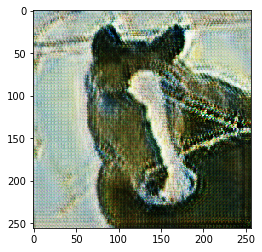

('Epoch 15/20...', 'Discriminator Loss: 0.3950...', 'Generator Loss: 3.8489')
Epoch: 15, Steps: 15720
('Epoch 15/20...', 'Discriminator Loss: 0.4694...', 'Generator Loss: 3.6770')
Epoch: 15, Steps: 15740
('Epoch 15/20...', 'Discriminator Loss: 0.3903...', 'Generator Loss: 4.4344')
Epoch: 15, Steps: 15760
('Epoch 15/20...', 'Discriminator Loss: 0.2580...', 'Generator Loss: 5.0895')
Epoch: 15, Steps: 15780
('Epoch 15/20...', 'Discriminator Loss: 0.6296...', 'Generator Loss: 3.2028')
Epoch: 15, Steps: 15800


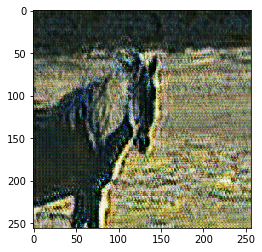

('Epoch 15/20...', 'Discriminator Loss: 0.5142...', 'Generator Loss: 3.7794')
Epoch: 15, Steps: 15820
('Epoch 15/20...', 'Discriminator Loss: 0.4217...', 'Generator Loss: 5.0827')
Epoch: 15, Steps: 15840
('Epoch 15/20...', 'Discriminator Loss: 0.6013...', 'Generator Loss: 4.4239')
Epoch: 15, Steps: 15860
('Epoch 15/20...', 'Discriminator Loss: 0.6518...', 'Generator Loss: 5.3195')
Epoch: 15, Steps: 15880
('Epoch 15/20...', 'Discriminator Loss: 0.4901...', 'Generator Loss: 4.3684')
Epoch: 15, Steps: 15900


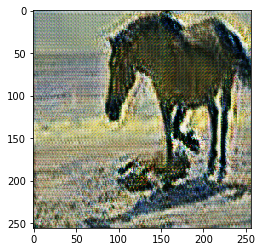

('Epoch 15/20...', 'Discriminator Loss: 0.3757...', 'Generator Loss: 4.3757')
Epoch: 15, Steps: 15920
('Epoch 15/20...', 'Discriminator Loss: 0.2364...', 'Generator Loss: 4.3812')
Epoch: 15, Steps: 15940
('Epoch 15/20...', 'Discriminator Loss: 0.4284...', 'Generator Loss: 4.2332')
Epoch: 15, Steps: 15960
('Epoch 15/20...', 'Discriminator Loss: 0.3695...', 'Generator Loss: 4.8920')
Epoch: 15, Steps: 15980
('Epoch 15/20...', 'Discriminator Loss: 0.4871...', 'Generator Loss: 4.4215')
Epoch: 15, Steps: 16000


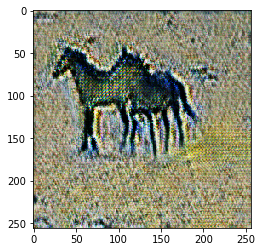

('Epoch 16/20...', 'Discriminator Loss: 0.5396...', 'Generator Loss: 4.6236')
Epoch: 16, Steps: 16020
('Epoch 16/20...', 'Discriminator Loss: 0.4149...', 'Generator Loss: 4.2411')
Epoch: 16, Steps: 16040
('Epoch 16/20...', 'Discriminator Loss: 0.4990...', 'Generator Loss: 5.2821')
Epoch: 16, Steps: 16060
('Epoch 16/20...', 'Discriminator Loss: 0.4776...', 'Generator Loss: 4.6600')
Epoch: 16, Steps: 16080
('Epoch 16/20...', 'Discriminator Loss: 0.4533...', 'Generator Loss: 4.4946')
Epoch: 16, Steps: 16100


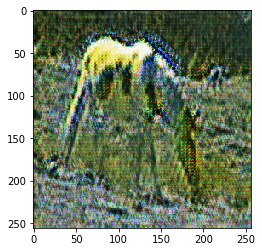

('Epoch 16/20...', 'Discriminator Loss: 0.5761...', 'Generator Loss: 3.8692')
Epoch: 16, Steps: 16120
('Epoch 16/20...', 'Discriminator Loss: 0.3899...', 'Generator Loss: 4.6528')
Epoch: 16, Steps: 16140
('Epoch 16/20...', 'Discriminator Loss: 0.3710...', 'Generator Loss: 3.9806')
Epoch: 16, Steps: 16160
('Epoch 16/20...', 'Discriminator Loss: 0.5151...', 'Generator Loss: 3.2120')
Epoch: 16, Steps: 16180
('Epoch 16/20...', 'Discriminator Loss: 0.3773...', 'Generator Loss: 3.8623')
Epoch: 16, Steps: 16200


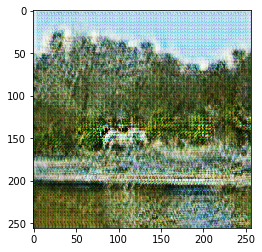

('Epoch 16/20...', 'Discriminator Loss: 0.3688...', 'Generator Loss: 4.3722')
Epoch: 16, Steps: 16220
('Epoch 16/20...', 'Discriminator Loss: 0.4923...', 'Generator Loss: 4.4169')
Epoch: 16, Steps: 16240
('Epoch 16/20...', 'Discriminator Loss: 0.4761...', 'Generator Loss: 3.7984')
Epoch: 16, Steps: 16260
('Epoch 16/20...', 'Discriminator Loss: 0.3384...', 'Generator Loss: 3.9113')
Epoch: 16, Steps: 16280
('Epoch 16/20...', 'Discriminator Loss: 0.2377...', 'Generator Loss: 5.6399')
Epoch: 16, Steps: 16300


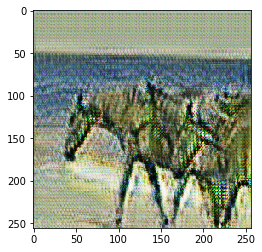

('Epoch 16/20...', 'Discriminator Loss: 0.4585...', 'Generator Loss: 4.4564')
Epoch: 16, Steps: 16320
('Epoch 16/20...', 'Discriminator Loss: 0.4036...', 'Generator Loss: 4.1261')
Epoch: 16, Steps: 16340
('Epoch 16/20...', 'Discriminator Loss: 0.4147...', 'Generator Loss: 3.8440')
Epoch: 16, Steps: 16360
('Epoch 16/20...', 'Discriminator Loss: 0.5647...', 'Generator Loss: 3.8224')
Epoch: 16, Steps: 16380
('Epoch 16/20...', 'Discriminator Loss: 0.3199...', 'Generator Loss: 5.3781')
Epoch: 16, Steps: 16400


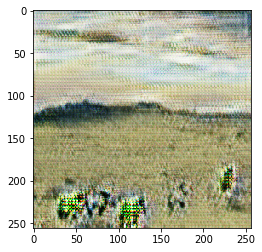

('Epoch 16/20...', 'Discriminator Loss: 0.5308...', 'Generator Loss: 3.7211')
Epoch: 16, Steps: 16420
('Epoch 16/20...', 'Discriminator Loss: 0.4219...', 'Generator Loss: 4.4837')
Epoch: 16, Steps: 16440
('Epoch 16/20...', 'Discriminator Loss: 0.5235...', 'Generator Loss: 4.9838')
Epoch: 16, Steps: 16460
('Epoch 16/20...', 'Discriminator Loss: 0.4286...', 'Generator Loss: 5.1678')
Epoch: 16, Steps: 16480
('Epoch 16/20...', 'Discriminator Loss: 0.3684...', 'Generator Loss: 4.8915')
Epoch: 16, Steps: 16500


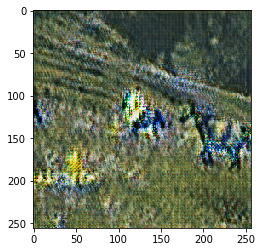

('Epoch 16/20...', 'Discriminator Loss: 0.3869...', 'Generator Loss: 5.1962')
Epoch: 16, Steps: 16520
('Epoch 16/20...', 'Discriminator Loss: 0.2961...', 'Generator Loss: 6.0492')
Epoch: 16, Steps: 16540
('Epoch 16/20...', 'Discriminator Loss: 0.3854...', 'Generator Loss: 4.2168')
Epoch: 16, Steps: 16560
('Epoch 16/20...', 'Discriminator Loss: 0.4700...', 'Generator Loss: 5.4152')
Epoch: 16, Steps: 16580
('Epoch 16/20...', 'Discriminator Loss: 0.3938...', 'Generator Loss: 4.7366')
Epoch: 16, Steps: 16600


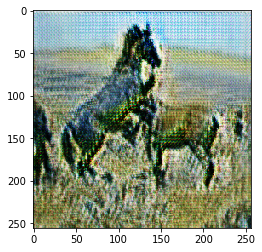

('Epoch 16/20...', 'Discriminator Loss: 0.3767...', 'Generator Loss: 3.2722')
Epoch: 16, Steps: 16620
('Epoch 16/20...', 'Discriminator Loss: 0.4273...', 'Generator Loss: 4.6456')
Epoch: 16, Steps: 16640
('Epoch 16/20...', 'Discriminator Loss: 0.4647...', 'Generator Loss: 4.6696')
Epoch: 16, Steps: 16660
('Epoch 16/20...', 'Discriminator Loss: 0.3987...', 'Generator Loss: 3.9420')
Epoch: 16, Steps: 16680
('Epoch 16/20...', 'Discriminator Loss: 0.3527...', 'Generator Loss: 5.0790')
Epoch: 16, Steps: 16700


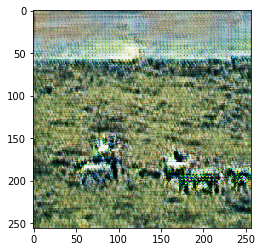

('Epoch 16/20...', 'Discriminator Loss: 0.4600...', 'Generator Loss: 4.2370')
Epoch: 16, Steps: 16720
('Epoch 16/20...', 'Discriminator Loss: 0.3356...', 'Generator Loss: 4.9851')
Epoch: 16, Steps: 16740
('Epoch 16/20...', 'Discriminator Loss: 0.4020...', 'Generator Loss: 3.8064')
Epoch: 16, Steps: 16760
('Epoch 16/20...', 'Discriminator Loss: 0.4957...', 'Generator Loss: 4.5693')
Epoch: 16, Steps: 16780
('Epoch 16/20...', 'Discriminator Loss: 0.4703...', 'Generator Loss: 5.2938')
Epoch: 16, Steps: 16800


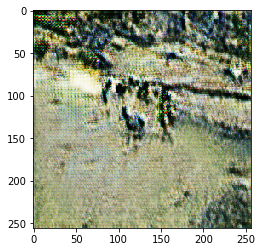

('Epoch 16/20...', 'Discriminator Loss: 0.4115...', 'Generator Loss: 3.5364')
Epoch: 16, Steps: 16820
('Epoch 16/20...', 'Discriminator Loss: 0.3112...', 'Generator Loss: 4.8449')
Epoch: 16, Steps: 16840
('Epoch 16/20...', 'Discriminator Loss: 0.4828...', 'Generator Loss: 4.9013')
Epoch: 16, Steps: 16860
('Epoch 16/20...', 'Discriminator Loss: 0.3586...', 'Generator Loss: 4.6015')
Epoch: 16, Steps: 16880
('Epoch 16/20...', 'Discriminator Loss: 0.4339...', 'Generator Loss: 5.3949')
Epoch: 16, Steps: 16900


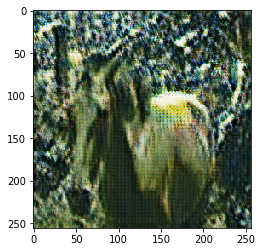

('Epoch 16/20...', 'Discriminator Loss: 0.3211...', 'Generator Loss: 5.3825')
Epoch: 16, Steps: 16920
('Epoch 16/20...', 'Discriminator Loss: 0.3555...', 'Generator Loss: 4.6277')
Epoch: 16, Steps: 16940
('Epoch 16/20...', 'Discriminator Loss: 0.3881...', 'Generator Loss: 4.5428')
Epoch: 16, Steps: 16960
('Epoch 16/20...', 'Discriminator Loss: 0.4813...', 'Generator Loss: 4.1232')
Epoch: 16, Steps: 16980
('Epoch 16/20...', 'Discriminator Loss: 0.4310...', 'Generator Loss: 4.6511')
Epoch: 16, Steps: 17000


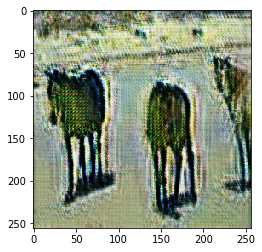

('Epoch 16/20...', 'Discriminator Loss: 0.3275...', 'Generator Loss: 5.9657')
Epoch: 16, Steps: 17020
('Epoch 16/20...', 'Discriminator Loss: 0.2868...', 'Generator Loss: 4.1687')
Epoch: 16, Steps: 17040
('Epoch 16/20...', 'Discriminator Loss: 0.4549...', 'Generator Loss: 5.0614')
Epoch: 16, Steps: 17060
('Epoch 17/20...', 'Discriminator Loss: 0.3800...', 'Generator Loss: 5.3647')
Epoch: 17, Steps: 17080
('Epoch 17/20...', 'Discriminator Loss: 0.5509...', 'Generator Loss: 3.6789')
Epoch: 17, Steps: 17100


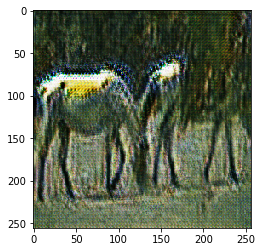

('Epoch 17/20...', 'Discriminator Loss: 0.3814...', 'Generator Loss: 5.4612')
Epoch: 17, Steps: 17120
('Epoch 17/20...', 'Discriminator Loss: 0.4675...', 'Generator Loss: 3.6884')
Epoch: 17, Steps: 17140
('Epoch 17/20...', 'Discriminator Loss: 0.4326...', 'Generator Loss: 4.7322')
Epoch: 17, Steps: 17160
('Epoch 17/20...', 'Discriminator Loss: 0.3258...', 'Generator Loss: 5.0447')
Epoch: 17, Steps: 17180
('Epoch 17/20...', 'Discriminator Loss: 0.4809...', 'Generator Loss: 3.9539')
Epoch: 17, Steps: 17200


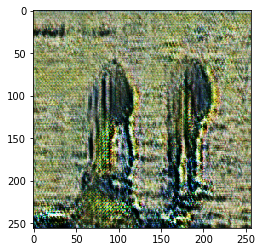

('Epoch 17/20...', 'Discriminator Loss: 0.5300...', 'Generator Loss: 3.6806')
Epoch: 17, Steps: 17220
('Epoch 17/20...', 'Discriminator Loss: 0.5232...', 'Generator Loss: 3.7729')
Epoch: 17, Steps: 17240
('Epoch 17/20...', 'Discriminator Loss: 0.3560...', 'Generator Loss: 5.6421')
Epoch: 17, Steps: 17260
('Epoch 17/20...', 'Discriminator Loss: 0.4171...', 'Generator Loss: 5.3334')
Epoch: 17, Steps: 17280
('Epoch 17/20...', 'Discriminator Loss: 0.3813...', 'Generator Loss: 5.5205')
Epoch: 17, Steps: 17300


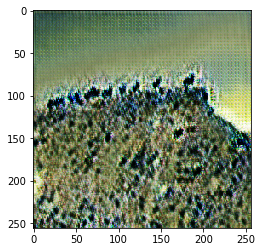

('Epoch 17/20...', 'Discriminator Loss: 0.4699...', 'Generator Loss: 3.9655')
Epoch: 17, Steps: 17320
('Epoch 17/20...', 'Discriminator Loss: 0.5513...', 'Generator Loss: 3.3089')
Epoch: 17, Steps: 17340
('Epoch 17/20...', 'Discriminator Loss: 0.3067...', 'Generator Loss: 3.9629')
Epoch: 17, Steps: 17360
('Epoch 17/20...', 'Discriminator Loss: 0.5654...', 'Generator Loss: 4.0832')
Epoch: 17, Steps: 17380
('Epoch 17/20...', 'Discriminator Loss: 0.3740...', 'Generator Loss: 4.3485')
Epoch: 17, Steps: 17400


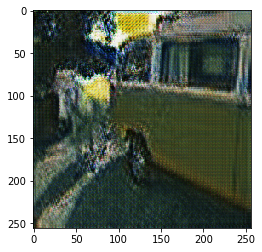

('Epoch 17/20...', 'Discriminator Loss: 0.1861...', 'Generator Loss: 4.6121')
Epoch: 17, Steps: 17420
('Epoch 17/20...', 'Discriminator Loss: 0.3697...', 'Generator Loss: 5.6321')
Epoch: 17, Steps: 17440
('Epoch 17/20...', 'Discriminator Loss: 0.4913...', 'Generator Loss: 4.1485')
Epoch: 17, Steps: 17460
('Epoch 17/20...', 'Discriminator Loss: 0.3937...', 'Generator Loss: 4.7902')
Epoch: 17, Steps: 17480
('Epoch 17/20...', 'Discriminator Loss: 0.4520...', 'Generator Loss: 5.0567')
Epoch: 17, Steps: 17500


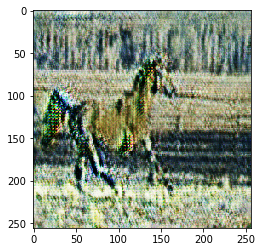

('Epoch 17/20...', 'Discriminator Loss: 0.3979...', 'Generator Loss: 4.8034')
Epoch: 17, Steps: 17520
('Epoch 17/20...', 'Discriminator Loss: 0.3797...', 'Generator Loss: 4.0981')
Epoch: 17, Steps: 17540
('Epoch 17/20...', 'Discriminator Loss: 0.3378...', 'Generator Loss: 4.1696')
Epoch: 17, Steps: 17560
('Epoch 17/20...', 'Discriminator Loss: 0.3292...', 'Generator Loss: 5.1942')
Epoch: 17, Steps: 17580
('Epoch 17/20...', 'Discriminator Loss: 0.4214...', 'Generator Loss: 5.2696')
Epoch: 17, Steps: 17600


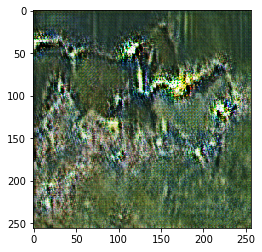

('Epoch 17/20...', 'Discriminator Loss: 0.4028...', 'Generator Loss: 3.7794')
Epoch: 17, Steps: 17620
('Epoch 17/20...', 'Discriminator Loss: 0.3735...', 'Generator Loss: 4.9513')
Epoch: 17, Steps: 17640
('Epoch 17/20...', 'Discriminator Loss: 0.4606...', 'Generator Loss: 4.8652')
Epoch: 17, Steps: 17660
('Epoch 17/20...', 'Discriminator Loss: 0.4491...', 'Generator Loss: 3.2722')
Epoch: 17, Steps: 17680
('Epoch 17/20...', 'Discriminator Loss: 0.5667...', 'Generator Loss: 4.1298')
Epoch: 17, Steps: 17700


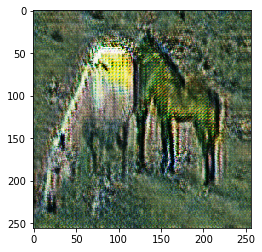

('Epoch 17/20...', 'Discriminator Loss: 0.4631...', 'Generator Loss: 3.6717')
Epoch: 17, Steps: 17720
('Epoch 17/20...', 'Discriminator Loss: 0.3731...', 'Generator Loss: 3.4634')
Epoch: 17, Steps: 17740
('Epoch 17/20...', 'Discriminator Loss: 0.4295...', 'Generator Loss: 4.3480')
Epoch: 17, Steps: 17760
('Epoch 17/20...', 'Discriminator Loss: 0.5004...', 'Generator Loss: 4.0053')
Epoch: 17, Steps: 17780
('Epoch 17/20...', 'Discriminator Loss: 0.2737...', 'Generator Loss: 4.0256')
Epoch: 17, Steps: 17800


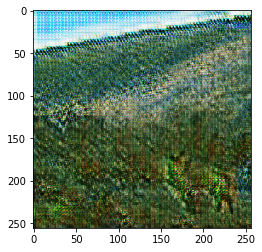

('Epoch 17/20...', 'Discriminator Loss: 0.4291...', 'Generator Loss: 4.5092')
Epoch: 17, Steps: 17820
('Epoch 17/20...', 'Discriminator Loss: 0.5316...', 'Generator Loss: 4.5632')
Epoch: 17, Steps: 17840
('Epoch 17/20...', 'Discriminator Loss: 0.4002...', 'Generator Loss: 4.4143')
Epoch: 17, Steps: 17860
('Epoch 17/20...', 'Discriminator Loss: 0.6121...', 'Generator Loss: 4.0312')
Epoch: 17, Steps: 17880
('Epoch 17/20...', 'Discriminator Loss: 0.2414...', 'Generator Loss: 3.8022')
Epoch: 17, Steps: 17900


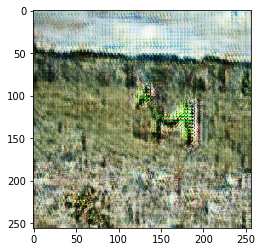

('Epoch 17/20...', 'Discriminator Loss: 0.5526...', 'Generator Loss: 4.6074')
Epoch: 17, Steps: 17920
('Epoch 17/20...', 'Discriminator Loss: 0.3158...', 'Generator Loss: 5.9309')
Epoch: 17, Steps: 17940
('Epoch 17/20...', 'Discriminator Loss: 0.2760...', 'Generator Loss: 4.3655')
Epoch: 17, Steps: 17960
('Epoch 17/20...', 'Discriminator Loss: 0.2769...', 'Generator Loss: 4.2037')
Epoch: 17, Steps: 17980
('Epoch 17/20...', 'Discriminator Loss: 0.2031...', 'Generator Loss: 4.3106')
Epoch: 17, Steps: 18000


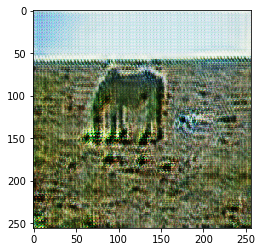

('Epoch 17/20...', 'Discriminator Loss: 0.7059...', 'Generator Loss: 3.0647')
Epoch: 17, Steps: 18020
('Epoch 17/20...', 'Discriminator Loss: 0.4174...', 'Generator Loss: 5.0436')
Epoch: 17, Steps: 18040
('Epoch 17/20...', 'Discriminator Loss: 0.5312...', 'Generator Loss: 4.1947')
Epoch: 17, Steps: 18060
('Epoch 17/20...', 'Discriminator Loss: 0.5091...', 'Generator Loss: 3.8799')
Epoch: 17, Steps: 18080
('Epoch 17/20...', 'Discriminator Loss: 0.4111...', 'Generator Loss: 3.5212')
Epoch: 17, Steps: 18100


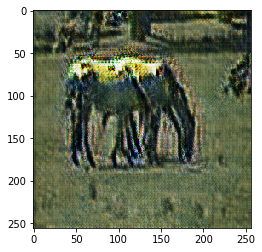

('Epoch 17/20...', 'Discriminator Loss: 0.3924...', 'Generator Loss: 4.7624')
Epoch: 17, Steps: 18120
('Epoch 18/20...', 'Discriminator Loss: 0.2411...', 'Generator Loss: 5.7144')
Epoch: 18, Steps: 18140
('Epoch 18/20...', 'Discriminator Loss: 0.2439...', 'Generator Loss: 5.5452')
Epoch: 18, Steps: 18160
('Epoch 18/20...', 'Discriminator Loss: 0.2946...', 'Generator Loss: 4.0965')
Epoch: 18, Steps: 18180
('Epoch 18/20...', 'Discriminator Loss: 0.3533...', 'Generator Loss: 5.0443')
Epoch: 18, Steps: 18200


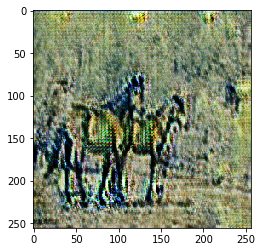

('Epoch 18/20...', 'Discriminator Loss: 0.3930...', 'Generator Loss: 4.9018')
Epoch: 18, Steps: 18220
('Epoch 18/20...', 'Discriminator Loss: 0.3961...', 'Generator Loss: 4.1770')
Epoch: 18, Steps: 18240
('Epoch 18/20...', 'Discriminator Loss: 0.3778...', 'Generator Loss: 4.3379')
Epoch: 18, Steps: 18260
('Epoch 18/20...', 'Discriminator Loss: 0.5133...', 'Generator Loss: 3.6275')
Epoch: 18, Steps: 18280
('Epoch 18/20...', 'Discriminator Loss: 0.3850...', 'Generator Loss: 5.0923')
Epoch: 18, Steps: 18300


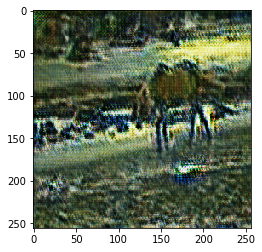

('Epoch 18/20...', 'Discriminator Loss: 0.3874...', 'Generator Loss: 5.5600')
Epoch: 18, Steps: 18320
('Epoch 18/20...', 'Discriminator Loss: 0.4789...', 'Generator Loss: 5.4605')
Epoch: 18, Steps: 18340
('Epoch 18/20...', 'Discriminator Loss: 0.3256...', 'Generator Loss: 5.6521')
Epoch: 18, Steps: 18360
('Epoch 18/20...', 'Discriminator Loss: 0.4217...', 'Generator Loss: 4.4115')
Epoch: 18, Steps: 18380
('Epoch 18/20...', 'Discriminator Loss: 0.4139...', 'Generator Loss: 3.6826')
Epoch: 18, Steps: 18400


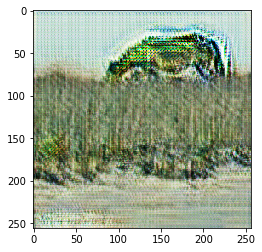

('Epoch 18/20...', 'Discriminator Loss: 0.2633...', 'Generator Loss: 5.2262')
Epoch: 18, Steps: 18420
('Epoch 18/20...', 'Discriminator Loss: 0.3654...', 'Generator Loss: 4.1043')
Epoch: 18, Steps: 18440
('Epoch 18/20...', 'Discriminator Loss: 0.3077...', 'Generator Loss: 3.6659')
Epoch: 18, Steps: 18460
('Epoch 18/20...', 'Discriminator Loss: 0.4504...', 'Generator Loss: 5.0836')
Epoch: 18, Steps: 18480
('Epoch 18/20...', 'Discriminator Loss: 0.4292...', 'Generator Loss: 4.9931')
Epoch: 18, Steps: 18500


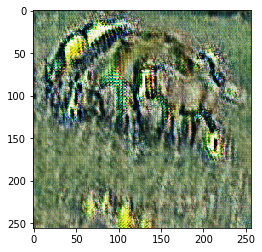

('Epoch 18/20...', 'Discriminator Loss: 0.5453...', 'Generator Loss: 3.5780')
Epoch: 18, Steps: 18520
('Epoch 18/20...', 'Discriminator Loss: 0.6532...', 'Generator Loss: 4.9143')
Epoch: 18, Steps: 18540
('Epoch 18/20...', 'Discriminator Loss: 0.3592...', 'Generator Loss: 5.6350')
Epoch: 18, Steps: 18560
('Epoch 18/20...', 'Discriminator Loss: 0.3503...', 'Generator Loss: 3.9451')
Epoch: 18, Steps: 18580
('Epoch 18/20...', 'Discriminator Loss: 0.3557...', 'Generator Loss: 4.5917')
Epoch: 18, Steps: 18600


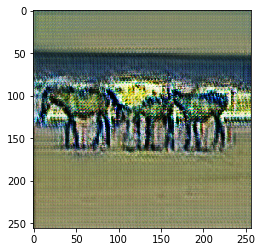

('Epoch 18/20...', 'Discriminator Loss: 0.4400...', 'Generator Loss: 4.3057')
Epoch: 18, Steps: 18620
('Epoch 18/20...', 'Discriminator Loss: 0.6135...', 'Generator Loss: 4.6167')
Epoch: 18, Steps: 18640
('Epoch 18/20...', 'Discriminator Loss: 0.3675...', 'Generator Loss: 4.2456')
Epoch: 18, Steps: 18660
('Epoch 18/20...', 'Discriminator Loss: 0.5469...', 'Generator Loss: 3.7824')
Epoch: 18, Steps: 18680
('Epoch 18/20...', 'Discriminator Loss: 0.3180...', 'Generator Loss: 5.1585')
Epoch: 18, Steps: 18700


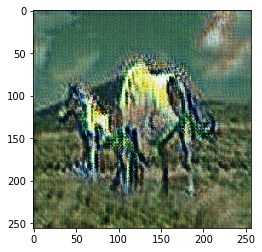

('Epoch 18/20...', 'Discriminator Loss: 0.4054...', 'Generator Loss: 4.7925')
Epoch: 18, Steps: 18720
('Epoch 18/20...', 'Discriminator Loss: 0.3078...', 'Generator Loss: 4.2005')
Epoch: 18, Steps: 18740
('Epoch 18/20...', 'Discriminator Loss: 0.4721...', 'Generator Loss: 3.5960')
Epoch: 18, Steps: 18760
('Epoch 18/20...', 'Discriminator Loss: 0.4064...', 'Generator Loss: 4.8778')
Epoch: 18, Steps: 18780
('Epoch 18/20...', 'Discriminator Loss: 0.3505...', 'Generator Loss: 4.2041')
Epoch: 18, Steps: 18800


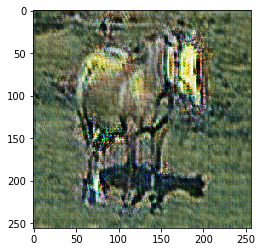

('Epoch 18/20...', 'Discriminator Loss: 0.6551...', 'Generator Loss: 3.8017')
Epoch: 18, Steps: 18820
('Epoch 18/20...', 'Discriminator Loss: 0.3951...', 'Generator Loss: 4.7413')
Epoch: 18, Steps: 18840
('Epoch 18/20...', 'Discriminator Loss: 0.4693...', 'Generator Loss: 4.0477')
Epoch: 18, Steps: 18860
('Epoch 18/20...', 'Discriminator Loss: 0.4328...', 'Generator Loss: 4.6703')
Epoch: 18, Steps: 18880
('Epoch 18/20...', 'Discriminator Loss: 0.2471...', 'Generator Loss: 5.4605')
Epoch: 18, Steps: 18900


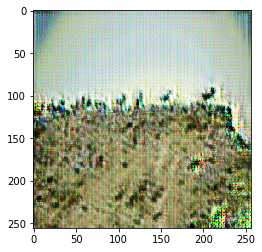

('Epoch 18/20...', 'Discriminator Loss: 0.5552...', 'Generator Loss: 6.2983')
Epoch: 18, Steps: 18920
('Epoch 18/20...', 'Discriminator Loss: 0.3103...', 'Generator Loss: 4.5994')
Epoch: 18, Steps: 18940
('Epoch 18/20...', 'Discriminator Loss: 0.3097...', 'Generator Loss: 4.5296')
Epoch: 18, Steps: 18960
('Epoch 18/20...', 'Discriminator Loss: 0.5425...', 'Generator Loss: 4.3805')
Epoch: 18, Steps: 18980
('Epoch 18/20...', 'Discriminator Loss: 0.4056...', 'Generator Loss: 3.8597')
Epoch: 18, Steps: 19000


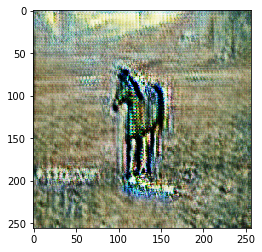

('Epoch 18/20...', 'Discriminator Loss: 0.4053...', 'Generator Loss: 4.7785')
Epoch: 18, Steps: 19020
('Epoch 18/20...', 'Discriminator Loss: 0.3202...', 'Generator Loss: 4.0733')
Epoch: 18, Steps: 19040
('Epoch 18/20...', 'Discriminator Loss: 0.4409...', 'Generator Loss: 3.4713')
Epoch: 18, Steps: 19060
('Epoch 18/20...', 'Discriminator Loss: 0.3238...', 'Generator Loss: 4.5694')
Epoch: 18, Steps: 19080
('Epoch 18/20...', 'Discriminator Loss: 0.2272...', 'Generator Loss: 4.1205')
Epoch: 18, Steps: 19100


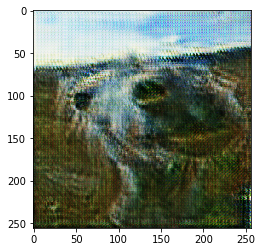

('Epoch 18/20...', 'Discriminator Loss: 0.3309...', 'Generator Loss: 3.9028')
Epoch: 18, Steps: 19120
('Epoch 18/20...', 'Discriminator Loss: 0.2069...', 'Generator Loss: 4.2167')
Epoch: 18, Steps: 19140
('Epoch 18/20...', 'Discriminator Loss: 0.4411...', 'Generator Loss: 4.4053')
Epoch: 18, Steps: 19160
('Epoch 18/20...', 'Discriminator Loss: 0.3156...', 'Generator Loss: 4.6993')
Epoch: 18, Steps: 19180
('Epoch 18/20...', 'Discriminator Loss: 0.3763...', 'Generator Loss: 4.0226')
Epoch: 18, Steps: 19200


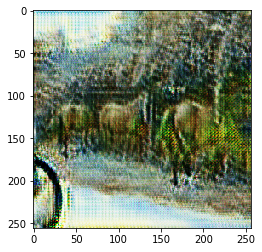

('Epoch 19/20...', 'Discriminator Loss: 0.3323...', 'Generator Loss: 5.0380')
Epoch: 19, Steps: 19220
('Epoch 19/20...', 'Discriminator Loss: 0.4634...', 'Generator Loss: 3.9375')
Epoch: 19, Steps: 19240
('Epoch 19/20...', 'Discriminator Loss: 0.4440...', 'Generator Loss: 5.3534')
Epoch: 19, Steps: 19260
('Epoch 19/20...', 'Discriminator Loss: 0.3404...', 'Generator Loss: 4.8282')
Epoch: 19, Steps: 19280
('Epoch 19/20...', 'Discriminator Loss: 0.2581...', 'Generator Loss: 4.5525')
Epoch: 19, Steps: 19300


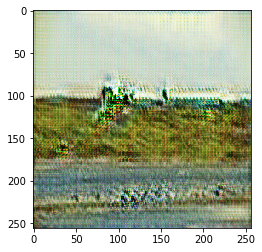

('Epoch 19/20...', 'Discriminator Loss: 0.4512...', 'Generator Loss: 3.9360')
Epoch: 19, Steps: 19320
('Epoch 19/20...', 'Discriminator Loss: 0.3471...', 'Generator Loss: 4.7797')
Epoch: 19, Steps: 19340
('Epoch 19/20...', 'Discriminator Loss: 0.2606...', 'Generator Loss: 4.0409')
Epoch: 19, Steps: 19360
('Epoch 19/20...', 'Discriminator Loss: 0.2945...', 'Generator Loss: 4.4867')
Epoch: 19, Steps: 19380
('Epoch 19/20...', 'Discriminator Loss: 0.5848...', 'Generator Loss: 3.9244')
Epoch: 19, Steps: 19400


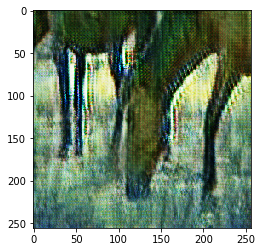

('Epoch 19/20...', 'Discriminator Loss: 0.3859...', 'Generator Loss: 5.8132')
Epoch: 19, Steps: 19420
('Epoch 19/20...', 'Discriminator Loss: 0.4708...', 'Generator Loss: 5.2979')
Epoch: 19, Steps: 19440
('Epoch 19/20...', 'Discriminator Loss: 0.4036...', 'Generator Loss: 3.4360')
Epoch: 19, Steps: 19460
('Epoch 19/20...', 'Discriminator Loss: 0.4322...', 'Generator Loss: 4.4496')
Epoch: 19, Steps: 19480
('Epoch 19/20...', 'Discriminator Loss: 0.3947...', 'Generator Loss: 3.8777')
Epoch: 19, Steps: 19500


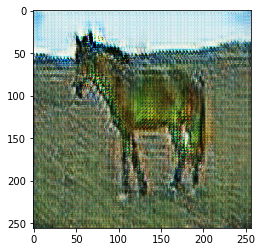

('Epoch 19/20...', 'Discriminator Loss: 0.4477...', 'Generator Loss: 3.9294')
Epoch: 19, Steps: 19520
('Epoch 19/20...', 'Discriminator Loss: 0.3360...', 'Generator Loss: 4.7498')
Epoch: 19, Steps: 19540
('Epoch 19/20...', 'Discriminator Loss: 0.5557...', 'Generator Loss: 4.5633')
Epoch: 19, Steps: 19560
('Epoch 19/20...', 'Discriminator Loss: 0.5725...', 'Generator Loss: 3.4096')
Epoch: 19, Steps: 19580
('Epoch 19/20...', 'Discriminator Loss: 0.4759...', 'Generator Loss: 4.2763')
Epoch: 19, Steps: 19600


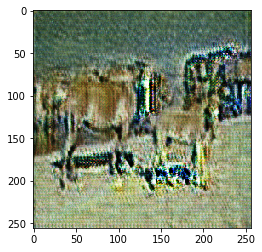

('Epoch 19/20...', 'Discriminator Loss: 0.4684...', 'Generator Loss: 4.0604')
Epoch: 19, Steps: 19620
('Epoch 19/20...', 'Discriminator Loss: 0.4001...', 'Generator Loss: 4.5151')
Epoch: 19, Steps: 19640
('Epoch 19/20...', 'Discriminator Loss: 0.4217...', 'Generator Loss: 4.4877')
Epoch: 19, Steps: 19660
('Epoch 19/20...', 'Discriminator Loss: 0.2779...', 'Generator Loss: 4.2614')
Epoch: 19, Steps: 19680
('Epoch 19/20...', 'Discriminator Loss: 0.3481...', 'Generator Loss: 4.2905')
Epoch: 19, Steps: 19700


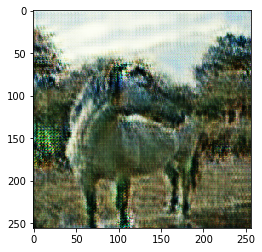

('Epoch 19/20...', 'Discriminator Loss: 0.3373...', 'Generator Loss: 4.7457')
Epoch: 19, Steps: 19720
('Epoch 19/20...', 'Discriminator Loss: 0.4270...', 'Generator Loss: 4.1382')
Epoch: 19, Steps: 19740
('Epoch 19/20...', 'Discriminator Loss: 0.2875...', 'Generator Loss: 7.1935')
Epoch: 19, Steps: 19760
('Epoch 19/20...', 'Discriminator Loss: 0.5134...', 'Generator Loss: 3.6706')
Epoch: 19, Steps: 19780
('Epoch 19/20...', 'Discriminator Loss: 0.5661...', 'Generator Loss: 5.0664')
Epoch: 19, Steps: 19800


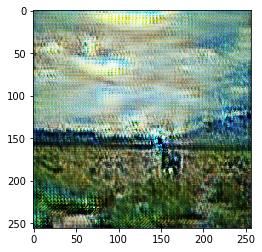

('Epoch 19/20...', 'Discriminator Loss: 0.4427...', 'Generator Loss: 4.5864')
Epoch: 19, Steps: 19820
('Epoch 19/20...', 'Discriminator Loss: 0.4564...', 'Generator Loss: 4.0751')
Epoch: 19, Steps: 19840
('Epoch 19/20...', 'Discriminator Loss: 0.5732...', 'Generator Loss: 3.8958')
Epoch: 19, Steps: 19860
('Epoch 19/20...', 'Discriminator Loss: 0.2780...', 'Generator Loss: 5.1704')
Epoch: 19, Steps: 19880
('Epoch 19/20...', 'Discriminator Loss: 0.3462...', 'Generator Loss: 4.7785')
Epoch: 19, Steps: 19900


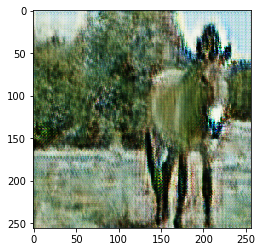

('Epoch 19/20...', 'Discriminator Loss: 0.4144...', 'Generator Loss: 4.6540')
Epoch: 19, Steps: 19920
('Epoch 19/20...', 'Discriminator Loss: 0.4234...', 'Generator Loss: 4.1322')
Epoch: 19, Steps: 19940
('Epoch 19/20...', 'Discriminator Loss: 0.4017...', 'Generator Loss: 3.9239')
Epoch: 19, Steps: 19960
('Epoch 19/20...', 'Discriminator Loss: 0.5298...', 'Generator Loss: 4.1125')
Epoch: 19, Steps: 19980
('Epoch 19/20...', 'Discriminator Loss: 0.4014...', 'Generator Loss: 4.6047')
Epoch: 19, Steps: 20000


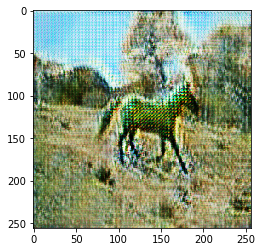

('Epoch 19/20...', 'Discriminator Loss: 0.3839...', 'Generator Loss: 4.7302')
Epoch: 19, Steps: 20020
('Epoch 19/20...', 'Discriminator Loss: 0.3468...', 'Generator Loss: 3.6667')
Epoch: 19, Steps: 20040
('Epoch 19/20...', 'Discriminator Loss: 0.2974...', 'Generator Loss: 4.8702')
Epoch: 19, Steps: 20060
('Epoch 19/20...', 'Discriminator Loss: 0.4761...', 'Generator Loss: 4.5639')
Epoch: 19, Steps: 20080
('Epoch 19/20...', 'Discriminator Loss: 0.3810...', 'Generator Loss: 2.8847')
Epoch: 19, Steps: 20100


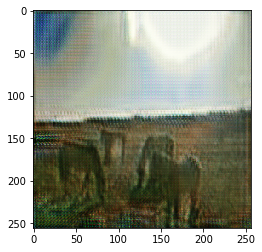

('Epoch 19/20...', 'Discriminator Loss: 0.3113...', 'Generator Loss: 3.9307')
Epoch: 19, Steps: 20120
('Epoch 19/20...', 'Discriminator Loss: 0.3664...', 'Generator Loss: 4.3271')
Epoch: 19, Steps: 20140
('Epoch 19/20...', 'Discriminator Loss: 0.4495...', 'Generator Loss: 4.7317')
Epoch: 19, Steps: 20160
('Epoch 19/20...', 'Discriminator Loss: 0.6533...', 'Generator Loss: 3.5899')
Epoch: 19, Steps: 20180
('Epoch 19/20...', 'Discriminator Loss: 0.2415...', 'Generator Loss: 4.2126')
Epoch: 19, Steps: 20200


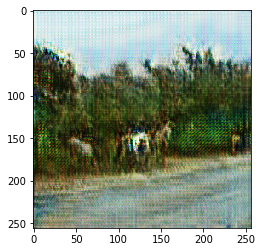

('Epoch 19/20...', 'Discriminator Loss: 0.4836...', 'Generator Loss: 3.5214')
Epoch: 19, Steps: 20220
('Epoch 19/20...', 'Discriminator Loss: 0.3370...', 'Generator Loss: 4.0678')
Epoch: 19, Steps: 20240
('Epoch 19/20...', 'Discriminator Loss: 0.3317...', 'Generator Loss: 4.3597')
Epoch: 19, Steps: 20260
('Epoch 20/20...', 'Discriminator Loss: 0.6150...', 'Generator Loss: 4.8743')
Epoch: 20, Steps: 20280
('Epoch 20/20...', 'Discriminator Loss: 0.4473...', 'Generator Loss: 4.9824')
Epoch: 20, Steps: 20300


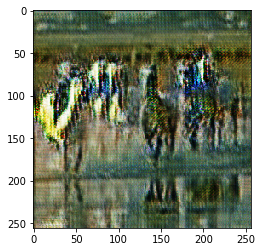

('Epoch 20/20...', 'Discriminator Loss: 0.5095...', 'Generator Loss: 5.0717')
Epoch: 20, Steps: 20320
('Epoch 20/20...', 'Discriminator Loss: 0.3488...', 'Generator Loss: 5.0602')
Epoch: 20, Steps: 20340
('Epoch 20/20...', 'Discriminator Loss: 0.5206...', 'Generator Loss: 3.8237')
Epoch: 20, Steps: 20360
('Epoch 20/20...', 'Discriminator Loss: 0.5077...', 'Generator Loss: 3.7909')
Epoch: 20, Steps: 20380
('Epoch 20/20...', 'Discriminator Loss: 0.4763...', 'Generator Loss: 4.5063')
Epoch: 20, Steps: 20400


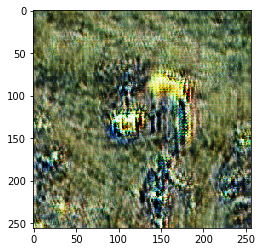

('Epoch 20/20...', 'Discriminator Loss: 0.3924...', 'Generator Loss: 4.3670')
Epoch: 20, Steps: 20420
('Epoch 20/20...', 'Discriminator Loss: 0.5416...', 'Generator Loss: 3.5091')
Epoch: 20, Steps: 20440
('Epoch 20/20...', 'Discriminator Loss: 0.3527...', 'Generator Loss: 4.0725')
Epoch: 20, Steps: 20460
('Epoch 20/20...', 'Discriminator Loss: 0.3031...', 'Generator Loss: 4.3818')
Epoch: 20, Steps: 20480
('Epoch 20/20...', 'Discriminator Loss: 0.3732...', 'Generator Loss: 4.0087')
Epoch: 20, Steps: 20500


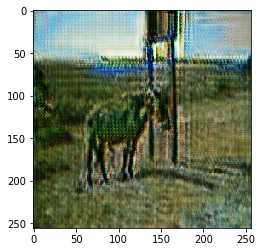

('Epoch 20/20...', 'Discriminator Loss: 0.2796...', 'Generator Loss: 4.7871')
Epoch: 20, Steps: 20520
('Epoch 20/20...', 'Discriminator Loss: 0.4871...', 'Generator Loss: 3.6702')
Epoch: 20, Steps: 20540
('Epoch 20/20...', 'Discriminator Loss: 0.4657...', 'Generator Loss: 3.8487')
Epoch: 20, Steps: 20560
('Epoch 20/20...', 'Discriminator Loss: 0.4028...', 'Generator Loss: 5.8588')
Epoch: 20, Steps: 20580
('Epoch 20/20...', 'Discriminator Loss: 0.3623...', 'Generator Loss: 6.0647')
Epoch: 20, Steps: 20600


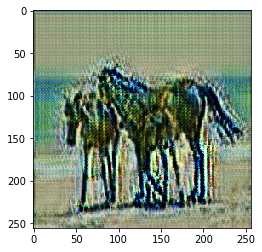

('Epoch 20/20...', 'Discriminator Loss: 0.3429...', 'Generator Loss: 4.2939')
Epoch: 20, Steps: 20620
('Epoch 20/20...', 'Discriminator Loss: 0.4783...', 'Generator Loss: 4.3924')
Epoch: 20, Steps: 20640
('Epoch 20/20...', 'Discriminator Loss: 0.3238...', 'Generator Loss: 5.1174')
Epoch: 20, Steps: 20660
('Epoch 20/20...', 'Discriminator Loss: 0.4058...', 'Generator Loss: 4.1502')
Epoch: 20, Steps: 20680
('Epoch 20/20...', 'Discriminator Loss: 0.5530...', 'Generator Loss: 4.1399')
Epoch: 20, Steps: 20700


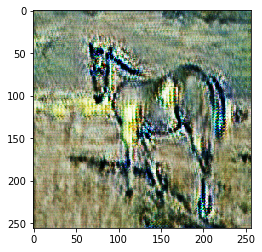

('Epoch 20/20...', 'Discriminator Loss: 0.3309...', 'Generator Loss: 4.0094')
Epoch: 20, Steps: 20720
('Epoch 20/20...', 'Discriminator Loss: 0.5763...', 'Generator Loss: 3.1210')
Epoch: 20, Steps: 20740
('Epoch 20/20...', 'Discriminator Loss: 0.4103...', 'Generator Loss: 4.3921')
Epoch: 20, Steps: 20760
('Epoch 20/20...', 'Discriminator Loss: 0.4514...', 'Generator Loss: 5.7776')
Epoch: 20, Steps: 20780
('Epoch 20/20...', 'Discriminator Loss: 0.4518...', 'Generator Loss: 5.3601')
Epoch: 20, Steps: 20800


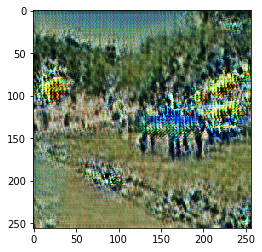

('Epoch 20/20...', 'Discriminator Loss: 0.3502...', 'Generator Loss: 3.6658')
Epoch: 20, Steps: 20820
('Epoch 20/20...', 'Discriminator Loss: 0.2556...', 'Generator Loss: 5.4431')
Epoch: 20, Steps: 20840
('Epoch 20/20...', 'Discriminator Loss: 0.3924...', 'Generator Loss: 4.6489')
Epoch: 20, Steps: 20860
('Epoch 20/20...', 'Discriminator Loss: 0.4767...', 'Generator Loss: 3.5768')
Epoch: 20, Steps: 20880
('Epoch 20/20...', 'Discriminator Loss: 0.3858...', 'Generator Loss: 4.8053')
Epoch: 20, Steps: 20900


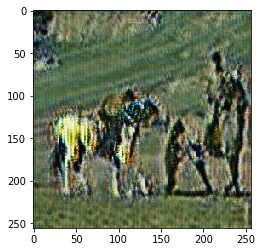

('Epoch 20/20...', 'Discriminator Loss: 0.2577...', 'Generator Loss: 4.1816')
Epoch: 20, Steps: 20920
('Epoch 20/20...', 'Discriminator Loss: 0.3755...', 'Generator Loss: 3.5767')
Epoch: 20, Steps: 20940
('Epoch 20/20...', 'Discriminator Loss: 0.4149...', 'Generator Loss: 5.6882')
Epoch: 20, Steps: 20960
('Epoch 20/20...', 'Discriminator Loss: 0.4376...', 'Generator Loss: 3.5782')
Epoch: 20, Steps: 20980
('Epoch 20/20...', 'Discriminator Loss: 0.3289...', 'Generator Loss: 4.6304')
Epoch: 20, Steps: 21000


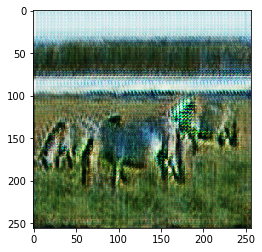

('Epoch 20/20...', 'Discriminator Loss: 0.3265...', 'Generator Loss: 3.7033')
Epoch: 20, Steps: 21020
('Epoch 20/20...', 'Discriminator Loss: 0.3939...', 'Generator Loss: 4.1952')
Epoch: 20, Steps: 21040
('Epoch 20/20...', 'Discriminator Loss: 0.5116...', 'Generator Loss: 4.4177')
Epoch: 20, Steps: 21060
('Epoch 20/20...', 'Discriminator Loss: 0.4682...', 'Generator Loss: 4.3281')
Epoch: 20, Steps: 21080
('Epoch 20/20...', 'Discriminator Loss: 0.3909...', 'Generator Loss: 4.2664')
Epoch: 20, Steps: 21100


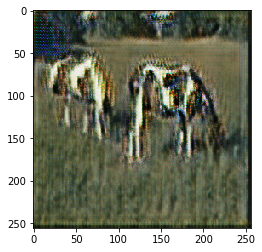

('Epoch 20/20...', 'Discriminator Loss: 0.2194...', 'Generator Loss: 4.6965')
Epoch: 20, Steps: 21120
('Epoch 20/20...', 'Discriminator Loss: 0.4807...', 'Generator Loss: 4.2727')
Epoch: 20, Steps: 21140
('Epoch 20/20...', 'Discriminator Loss: 0.3374...', 'Generator Loss: 4.1382')
Epoch: 20, Steps: 21160
('Epoch 20/20...', 'Discriminator Loss: 0.3490...', 'Generator Loss: 4.9963')
Epoch: 20, Steps: 21180
('Epoch 20/20...', 'Discriminator Loss: 0.5688...', 'Generator Loss: 4.2584')
Epoch: 20, Steps: 21200


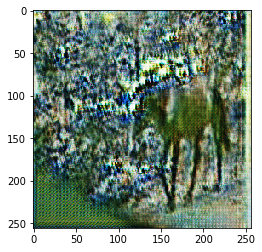

('Epoch 20/20...', 'Discriminator Loss: 0.5365...', 'Generator Loss: 4.4604')
Epoch: 20, Steps: 21220
('Epoch 20/20...', 'Discriminator Loss: 0.3342...', 'Generator Loss: 5.1056')
Epoch: 20, Steps: 21240
('Epoch 20/20...', 'Discriminator Loss: 0.4588...', 'Generator Loss: 4.3150')
Epoch: 20, Steps: 21260
('Epoch 20/20...', 'Discriminator Loss: 0.5647...', 'Generator Loss: 3.7608')
Epoch: 20, Steps: 21280
('Epoch 20/20...', 'Discriminator Loss: 0.3894...', 'Generator Loss: 5.3805')
Epoch: 20, Steps: 21300


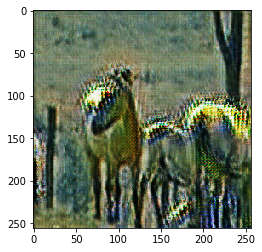

('Epoch 20/20...', 'Discriminator Loss: 0.3495...', 'Generator Loss: 4.6251')
Epoch: 20, Steps: 21320
('Epoch 20/20...', 'Discriminator Loss: 0.3963...', 'Generator Loss: 3.6372')
Epoch: 20, Steps: 21340


In [15]:
batch_size = 1
learning_rate = 0.0002
beta1 = 0.5

epochs = 20

horses_dataset = helper.Dataset(glob(os.path.join(data_dir, 'horse2zebra/trainA/*.jpg')),
                                img_w, img_h, img_channels)
zebras_dataset = helper.Dataset(glob(os.path.join(data_dir, 'horse2zebra/trainB/*.jpg')),
                                img_w, img_h, img_channels)

with tf.Graph().as_default():
    train(epochs, batch_size, learning_rate, beta1,
          horses_dataset.get_batches, zebras_dataset.get_batches,
          horses_dataset.shape, horses_dataset.image_mode)